### Benchmark Cell2Location on 5-cell-type Breast Cancer Visium dataset

**Update** 

- Benchmark with the simulated sample with spatial dependencies
- Benchmark simulation with scRNA-seq reference of different sample (CID4465)
- Benchmark

In [2]:
import os
import sys

import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns

import cell2location
#import scvi

from scipy.io import mmread
from scipy.stats import pearsonr, ttest_ind, mannwhitneyu, gaussian_kde
from sklearn.metrics import r2_score
from sklearn.decomposition import PCA

In [3]:
from starfysh import starfysh, utils, plot_utils
from starfysh.AA import ArchetypalAnalysis

In [4]:
import matplotlib.font_manager
from matplotlib import rcParams

# set plotting font style as San-serifs (NBT requirement)

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'
rcParams['font.family'] = plot_font


### (I). Simulation.

#### Load paired visium & scRNA-seq reference data

Load visium:

In [190]:
#map_info = utils.preprocess_img(
#    data_path,
#    sample_id,
#    adata_sample.obs.index,
#    hchannal=False
#)


data_path = '../../starfysh/data/'
sample_id = 'CID44971_TNBC'
adata_sample, _ = utils.load_adata(data_path, sample_id, n_genes=20000)

[2022-11-20 10:07:12] Preprocessing1: delete the mt and rp
[2022-11-20 10:07:12] Preprocessing2: Normalize
[2022-11-20 10:07:12] Preprocessing3: Logarithm
[2022-11-20 10:07:12] Preprocessing4: Find the variable genes


In [5]:
# spatially independent
"""
data_path = '../simulation/data_stereo/'
sample_id = 'simu_5_siyu'
"""

# spatially dependent
data_path = '../simulation/data_spatial/'
sample_id = 'simu_5_he'

adata_sample, _ = utils.load_adata(data_path, sample_id, n_genes=2000)


[2022-11-15 16:39:47] Preprocessing1: delete the mt and rp
[2022-11-15 16:39:49] Preprocessing2: Normalize
[2022-11-15 16:39:49] Preprocessing3: Logarithm
[2022-11-15 16:39:49] Preprocessing4: Find the variable genes


Load deconvolution ground-truth:

In [6]:
member = pd.read_csv(os.path.join(data_path, sample_id, 'members.st_synth.csv'), index_col=0)
proportions = pd.read_csv(os.path.join(data_path, sample_id, 'proportions.st_synth.csv'), index_col=0)
proportions = proportions[sorted(proportions.columns)]
member = member[sorted(proportions.columns)]

cell_types = proportions.columns

Load paired scRNA-seq, select cell types which appears in the synthetic visium data:

In [195]:
exo_ref = False

if exo_ref:
    sc_path = '../../starfysh/data/CID4465_TNBC/scrna/'
else:
    sc_path = '../../starfysh/data/CID44971_TNBC/scrna/'

# Load annotation
meta_df = pd.read_csv(os.path.join(sc_path, 'metadata.csv'), index_col=[0], header=[0])
#meta_df['celltype_major'].replace('Cancer Epithelial', 'Cancer_Epithelial', inplace=True)
#meta_df['celltype_major'].replace('Normal Epithelial', 'Normal_Epithelial', inplace=True)
meta_df.head()

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,subtype,celltype_subset,celltype_minor,celltype_major
CID44971_AAGCCGCCACGCATCG,CID44971,3409,1492,9.416251,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial
CID44971_AAGGAGCTCAACACAC,CID44971,11133,3386,6.557083,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial
CID44971_ACGAGCCTCCGATATG,CID44971,2119,1021,9.815951,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial
CID44971_ACGTCAATCCGAAGAG,CID44971,2225,1100,8.089888,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial
CID44971_AGAGTGGCACACGCTG,CID44971,10826,3055,4.092001,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial


Map Wu et al annotatation to Starfysh & only subsample relevant cell types;

In [199]:
annot_starfysh_wu = {
    'Basal': 'Cancer Basal SC',
    'LumA': None,
    'LumB': 'Cancer LumB SC',
    'MBC': None,
    'CSC': None,
    'Normal epithelial': 'Myoepithelial',
    'Tcm': 'T_cells_c0_CD4+_CCR7',  # Central memory T-cell
    'Tem': 'T_cells_c1_CD4+_IL7R', # Effector memory T-cell
    'Tfh': 'T_cells_c3_CD4+_Tfh_CXCL13',
    'Treg': 'T_cells_c2_CD4+_T-regs_FOXP3', # regulatory T-cell
    'Activated CD8': ['T_cells_c7_CD8+_IFNG', 'T_cells_c8_CD8+_LAG3'],
    'Deletional tolerance CD8': None,
    'Dysfunc CD8': None,
    'Terminal exhaustion': None,
    'Precursor exhaustion': None,
    'NK': None,
    'B cells memory': 'B cells Memory',
    'B cells naive': 'B cells Naive',
    'Macrophage M1': 'Myeloid_c10_Macrophage_1_EGR1',
    'Macrophage M2': 'Myeloid_c9_Macrophage_2_CXCL10',
    'Plasmablasts': 'Plasmablasts',
    'MDSC': None,
    'Monocytes': 'Myeloid_c8_Monocyte_2_S100A9',
    'cDC': ['Myeloid_c11_cDC2_CD1C', 'Myeloid_c3_cDC1_CLEC9A'],
    'pDC': 'Myeloid_c4_DCs_pDC_IRF7',
    'CAFs MSC iCAF-like': ['CAFs myCAF like s4', 'CAFs myCAF like s5'],
    'CAFs myCAF-like': ['CAFs myCAF like s4', 'CAFs myCAF like s5'],
    'PVL differentiated': 'PVL Differentiated s3',  
    'PVL immature': ['PVL Immature s1', 'PVL_Immature s2'],
    'Endothelial': ['Endothelial ACKR1', 'Endothelial CXCL12', 'Endothelial Lymphatic LYVE1', 'Endothelial RGS5'],
}

annot_wu_starfysh = {}

for k, v in annot_starfysh_wu.items():
    if v is not None:
        if isinstance(v, list):
            for v_ in v:
                annot_wu_starfysh[v_] = k
        else:
            annot_wu_starfysh[v] = k
            

In [233]:
use_sim = False

if use_sim:
    # TODO: implement the simulation benchmark
    # cell_types = ...
    pass
else:
    cell_types_wu = meta_df['celltype_subset']
    cell_types_raw = []

    for cell_type in cell_types_wu:
        if cell_type in annot_wu_starfysh.keys():
            cell_types_raw.append(annot_wu_starfysh[cell_type])
        else:
            cell_types_raw.append(None)

    sample_indices = [
        i for i in range(len(cell_types_raw))
        if cell_types_raw[i] is not None
    ]

    cell_types = [
        ct for ct in cell_types_raw
        if ct is not None
    ]

In [208]:
# Load count matrix
barcode_df = pd.read_csv(
    os.path.join(sc_path, 'count_matrix_barcodes.tsv'), 
    delimiter='\t',
    header=None # this file doesn't contain the true "header" (column info), the first row is a TRUE barcode
)

gene_df = pd.read_csv(
    os.path.join(sc_path, 'count_matrix_genes.tsv'),
    delimiter='\t',
    header=None # this file doesn't contain the true "header" (column info), the first row is a TRUE gene
)

cnt = mmread(
    os.path.join(sc_path, 'count_matrix_sparse.mtx')
)
    
barcodes = pd.DataFrame(barcode_df[0].values, index=barcode_df[0].values, columns=['Barcode'])
genes = pd.DataFrame(gene_df[0].values, index=gene_df[0].values, columns=['features'])

adata_ref = sc.AnnData(
    X=cnt.T.A[sample_indices],
    obs=barcodes.iloc[sample_indices],
    var=genes
)

# Annotate cell types
adata_ref.obs['Cell_type'] = cell_types

**Find reference cell-type signatures (NB regression)**

Filter low-quality genes:

In [209]:
from cell2location.utils.filtering import filter_genes
from cell2location.models import RegressionModel       

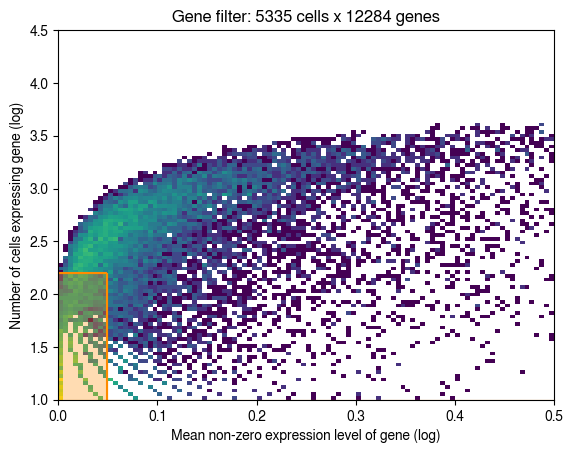

In [210]:
selected = filter_genes(adata_ref, cell_count_cutoff=5, cell_percentage_cutoff2=0.03, nonz_mean_cutoff=1.12)

# filter the object
adata_ref = adata_ref[:, selected].copy()

In [211]:
# prepare anndata for the regression model
cell2location.models.RegressionModel.setup_anndata(
    adata=adata_ref,
    labels_key='Cell_type'
)

# view anndata_setup as a sanity check
mod = RegressionModel(adata_ref)
mod.view_anndata_setup()

[2022-11-20 10:26:19] Unable to initialize backend 'tpu_driver': NOT_FOUND: Unable to find driver in registry given worker: 
[2022-11-20 10:26:19] Unable to initialize backend 'gpu': NOT_FOUND: Could not find registered platform with name: "cuda". Available platform names are: Host Interpreter
[2022-11-20 10:26:19] Unable to initialize backend 'tpu': INVALID_ARGUMENT: TpuPlatform is not available.


Anndata setup with scvi-tools version 0.16.0.

Setup via `RegressionModel.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': None,
│   'labels_key': 'Cell_type',
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 5335  │
│          n_vars          │ 12284 │
│         n_batch          │   1   │
│         n_labels         │  20   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                     batch State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃     Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_batch'] │     0      │          0          │
└──────────────────────────┴────────────┴─────────────────────┘

                        labels State Registry                        
┏━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃    Source Location     ┃     Categories     ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['Cell_type'] │   Activated CD8    │          0          │
│                        │   B cells memory   │          1          │
│                        │   B cells naive    │          2          │
│                        │       Basal        │          3          │
│                        │  CAFs myCAF-like   │          4          │
│                        │    Endothelial     │          5          │
│                        │        LumB        │          6          │
│                        │   Macrophage M1    │          7          │
│                        │   Macrophage M2    │          8          │
│                        │     Monocytes      │          9          │
│                        │ Normal epithelial  │         10          │
│                        │ PVL differentiated │         11          │
│                        │    PVL immature    │         12          │
│                        │    Plasmablasts    │         13          │
│                        │        Tcm         │         14          │
│                        │        Tem         │         15          │
│                        │        Tfh         │         16          │
│                        │        Treg        │         17          │
│                        │        cDC         │         18          │
│                        │        pDC         │         19          │
└────────────────────────┴────────────────────┴─────────────────────┘

Model training:

In [213]:
t0_cell2loc_ref = time.perf_counter()
mod.train(max_epochs=2000, use_gpu=True)
t1_cell2loc_ref = time.perf_counter()



[2022-11-20 10:28:26] Created a temporary directory at /tmp/tmpcbtv7ohu
[2022-11-20 10:28:26] Writing /tmp/tmpcbtv7ohu/_remote_module_non_sriptable.py
[2022-11-20 10:28:26] GPU available: True, used: True
[2022-11-20 10:28:26] TPU available: False, using: 0 TPU cores
[2022-11-20 10:28:26] IPU available: False, using: 0 IPUs
[2022-11-20 10:28:26] LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 2000/2000: 100%|███████████████████████████████████████████████████████████████████████████████| 2000/2000 [07:50<00:00,  4.25it/s, v_num=1, elbo_train=2.72e+7]


In [217]:
ref_time_cell2loc = t1_cell2loc_ref - t0_cell2loc_ref

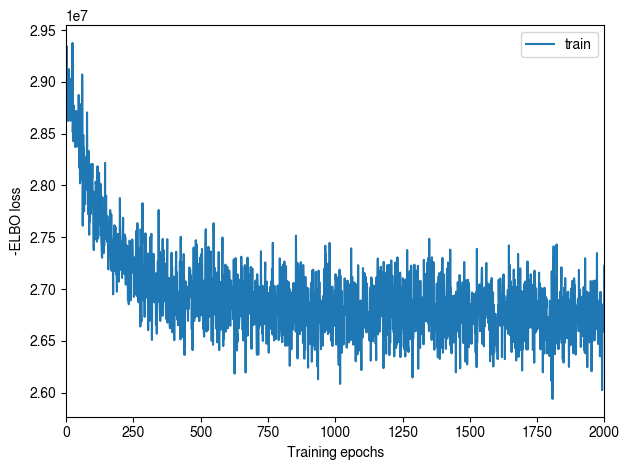

In [218]:
mod.plot_history()

Export the estimated cell abundance (summarizing posterior distribution):

In [219]:
adata_ref = mod.export_posterior(
    adata_ref, sample_kwargs={'num_samples': 1000, 'batch_size': 2500, 'use_gpu': True}
)


Sampling global variables, sample: 100%|███████████████████████████████████████████████████████████████████████████████████████████| 999/999 [00:09<00:00, 106.22it/s]


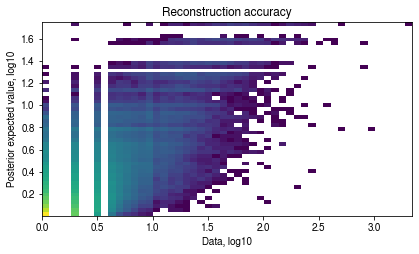

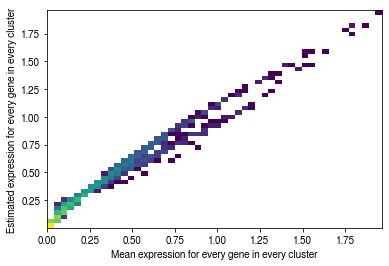

In [13]:
mod.plot_QC()

Extract reference cell-type signatures:

In [220]:
if 'means_per_cluster_mu_fg' in adata_ref.varm.keys():
    inf_aver = adata_ref.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}'
                                    for i in adata_ref.uns['mod']['factor_names']]].copy()
else:
    inf_aver = adata_ref.var[[f'means_per_cluster_mu_fg_{i}'
                                    for i in adata_ref.uns['mod']['factor_names']]].copy()
inf_aver.columns = adata_ref.uns['mod']['factor_names']
inf_aver.iloc[0:5, 0:5]

,Activated CD8,B cells memory,B cells naive,Basal,CAFs myCAF-like
FO538757.2,0.064464,0.054584,0.075514,0.406143,0.139420
NOC2L,0.166394,0.220144,0.228958,1.956090,0.306084
HES4,0.005154,0.004643,0.026365,3.530938,1.133122
ISG15,0.798820,0.831002,0.231581,0.761933,3.147873
AGRN,0.006661,0.004859,0.013994,0.224264,0.149413


**Spatial Mapping**

In [223]:
# find shared genes and subset both anndata and reference signatures
intersect = np.intersect1d(adata_sample.var_names, inf_aver.index)
adata_sample = adata_sample[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()


In [226]:
# prepare anndata for cell2location model
cell2location.models.Cell2location.setup_anndata(adata=adata_sample)


Training:<br>
2 important parameters:
- `N_cells_per_location`: set as 10 for new protocal Visium
- `detection_alpha`: Hyperparameter to deal with technical variability. Set higher if more consistency between library size (count matrix) & histology intensity per location, vice versa. (Default: 200)

In [227]:
mod = cell2location.models.Cell2location(
    adata_sample,
    cell_state_df=inf_aver,
    N_cells_per_location=30,
    detection_alpha=20
)

mod.view_anndata_setup()

Anndata setup with scvi-tools version 0.16.0.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': None,
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 1162  │
│          n_vars          │ 11350 │
│         n_batch          │   1   │
│         n_labels         │   1   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                     batch State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃     Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_batch'] │     0      │          0          │
└──────────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

`Cell2location`'s default 30,000 epoch is too much (the ELBO loss is damping), reduce to 10,000)

[2022-11-20 17:05:23] GPU available: True, used: True
[2022-11-20 17:05:23] TPU available: False, using: 0 TPU cores
[2022-11-20 17:05:23] IPU available: False, using: 0 IPUs
[2022-11-20 17:05:23] LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 8000/8000: 100%|███████████████████████████████████████████████████████████████████████████████| 8000/8000 [09:57<00:00, 13.39it/s, v_num=1, elbo_train=9.91e+6]


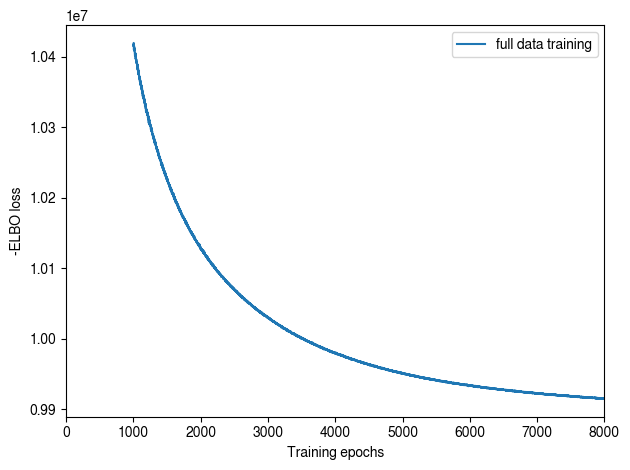

In [228]:
t0_cell2loc_inf = time.perf_counter()
mod.train(
    max_epochs=8000,
    batch_size=None,
    train_size=1,
    use_gpu=True
)
t1_cell2loc_inf = time.perf_counter()

mod.plot_history(1000)
plt.legend(labels=['full data training'])

Export posterior distributions of cell abundance as deconvolution predictions:

In [229]:
t1_cell2loc_inf - t0_cell2loc_inf

597.7214174440014

In [230]:
adata_sample = mod.export_posterior(
    adata_sample,
    sample_kwargs={'num_samples': 1000, 'batch_size': mod.adata.n_obs, 'use_gpu': True}
)

Sampling global variables, sample: 100%|████████████████████████████████████████████████████████████████████████████████████████████| 999/999 [00:13<00:00, 72.91it/s]


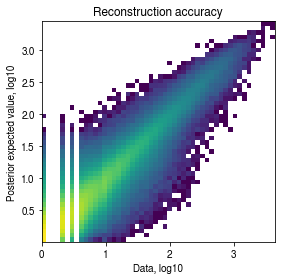

In [20]:
mod.plot_QC()

`Cell2location` deconvolution $w_{s,f}$ - absolute cell abundance<br>
(**Note**, from supplementary, use $5\%$ quantile instead of posterior mean to represent cell abundance estimate)

Get absolute cell abundance & relative cell abundance by normalizing each spot `s`: $\hat{w}_{sf} = \dfrac{w_{sf}}{\sum_f w_{sf}}$:

In [ ]:
cell2loc_prop_df

In [234]:
member_pred = adata_sample.obsm['q05_cell_abundance_w_sf'].copy()
member_pred.columns = [col.split('w_sf_')[-1] for col in member_pred.columns]

# Reorder column to match ground-truth
if use_sim:
    member_pred = member_pred[member.columns]
cell2loc_prop_df = member_pred.div(member_pred.sum(1), axis=0)
adata_sample.obsm['pred_proportions'] = cell2loc_prop_df

In [237]:
cell2loc_prop_df.shape

(1162, 20)

Cell2Location inference running time:

In [254]:
cell2loc_runtime = (t1_cell2loc_ref - t0_cell2loc_ref) + (t1_cell2loc_inf - t0_cell2loc_inf)
cell2loc_runtime / 60

17.831081015449794

**Benchmarking accuracy**

In [125]:
import seaborn as sns
from scipy.stats import linregress, pearsonr, gaussian_kde

In [126]:
from sklearn.metrics import r2_score
from scipy.stats import pearsonr, gaussian_kde

def disp_corr(y_true, y_pred,
              outdir=None,
              fontsize=10,
              filename=None,
              savefig=False,
              format='png'):
    """
    Calculate & plot correlation of cell proportion (or absolute cell abundance)
    between ground-truth & predictions (both [S x F])
    """

    assert y_true.shape == y_pred.shape, 'Inconsistent dimension between ground-truth & prediction'
    if savefig:
        assert format == 'png' or format == 'eps' or format == 'svg', "Invalid saving format"

    v1 = y_true.values
    v2 = y_pred.values

    n_factors = v1.shape[1]
    corr = np.zeros((n_factors, n_factors))

    for i in range(n_factors):
        for j in range(n_factors):
            corr[i, j], _ = np.round(pearsonr(v1[:, i], v2[:, j]), 3)

    fig, ax = plt.subplots(1, 1, figsize=(3.2, 3.2), dpi=300)
    ax = sns.heatmap(corr, annot=True,
                     cmap='RdBu_r', vmin=-1, vmax=1,
                     annot_kws={"fontsize": fontsize},
                     cbar_kws={'label': 'Cell type proportion corr.'},
                     ax=ax
                    )

    ax.set_xticks(np.arange(n_factors)+0.5)
    ax.set_yticks(np.arange(n_factors)+0.5)
    ax.set_xticklabels(y_pred.columns, rotation=90)
    ax.set_yticklabels(y_true.columns, rotation=0)
    ax.set_xlabel('Estimated proportion')
    ax.set_ylabel('Ground truth proportion')

    for item in (ax.get_xticklabels() + ax.get_yticklabels()):
        item.set_fontsize(12)

    if savefig and (outdir is not None and filename is not None):
        if not os.path.exists(outdir):
            os.makedirs(outdir)
        fig.savefig(os.path.join(outdir, filename+'.'+format), bbox_inches='tight', format=format)

    plt.show()


def disp_prop_scatter(y_true, y_pred, outdir=None, filename=None, savefig=False, format='png'):
    """
    Scatter plot of spot-wise proportion between ground-truth & predictions
    """

    assert y_true.shape == y_pred.shape, 'Inconsistent dimension between ground-truth & prediction'
    if savefig:
        assert format == 'png' or format == 'eps' or format == 'svg', "Invalid saving format"

    n_factors = y_true.shape[1]
    y_true_vals = y_true.values
    y_pred_vals = y_pred.values

    fig, axes = plt.subplots(1, n_factors, figsize=(2 * n_factors, 2.2), dpi=300)

    for i, ax in enumerate(axes):
        v1 = y_true_vals[:, i]
        v2 = y_pred_vals[:, i]
        v_stacked = np.vstack([v1, v2])
        r2 = r2_score(v1, v2)
        den = gaussian_kde(v_stacked)(v_stacked)

        ax.scatter(v1, v2, c=den, s=1, cmap='turbo', vmax=den.max() / 3)

        ax.set_aspect('equal')
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.axis('equal')

        # Only show ticks on the left and bottom spines
        ax.yaxis.set_ticks_position('left')
        ax.xaxis.set_ticks_position('bottom')

        ax.set_title(y_pred.columns[i])
        if i == 0 or i == 1 or i == 2 or i == 4:
            ax.annotate(r"$R^2$ = {:.3f}".format(r2), (0, 1), fontsize=8)
        else:
            ax.annotate(r"$R^2$ = {:.3f}".format(r2), (0.1, 0.9), fontsize=8)

        ax.set_xlim([-0.1, 1.1])
        ax.set_ylim([-0.1, 1.1])
        ax.set_xticks(np.arange(0, 1.1, 0.5))
        ax.set_yticks(np.arange(0, 1.1, 0.5))

        ax.set_xlabel('Ground truth proportions')
        ax.set_ylabel('Predicted proportions')

    plt.tight_layout()

Save deconvolution results to output:

In [ ]:
#out_path = '../../plot_files/'
#disp_corr(proportions, prop_pred, 
          #outdir=out_path, 
          #name='cell2loc_corr',
          #savefig=True
#         )

Visualization:

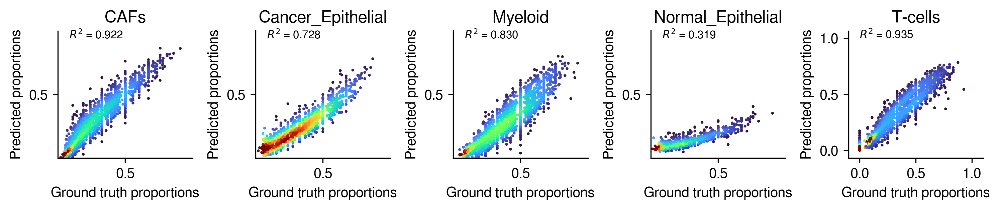

In [67]:
if use_sim:
    disp_prop_scatter(proportions, cell2loc_prop_df, 
                      #outdir=out_path, 
                      #name='cell2loc_scatter',
                      #savefig=True
                     )

Spatial distribution:

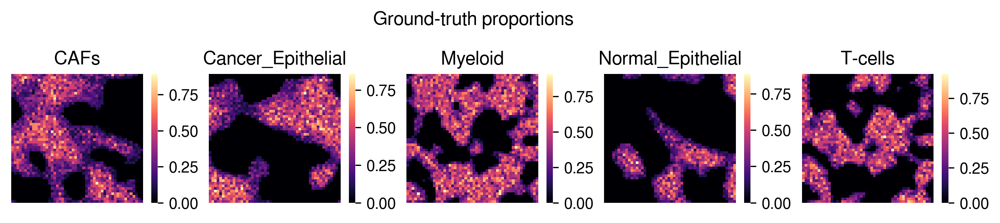

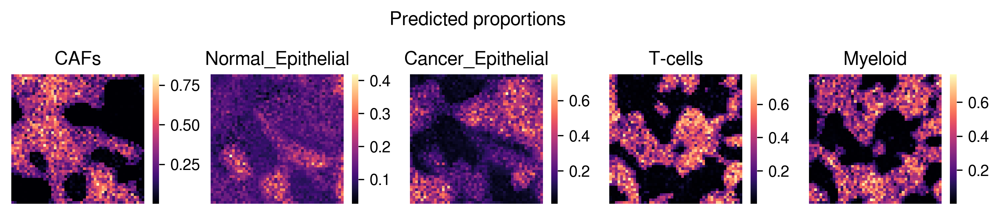

In [28]:
if use_sim:
    disp_spatial(proportions, title='Ground-truth proportions')
    disp_spatial(cell2loc_prop_df, title='Predicted proportions')

### III. Plotting of deconvolution results of other methods

In [5]:
import itertools
from scipy.stats import pearsonr

#### `CARD` & `STDeconvolve`

In [120]:
# Ground-truth#
proportions = pd.read_csv('../data/simu_defined/proportions.st_synth.csv', index_col=[0])
proportions.head()

,Activated CD8,B cells memory,Basal,CAFs MSC iCAF-like,CAFs myCAF-like,Endothelial,Macrophage M2,PVL immature,Tcm,pDC
exper0_location_0,0.000000,0.000000,0.400000,0.0,0.200000,0.200000,0.0,0.0,0.2,0.0
exper0_location_1,0.000000,0.000000,0.400000,0.0,0.200000,0.200000,0.0,0.0,0.2,0.0
exper0_location_2,0.000000,0.200000,0.400000,0.0,0.200000,0.200000,0.0,0.0,0.0,0.0
exper0_location_3,0.166667,0.166667,0.333333,0.0,0.166667,0.166667,0.0,0.0,0.0,0.0
exper0_location_4,0.200000,0.000000,0.400000,0.0,0.200000,0.200000,0.0,0.0,0.0,0.0


In [10]:
proportions_card = pd.read_csv('results/CARD_proportion.csv', index_col=[0])
proportions_card.head()

,CT1,CT2,CT3,CT4,CT5
location_0,0.234141,0.053692,0.451789,0.260378,3.090677e-08
location_1,0.468196,0.037942,0.154445,0.214339,1.250779e-01
location_2,0.547141,0.294821,0.055042,0.102996,2.233338e-11
location_3,0.478568,0.361895,0.000513,0.159023,2.563638e-18
location_4,0.503584,0.469133,0.000019,0.027264,9.650282e-17


In [121]:
proportions_stdeconv = pd.read_csv('results/STDeconvolve_proportion.csv', index_col=[0])
proportions_stdeconv.head()

,1,2,3,4,5,6,7,8,9,10
exper0_location_0,0.000464,0.000464,0.000464,0.000464,0.236747,0.475570,0.284437,0.000464,0.000464,0.000464
exper0_location_1,0.000102,0.025724,0.000102,0.000102,0.052384,0.411586,0.000102,0.338143,0.000102,0.171652
exper0_location_2,0.000500,0.385258,0.000501,0.000500,0.000500,0.228028,0.050596,0.000500,0.078150,0.255466
exper0_location_3,0.056172,0.028633,0.016152,0.057041,0.083082,0.509746,0.054753,0.089196,0.000203,0.105023
exper0_location_4,0.006473,0.014463,0.000040,0.013988,0.160221,0.367169,0.112179,0.174074,0.008414,0.142978


In [122]:
def calc_colcorr(true_df, pred_df):
    """Calculate per-column correlations between 2 dataframes"""
    assert len(true_df.columns) == len(pred_df.columns), "Dataframes need to be the same to calculate per-col correlations"
    df1, df2 = true_df.copy(), pred_df.copy()
    df1.columns, df2.columns = np.arange(df1.shape[1]), np.arange(df2.shape[1])
    corr = df1.corrwith(df2, axis=0).mean()
    return corr

def calc_elemcorr(y_true, y_pred):
    assert y_true.shape[1] == y_pred.shape[1], "proprotion matrices need to be the same to calculate elementary-wise correlations"
    ncol = y_true.shape[1]
    xx, yy = np.meshgrid(np.arange(ncol), np.arange(ncol), indexing='ij')
    xx, yy = xx.flatten(), yy.flatten()

    get_corr = lambda i, j: pearsonr(y_true[:, i], y_pred[:, j])[0]
    corr = np.asarray([
        get_corr(i, j) for (i, j) in zip(xx, yy)
    ]).reshape(ncol, -1)

    return corr

def get_best_permute(true_df, pred_df):
    """
    Calculate the best permutation to align reference-free method `factors` to ground-truth cell typess
    """
    """
    nfactors = df.shape[1]
    best_score = -np.inf  # best overall per-column correlations so far
    best_permutation = None
    for col in itertools.permutations(df.columns, nfactors):
        prop_permuted = df[list(col)]
        score = calc_colcorr(prop, prop_permuted).mean()
        if score > best_score:
            best_score = score
            best_permutation = col
            print(best_score, best_permutation)
    """
    # compute elem-wise correlations, fix the unique argmax
    y_true, y_pred = true_df.values, pred_df.values
    nfactors = y_true.shape[1]
    corr = calc_elemcorr(y_true, y_pred)
    align = corr.argmax(1).astype(np.int8)

    # save searching space, fix the best-mapped factors to cell types
    uniq_idxs = [
        i for i, v in enumerate(align)
        if len(np.where(align == v)[0]) == 1
    ]
    perm_idxs = np.setdiff1d(np.arange(nfactors), uniq_idxs).astype(np.int8)
    perm_vals = np.setdiff1d(np.arange(nfactors), align[uniq_idxs]).astype(np.int8)


    best_score = -np.inf
    best_perm = None
    curr_perm = np.zeros(nfactors, dtype=np.int8)
    curr_perm[uniq_idxs] = align[uniq_idxs]

    for perm in itertools.permutations(perm_vals, len(perm_vals)):
        curr_perm[perm_idxs] = perm
        col_perm = pred_df.columns[curr_perm]
        score = calc_colcorr(true_df, pred_df[col_perm])
        if score > best_score:
            best_score = score
            best_perm = col_perm

    pred_perm_df = pred_df[list(best_perm)]
    return pred_perm_df


In [ ]:
proportions_stdeconv = get_best_permute(proportions, proportions_stdeconv)

In [19]:
# CARD
best_score = -np.inf
best_permutation = None
for col in itertools.permutations(proportions_card.columns, 10):
    prop_permuted = proportions_card[list(col)]
    score = calc_score(proportions, prop_permuted)
    if score > best_score:
        best_score = score
        best_permutation = col
proportions_card = proportions_card[list(best_permutation)]

In [10]:
# BayesPrism
proportions_bp = pd.read_csv('results/Bayesprism_proportion.csv', index_col=[0])
proportions_bp = proportions_bp[sorted(proportions_bp.columns)]


In [ ]:
proportions_stdeconv.columns

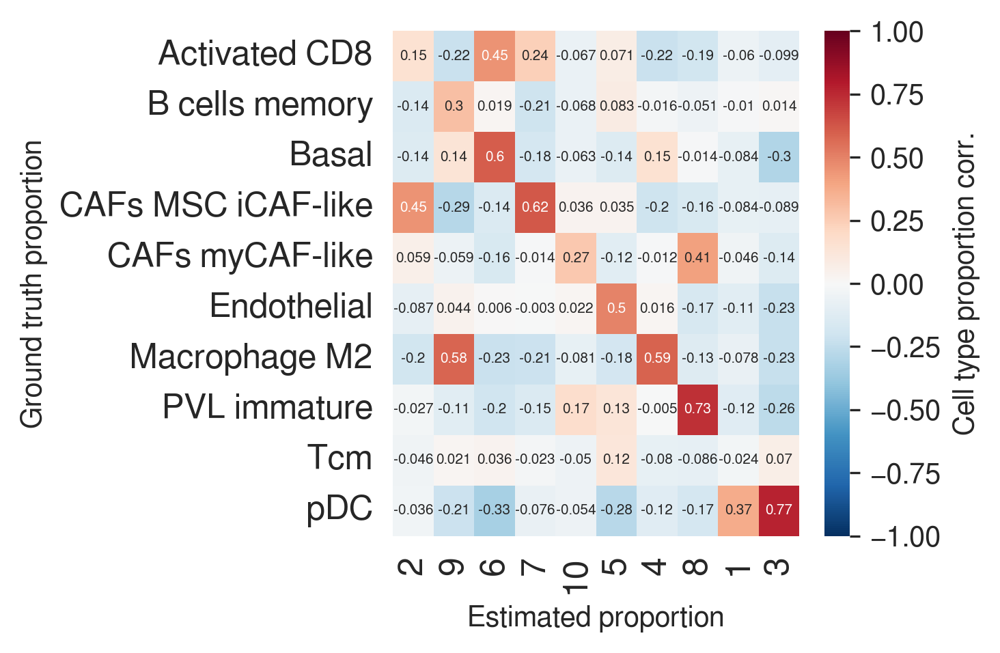

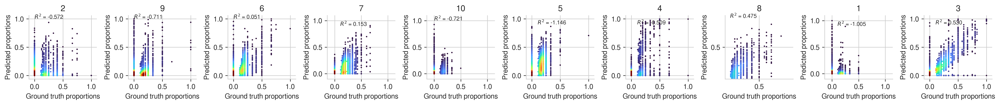

In [127]:
# STDeconvolve
#out_path = '../../plot_files/'
disp_corr(proportions, proportions_stdeconv, 
          #outdir=out_path,
          #filename='stdeconv_corr',
          fontsize=5,
          savefig=True)

disp_prop_scatter(proportions, proportions_stdeconv,
                  #outdir=out_path,
                  #name='stdeconv_scatter',
                  #savefig=True
                 )

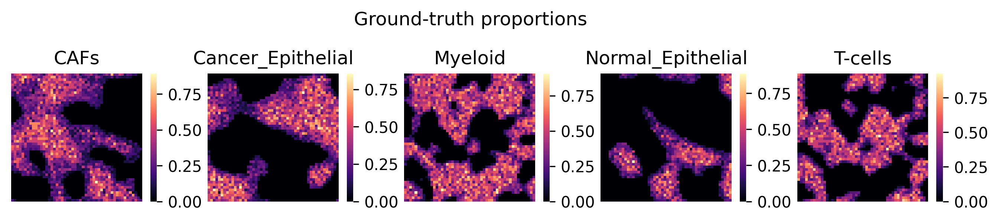

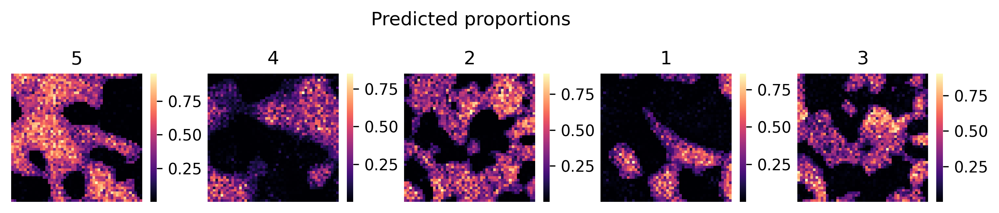

In [15]:
disp_spatial(proportions, title='Ground-truth proportions')
disp_spatial(proportions_stdeconv, title='Predicted proportions')

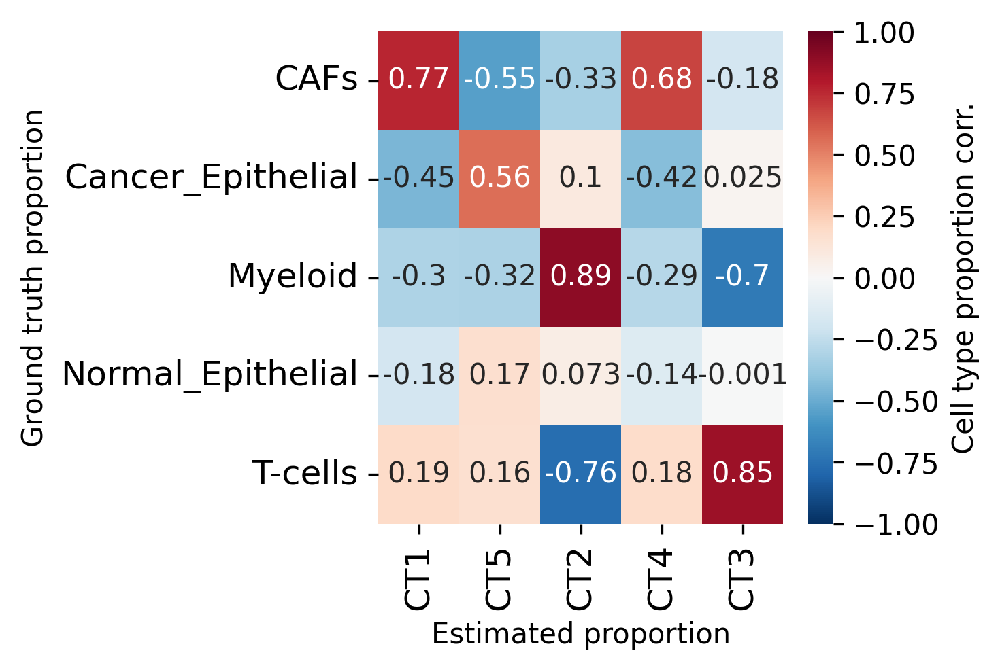

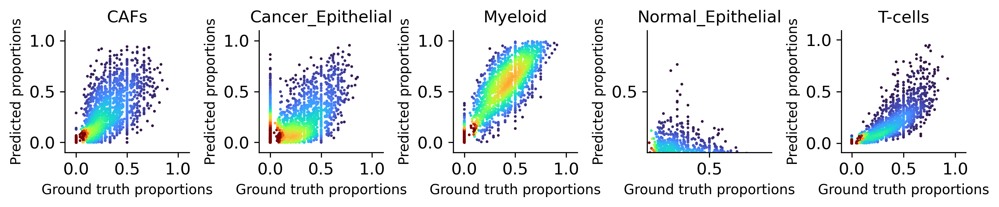

In [20]:
# CARD ref-free
out_path = '../../plot_files/'
disp_corr(proportions, proportions_card, 
          outdir=out_path, 
          filename='card_corr',
          savefig=True)

disp_prop_scatter(proportions, proportions_card,
                  outdir=out_path,
                  filename='card_scatter',
                  savefig=True
                 )

In [ ]:
# Debug: reconstruct starfysh annotation for BayesPrism & Cell2Location from Wu et al.

In [30]:
annot_starfysh_wu = {
    'Basal': 'Cancer Basal SC',
    'LumA': None,
    'LumB': 'Cancer LumB SC',
    'MBC': None,
    'CSC': None,
    'Normal epithelial': 'Myoepithelial',
    'Tcm': 'T_cells_c0_CD4+_CCR7',  # Central memory T-cell
    'Tem': 'T_cells_c1_CD4+_IL7R', # Effector memory T-cell
    'Tfh': 'T_cells_c3_CD4+_Tfh_CXCL13',
    'Treg': 'T_cells_c2_CD4+_T-regs_FOXP3', # regulatory T-cell
    'Activated CD8': ['T_cells_c7_CD8+_IFNG', 'T_cells_c8_CD8+_LAG3'],
    'Deletional tolerance CD8': None,
    'Dysfunc CD8': None,
    'Terminal exhaustion': None,
    'Precursor exhaustion': None,
    'NK': None,
    'B cells memory': 'B cells Memory',
    'B cells naive': 'B cells Naive',
    'Macrophage M1': 'Myeloid_c10_Macrophage_1_EGR1',
    'Macrophage M2': 'Myeloid_c9_Macrophage_2_CXCL10',
    'Plasmablasts': 'Plasmablasts',
    'MDSC': None,
    'Monocytes': 'Myeloid_c8_Monocyte_2_S100A9',
    'cDC': ['Myeloid_c11_cDC2_CD1C', 'Myeloid_c3_cDC1_CLEC9A'],
    'pDC': 'Myeloid_c4_DCs_pDC_IRF7',
    'CAFs MSC iCAF-like': ['CAFs myCAF like s4', 'CAFs myCAF like s5'],
    'CAFs myCAF-like': ['CAFs myCAF like s4', 'CAFs myCAF like s5'],
    'PVL differentiated': 'PVL Differentiated s3',  
    'PVL immature': ['PVL Immature s1', 'PVL_Immature s2'],
    'Endothelial': ['Endothelial ACKR1', 'Endothelial CXCL12', 'Endothelial Lymphatic LYVE1', 'Endothelial RGS5'],
}

In [31]:
annot_wu_starfysh = {}

for k, v in annot_starfysh_wu.items():
    if isinstance(v, list):
        for v_ in v:
            annot_wu_starfysh[v_] = k
    elif v is not None:
        annot_wu_starfysh[v] = k

In [42]:
annot_df = pd.read_csv('../../starfysh/data/CID44971_TNBC/scrna/metadata.csv', index_col=0)
annot_df.head()

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,subtype,celltype_subset,celltype_minor,celltype_major
CID44971_AAGCCGCCACGCATCG,CID44971,3409,1492,9.416251,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial
CID44971_AAGGAGCTCAACACAC,CID44971,11133,3386,6.557083,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial
CID44971_ACGAGCCTCCGATATG,CID44971,2119,1021,9.815951,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial
CID44971_ACGTCAATCCGAAGAG,CID44971,2225,1100,8.089888,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial
CID44971_AGAGTGGCACACGCTG,CID44971,10826,3055,4.092001,TNBC,Endothelial ACKR1,Endothelial ACKR1,Endothelial


In [43]:
celltype_subset_update = annot_df['celltype_subset']
celltype_subset_update = celltype_subset_update.apply(lambda x: annot_wu_starfysh[x] if x in annot_wu_starfysh.keys() else np.NaN)

In [44]:
annot_df['celltype_subset'] = celltype_subset_update
annot_df.to_csv('../../starfysh/data/CID44971_TNBC/scrna/metadata_sf.csv')

**Bayesprism**

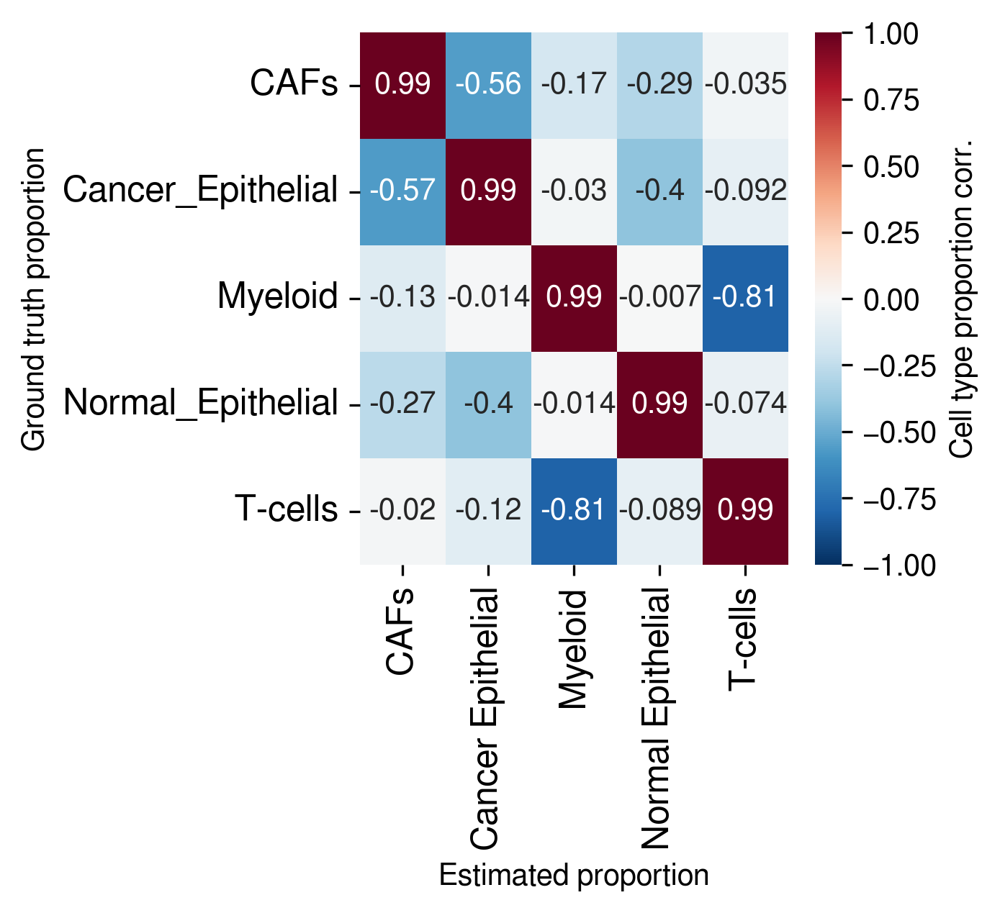

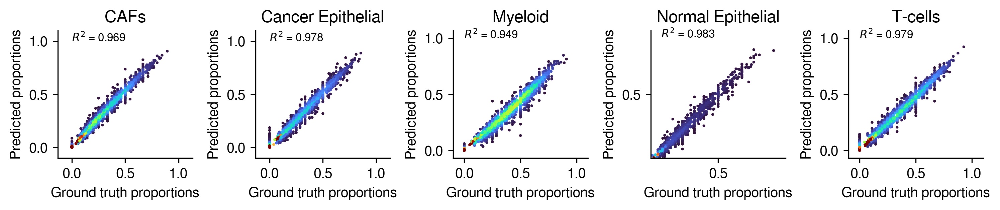

In [13]:
# Bayesprism
out_path = '../../plot_files/'
disp_corr(proportions, proportions_bp, 
          outdir=out_path, 
          filename='Bayesprism',
          savefig=True)

disp_prop_scatter(proportions, proportions_bp,
                  outdir=out_path,
                  filename='Bayesprism_scatter',
                  savefig=True
                 )

### IV. Spatial deconvolution of `CID44971` (Starfysh paper benchmark script)

#### `STDeconvolve`

In [4]:
import torch

In [6]:
# Load data
data_path = '../../starfysh/data/'
sample_id = 'CID44971_TNBC'
adata, adata_normed = utils.load_adata(data_path, sample_id, n_genes=2000)

_, map_info = utils.preprocess_img(
    data_path,
    sample_id,
    adata.obs.index,
    hchannal=False
)

[2022-11-20 00:43:17] Preprocessing1: delete the mt and rp
[2022-11-20 00:43:17] Preprocessing2: Normalize
[2022-11-20 00:43:17] Preprocessing3: Logarithm
[2022-11-20 00:43:17] Preprocessing4: Find the variable genes


In [256]:
st_prop_df.shape

(1162, 30)

In [5]:
%ls ../data/simu_defined

counts.st_synth.csv   proportions.st_synth.csv
members.st_synth.csv  signature.st_synth.csv


In [6]:
import pandas as pd

In [7]:
prop_true = pd.read_csv('../data/simu_defined/proportions.st_synth.csv', index_col=[0])
prop_true.head()

,Activated CD8,B cells memory,Basal,CAFs MSC iCAF-like,CAFs myCAF-like,Endothelial,Macrophage M2,PVL immature,Tcm,pDC
exper0_location_0,0.000000,0.000000,0.400000,0.0,0.200000,0.200000,0.0,0.0,0.2,0.0
exper0_location_1,0.000000,0.000000,0.400000,0.0,0.200000,0.200000,0.0,0.0,0.2,0.0
exper0_location_2,0.000000,0.200000,0.400000,0.0,0.200000,0.200000,0.0,0.0,0.0,0.0
exper0_location_3,0.166667,0.166667,0.333333,0.0,0.166667,0.166667,0.0,0.0,0.0,0.0
exper0_location_4,0.200000,0.000000,0.400000,0.0,0.200000,0.200000,0.0,0.0,0.0,0.0


In [10]:
%ls ../simulation/results/

Bayesprism_44971_proportion.csv     Starfysh_44971_proportions.csv
Bayesprism_proportion.csv           STdeconvolve_44971_proportion.csv
CARD_proportion.csv                 STDeconvolve_proportion.csv
Cell2Location_44971_proportion.csv


In [11]:
# Load deconvolution

# stdeconvolve
#st_prop_df = pd.read_csv('../simulation/results/STdeconvolve_44971_proportion.csv', index_col=[0])
st_prop_df = pd.read_csv('../simulation/results/STDeconvolve_proportion.csv', index_col=[0])
#st_prop_df.head()

# bayesprism
#bp_prop_df = pd.read_csv('../simulation/results/Bayesprism_44971_proportion.csv', index_col=0)

# Cell2Location
#cell2loc_prop_df = pd.read_csv('../simulation/results/Cell2Location_44971_proportion.csv', index_col=0)


In [9]:
cell2loc_prop_df.head()

,q05cell_abundance_w_sf_B cells Memory,q05cell_abundance_w_sf_B cells Naive,q05cell_abundance_w_sf_CAFs MSC iCAF-like s1,q05cell_abundance_w_sf_CAFs MSC iCAF-like s2,q05cell_abundance_w_sf_CAFs Transitioning s3,q05cell_abundance_w_sf_CAFs myCAF like s4,q05cell_abundance_w_sf_CAFs myCAF like s5,q05cell_abundance_w_sf_Cancer Basal SC,q05cell_abundance_w_sf_Cancer Cycling,q05cell_abundance_w_sf_Cancer Her2 SC,...,q05cell_abundance_w_sf_T_cells_c11_MKI67,q05cell_abundance_w_sf_T_cells_c1_CD4+_IL7R,q05cell_abundance_w_sf_T_cells_c2_CD4+_T-regs_FOXP3,q05cell_abundance_w_sf_T_cells_c3_CD4+_Tfh_CXCL13,q05cell_abundance_w_sf_T_cells_c4_CD8+_ZFP36,q05cell_abundance_w_sf_T_cells_c5_CD8+_GZMK,q05cell_abundance_w_sf_T_cells_c6_IFIT1,q05cell_abundance_w_sf_T_cells_c7_CD8+_IFNG,q05cell_abundance_w_sf_T_cells_c8_CD8+_LAG3,q05cell_abundance_w_sf_T_cells_c9_NK_cells_AREG
AACATTGGTCAGCCGT-1,0.007204,0.007799,0.026783,0.015204,0.016876,0.013934,0.008727,0.010738,0.022926,0.009224,...,0.008170,0.007457,0.009849,0.006261,0.006467,0.008632,0.010092,0.007264,0.006201,0.007424
CATCGAATGGATCTCT-1,0.009572,0.006650,0.023493,0.012288,0.003469,0.003307,0.002107,0.010557,0.006866,0.005451,...,0.001118,0.003430,0.002030,0.002107,0.002460,0.001749,0.002114,0.002304,0.002026,0.003332
CGGGTTGTAGCTTTGG-1,0.008709,0.007264,0.018272,0.011573,0.000906,0.002195,0.000304,0.001464,0.000581,0.004592,...,0.000814,0.003562,0.001111,0.001577,0.003007,0.002994,0.001312,0.001524,0.001229,0.003351
CCTAAGTGTCTAACCG-1,0.003637,0.003847,0.016082,0.008241,0.008223,0.006386,0.008113,0.015794,0.011400,0.012301,...,0.002795,0.003986,0.003442,0.003498,0.003010,0.003369,0.003198,0.003296,0.002818,0.003555
TCTGTGACTGACCGTT-1,0.005900,0.006178,0.031602,0.011615,0.001940,0.003004,0.000535,0.002028,0.001569,0.004473,...,0.000539,0.002224,0.001155,0.001354,0.001917,0.001806,0.000837,0.001415,0.000908,0.002049


Convert cell2location columns to our annotation:

In [11]:
cell2loc_prop_df.columns = [
    label.split('w_sf_')[1]
    for label in cell2loc_prop_df.columns
]

In [12]:
cell2loc_prop_df.head()

,B cells Memory,B cells Naive,CAFs MSC iCAF-like s1,CAFs MSC iCAF-like s2,CAFs Transitioning s3,CAFs myCAF like s4,CAFs myCAF like s5,Cancer Basal SC,Cancer Cycling,Cancer Her2 SC,...,T_cells_c11_MKI67,T_cells_c1_CD4+_IL7R,T_cells_c2_CD4+_T-regs_FOXP3,T_cells_c3_CD4+_Tfh_CXCL13,T_cells_c4_CD8+_ZFP36,T_cells_c5_CD8+_GZMK,T_cells_c6_IFIT1,T_cells_c7_CD8+_IFNG,T_cells_c8_CD8+_LAG3,T_cells_c9_NK_cells_AREG
AACATTGGTCAGCCGT-1,0.007204,0.007799,0.026783,0.015204,0.016876,0.013934,0.008727,0.010738,0.022926,0.009224,...,0.008170,0.007457,0.009849,0.006261,0.006467,0.008632,0.010092,0.007264,0.006201,0.007424
CATCGAATGGATCTCT-1,0.009572,0.006650,0.023493,0.012288,0.003469,0.003307,0.002107,0.010557,0.006866,0.005451,...,0.001118,0.003430,0.002030,0.002107,0.002460,0.001749,0.002114,0.002304,0.002026,0.003332
CGGGTTGTAGCTTTGG-1,0.008709,0.007264,0.018272,0.011573,0.000906,0.002195,0.000304,0.001464,0.000581,0.004592,...,0.000814,0.003562,0.001111,0.001577,0.003007,0.002994,0.001312,0.001524,0.001229,0.003351
CCTAAGTGTCTAACCG-1,0.003637,0.003847,0.016082,0.008241,0.008223,0.006386,0.008113,0.015794,0.011400,0.012301,...,0.002795,0.003986,0.003442,0.003498,0.003010,0.003369,0.003198,0.003296,0.002818,0.003555
TCTGTGACTGACCGTT-1,0.005900,0.006178,0.031602,0.011615,0.001940,0.003004,0.000535,0.002028,0.001569,0.004473,...,0.000539,0.002224,0.001155,0.001354,0.001917,0.001806,0.000837,0.001415,0.000908,0.002049


In [13]:
annot_starfysh_wu = {
    'Basal': 'Cancer Basal SC',
    'LumA': None,
    'LumB': 'Cancer LumB SC',
    'MBC': None,
    'CSC': None,
    'Normal epithelial': 'Myoepithelial',
    'Tcm': 'T_cells_c0_CD4+_CCR7',  # Central memory T-cell
    'Tem': 'T_cells_c1_CD4+_IL7R', # Effector memory T-cell
    'Tfh': 'T_cells_c3_CD4+_Tfh_CXCL13',
    'Treg': 'T_cells_c2_CD4+_T-regs_FOXP3', # regulatory T-cell
    'Activated CD8': ['T_cells_c7_CD8+_IFNG', 'T_cells_c8_CD8+_LAG3'],
    'Deletional tolerance CD8': None,
    'Dysfunc CD8': None,
    'Terminal exhaustion': None,
    'Precursor exhaustion': None,
    'NK': None,
    'B cells memory': 'B cells Memory',
    'B cells naive': 'B cells Naive',
    'Macrophage M1': 'Myeloid_c10_Macrophage_1_EGR1',
    'Macrophage M2': 'Myeloid_c9_Macrophage_2_CXCL10',
    'Plasmablasts': 'Plasmablasts',
    'MDSC': None,
    'Monocytes': 'Myeloid_c8_Monocyte_2_S100A9',
    'cDC': ['Myeloid_c11_cDC2_CD1C', 'Myeloid_c3_cDC1_CLEC9A'],
    'pDC': 'Myeloid_c4_DCs_pDC_IRF7',
    'CAFs MSC iCAF-like': ['CAFs myCAF like s4', 'CAFs myCAF like s5'],
    'CAFs myCAF-like': ['CAFs myCAF like s4', 'CAFs myCAF like s5'],
    'PVL differentiated': 'PVL Differentiated s3',  
    'PVL immature': ['PVL Immature s1', 'PVL_Immature s2'],
    'Endothelial': ['Endothelial ACKR1', 'Endothelial CXCL12', 'Endothelial Lymphatic LYVE1', 'Endothelial RGS5'],
}

In [19]:
cell2loc_deconv_dict = {}

for key, val in annot_starfysh_wu.items():
    if val != None:
        if isinstance(val, list):
            cell2loc_deconv_dict[key] = cell2loc_prop_df[val].sum(axis=1)
        else:
            cell2loc_deconv_dict[key] = cell2loc_prop_df[val]

In [25]:
cell2loc_prop_df = pd.DataFrame.from_dict(
    cell2loc_deconv_dict
)

# re-normalize so that proprotion sum for each spot is 1
cell2loc_prop_df = cell2loc_prop_df.apply(lambda x: x / x.sum(), axis=1)
cell2loc_prop_df.head()

,Basal,LumB,Normal epithelial,Tcm,Tem,Tfh,Treg,Activated CD8,B cells memory,B cells naive,...,Macrophage M2,Plasmablasts,Monocytes,cDC,pDC,CAFs MSC iCAF-like,CAFs myCAF-like,PVL differentiated,PVL immature,Endothelial
AACATTGGTCAGCCGT-1,0.023508,0.018629,0.489578,0.036362,0.016327,0.013706,0.021564,0.029480,0.015771,0.017075,...,0.009779,0.017757,0.009135,0.023812,0.005652,0.049611,0.049611,0.031519,0.020883,0.078390
CATCGAATGGATCTCT-1,0.028254,0.011877,0.663570,0.096024,0.009180,0.005638,0.005433,0.011589,0.025619,0.017797,...,0.005911,0.008399,0.002884,0.006319,0.008354,0.014488,0.014488,0.013068,0.021355,0.022572
CGGGTTGTAGCTTTGG-1,0.004306,0.007422,0.656172,0.150035,0.010478,0.004639,0.003269,0.008098,0.025622,0.021371,...,0.001823,0.001522,0.001338,0.012017,0.004417,0.007353,0.007353,0.005965,0.009356,0.052513
CCTAAGTGTCTAACCG-1,0.034501,0.042138,0.657307,0.029074,0.008707,0.007642,0.007518,0.013355,0.007944,0.008404,...,0.005522,0.000936,0.004155,0.007194,0.002974,0.031674,0.031674,0.015344,0.034156,0.044142
TCTGTGACTGACCGTT-1,0.005371,0.011761,0.801292,0.071689,0.005891,0.003585,0.003060,0.006152,0.015625,0.016362,...,0.001404,0.000209,0.001224,0.007296,0.004471,0.009375,0.009375,0.003706,0.009683,0.010536


In [28]:
# Load marker gexp  & filter low-expressed genes
gene_sig = pd.read_csv(os.path.join('../../signature', 'bc_signatures_version_1013.csv'))
gene_sig = utils.filter_gene_sig(gene_sig,adata.to_df())


# Get expression arguments
# Preparing arguments for model training
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    map_info,
                                   )

# Z-normed marker gexp
sig_gexp_df = visium_args.sig_mean_znorm

[2022-11-20 00:59:11] Filtering signatures not highly variable...
[2022-11-20 00:59:11] Smoothing library size by taking averaging with neighbor spots...


	 The number of original variable genes in the dataset (2000,)
	 The number of siganture genes in the dataset (855,)
	 After filter out some genes in the signature not in the var_names ... (205,)
	 After filter out some genes not highly expressed in the signature ... (205,)
	 Combine the varibale and siganture, the total unique gene number is ... 2000
	 The number of original variable genes in the dataset (2000,)
	 The number of siganture genes in the dataset (855,)
	 After filter out some genes in the signature not in the var_names ... (0,)
	 After filter out some genes not highly expressed in the signature ... (0,)
	 Combine the varibale and siganture, the total unique gene number is ... 2000


[2022-11-20 00:59:11] Retrieving & normalizing signature gene expressions...
[2022-11-20 00:59:11] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [21]:
#from importlib import reload
#reload(utils)
#reload(starfysh)

<module 'starfysh.starfysh' from '../starfysh/starfysh.py'>

In [30]:
import time

In [259]:
# Starfysh deconvolution (without AA help)

n_repeats = 3
epochs = 100
patience = 10
device = torch.device('cuda')


# Run models
t0 = time.perf_counter()
model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 epochs=epochs,
                                 patience=patience,
                                 device=device
                                )
t1 = time.perf_counter()

[2022-11-20 21:11:48] Running Starfysh with 3 restarts, choose the model with best parameters...
[2022-11-20 21:11:48]  ===  Restart Starfysh 1 === 

[2022-11-20 21:11:48] Initializing model parameters...
[2022-11-20 21:11:55] Epoch[10/100], train_loss: 2596.8365, train_reconst: 984.3242, train_z: 17.9874,train_c: 1563.3696,train_n: 31.1553
[2022-11-20 21:12:03] Epoch[20/100], train_loss: 2232.4593, train_reconst: 953.5734, train_z: 17.4232,train_c: 1234.0439,train_n: 27.4188
[2022-11-20 21:12:11] Epoch[30/100], train_loss: 2019.1026, train_reconst: 934.0959, train_z: 17.6454,train_c: 1041.0857,train_n: 26.2757
[2022-11-20 21:12:19] Epoch[40/100], train_loss: 1951.1198, train_reconst: 920.1377, train_z: 18.1014,train_c: 986.8766,train_n: 26.0041
[2022-11-20 21:12:27] Epoch[50/100], train_loss: 1839.5273, train_reconst: 903.5986, train_z: 18.5945,train_c: 891.5770,train_n: 25.7572
[2022-11-20 21:12:35] Epoch[60/100], train_loss: 1796.7449, train_reconst: 890.6721, train_z: 19.4760,train

In [32]:
# Extract deconvolution output
lib_low=torch.exp(torch.Tensor([5.0])).to(device)
inference_outputs, generative_outputs, px = starfysh.model_eval(model,
                                                                visium_args.adata, 
                                                                visium_args.sig_mean,
                                                                device,
                                                                visium_args.log_lib,
                                                                lib_low
                                                               )

##### Visualize deconvolution 

In [34]:
sf_prop_df = pd.DataFrame(inference_outputs['qc_m'].detach().numpy(),
                          index=adata.obs.index,
                          columns=sig_gexp_df.columns
                         )

sf_prop_df.head()

,Basal,LumA,LumB,MBC,CSC,Normal epithelial,Tcm,Tem,Tfh,Treg,...,Plasmablasts,MDSC,Monocytes,cDC,pDC,CAFs MSC iCAF-like,CAFs myCAF-like,PVL differentiated,PVL immature,Endothelial
AACATTGGTCAGCCGT-1,0.022013,0.014758,0.014144,0.026440,0.291724,0.013013,0.029140,0.034804,0.034150,0.040388,...,0.018368,0.087481,0.012643,0.062256,0.016395,0.010757,0.013231,0.011996,0.010500,0.009452
CATCGAATGGATCTCT-1,0.012156,0.069971,0.037952,0.081819,0.048797,0.080012,0.024670,0.009062,0.012368,0.036509,...,0.028027,0.033977,0.013644,0.063748,0.035344,0.009637,0.014224,0.052720,0.020928,0.025964
CGGGTTGTAGCTTTGG-1,0.001566,0.127323,0.131694,0.033673,0.000504,0.167570,0.017725,0.002567,0.003531,0.023572,...,0.001042,0.000539,0.001975,0.002725,0.001142,0.001765,0.000728,0.075222,0.003900,0.023695
CCTAAGTGTCTAACCG-1,0.037750,0.044038,0.020754,0.028462,0.294964,0.035899,0.011618,0.015919,0.019224,0.016986,...,0.010438,0.101291,0.014247,0.027148,0.030589,0.010096,0.012604,0.016835,0.011472,0.009410
TCTGTGACTGACCGTT-1,0.011413,0.126941,0.125151,0.011123,0.058296,0.113052,0.046994,0.009140,0.006080,0.019400,...,0.032776,0.040905,0.016036,0.029582,0.017173,0.014616,0.007965,0.059103,0.027723,0.022127


In [35]:
sf_prop_df.to_csv('results/Starfysh_44971_proportions.csv')

##### Calculate Correlation matrix distance & perform MWU test

- We denote the distance as $\Vert A - I_n \Vert_F$
- The MWU test is performed on 100 bootstrapping of submatrix with sampled cell types

In [42]:
np.random.choice(sf_prop_df.columns, 10)

array(['MDSC', 'Macrophage M1', 'CSC', 'cDC', 'Tcm', 'pDC', 'pDC',
       'Dysfunc CD8', 'CAFs myCAF-like', 'LumA'], dtype=object)

In [29]:
def dist2identity(A):
    n = A.shape[0]
    I = np.identity(n)
    return np.linalg.norm(A - I, ord='fro')


def bootstrap_dists(corr_df, n_iter=1000, n_lbl=10):
    size = corr_df.shape[0]
    n = min(n_lbl, size)
    labels = corr_df.columns
    dists = np.zeros(n_iter)
    
    for i in range(n_iter):
        lbl = np.random.choice(corr_df.columns, n)
        A = corr_df.loc[lbl, lbl].values
        dists[i] = dist2identity(A)
        
    return dists
        
    
    

In [36]:
corr_starfysh_df = np.zeros((len(sig_gexp_df.columns), len(sf_prop_df.columns)))
for i, row in enumerate(sig_gexp_df.columns):
    for j, col in enumerate(sf_prop_df.columns):
        corr_starfysh_df[i, j], _ = pearsonr(sig_gexp_df[row], sf_prop_df[col])
        
corr_starfysh_df = pd.DataFrame(corr_starfysh_df, 
                       index=sig_gexp_df.columns,
                       columns=sf_prop_df.columns
                      )

corr_starfysh_df.fillna(value=0, inplace=True)

corr_starfysh_df.head()

,Basal,LumA,LumB,MBC,CSC,Normal epithelial,Tcm,Tem,Tfh,Treg,...,Plasmablasts,MDSC,Monocytes,cDC,pDC,CAFs MSC iCAF-like,CAFs myCAF-like,PVL differentiated,PVL immature,Endothelial
Basal,0.599125,-0.094729,-0.128170,-0.020235,-0.179260,-0.095062,-0.064985,0.076258,0.057033,-0.031729,...,-0.069061,-0.208345,0.356559,-0.027433,-0.082625,0.065621,0.125712,-0.107590,0.054456,-0.109670
LumA,0.010377,0.655625,0.302731,-0.044463,-0.197468,0.603101,-0.129138,-0.129329,-0.215831,-0.217012,...,-0.161757,-0.218972,-0.090938,-0.104418,-0.081093,-0.116842,-0.203294,0.236022,-0.116935,-0.031000
LumB,-0.111019,0.373638,0.556230,-0.033113,-0.188642,0.386099,-0.095122,-0.162947,-0.197570,-0.187979,...,-0.162360,-0.210865,-0.121454,-0.100935,-0.072697,-0.031050,-0.151765,0.347712,-0.062947,0.034358
MBC,0.057480,-0.047770,-0.032760,0.368942,-0.217476,-0.047974,-0.101193,-0.035507,-0.053933,-0.118451,...,-0.096125,-0.243697,0.176191,-0.047489,-0.080642,0.139612,0.223206,0.043287,0.213145,-0.031116
CSC,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [48]:
# Calculate distance:
dists_starfysh = bootstrap_dists(corr_starfysh_df)

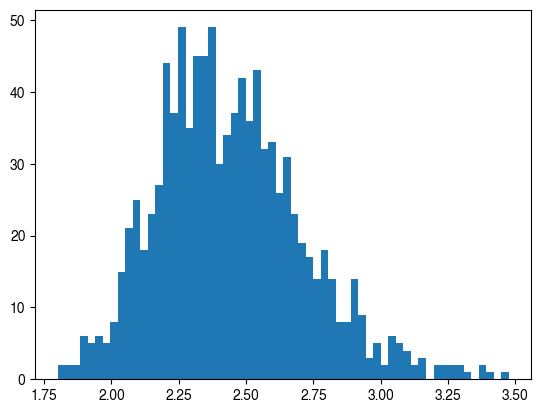

In [53]:
plt.hist(dists_starfysh, bins=60)
plt.show()

In [64]:
np.round(dists_starfysh.mean(), 3)

2.442

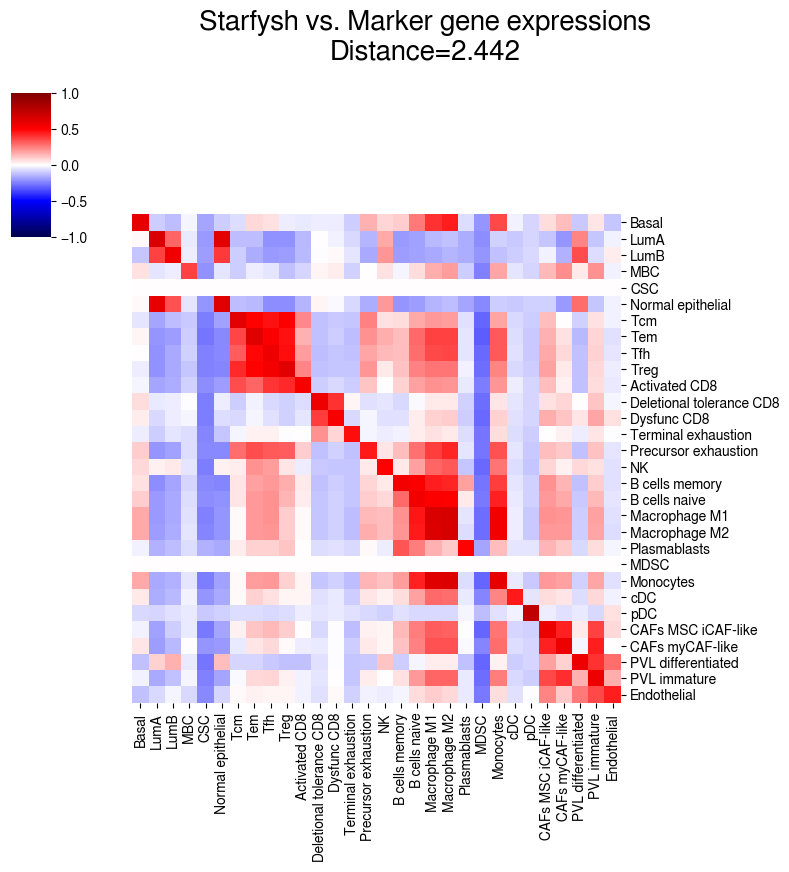

In [68]:
g = sns.clustermap(corr_starfysh_df, 
                   figsize=(8, 8),
                   cmap='seismic', 
                   row_cluster=False,
                   col_cluster=False,
                   square=True,
                   vmin=-1, 
                   vmax=1,
                   xticklabels=True, 
                   yticklabels=True,
                   annot_kws={'size': 15}
                  )
text = g.ax_heatmap.set_title('Starfysh vs. Marker gene expressions\nDistance={}'.format(
        np.round(dists_starfysh.mean(), 3)),
        fontsize=20, x=0.6, y=1.3)
g.savefig('../../plot_files/marker_corr.png', bbox_extra_artists=(text,), bbox_inches='tight', dpi=300)

**STDeconvolve**

In [104]:
corr_stdeconv_df = np.zeros((len(sig_gexp_df.columns), len(st_prop_df.columns)))
for i, row in enumerate(sig_gexp_df.columns):
    for j, col in enumerate(st_prop_df.columns):
        corr_stdeconv_df[i, j], _ = pearsonr(sig_gexp_df[row], st_prop_df[col])
        
corr_stdeconv_df = pd.DataFrame(corr_stdeconv_df, 
                       index=sig_gexp_df.columns,
                       columns=np.arange(len(st_prop_df.columns))
                      )

corr_stdeconv_df.fillna(value=0, inplace=True)

corr_stdeconv_df.head()

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
Basal,-0.027860,0.367968,-0.026403,0.007832,-0.044450,-0.049603,-0.050139,-0.049519,-0.018664,-0.131539,...,0.175892,0.392943,-0.092178,-0.030482,-0.108561,0.126227,-0.004704,-0.149403,-0.090522,-0.117768
LumA,-0.153975,-0.019039,-0.132240,0.339031,-0.130847,-0.117318,-0.161500,0.082898,-0.052244,-0.087664,...,-0.038735,-0.096707,-0.113915,-0.032778,0.461284,-0.137887,-0.172278,0.125413,0.093439,-0.115656
LumB,-0.104213,-0.114595,-0.130284,-0.074589,-0.074413,-0.109818,-0.157019,-0.069039,-0.079020,-0.173857,...,-0.118296,-0.048752,-0.079601,-0.123747,0.590951,-0.092755,-0.135967,0.253955,0.204443,-0.044271
MBC,0.196614,0.165165,-0.031645,-0.009256,-0.057751,-0.080378,-0.070998,-0.018117,-0.036387,-0.098793,...,-0.001311,0.414309,-0.109171,0.024088,-0.042515,0.058885,-0.010045,-0.037724,-0.071133,-0.118934
CSC,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


Now permutate index & columns such that the `argmax(1)` of the correlation matrix is order descending, for calculating distance & statistical test, choose the square submatrix:

In [105]:
order = np.argsort(-corr_stdeconv_df.max(1))
new_idx = corr_stdeconv_df.index[order]


new_col = []
used_cols = set()

for row in new_idx:
    cand_cols = np.argsort(-corr_stdeconv_df.loc[row])
    for col in cand_cols:
        if col not in used_cols:
            new_col.append(col)
            used_cols.add(col)
            break
            
            
corr_stdeconv_df = corr_stdeconv_df.loc[new_idx, new_col]
corr_stdeconv_df.head()

,10,21,25,15,1,4,11,24,14,2,...,28,16,8,13,27,3,9,17,22,29
Basal,0.850036,0.392943,0.126227,0.268452,0.367968,-0.044450,0.018621,-0.108561,-0.065315,-0.026403,...,-0.090522,-0.127810,-0.018664,-0.114471,-0.149403,0.007832,-0.131539,-0.055743,-0.092178,-0.117768
CAFs myCAF-like,0.213343,0.672199,0.242516,0.316774,0.108362,0.058118,0.126350,-0.123018,-0.040459,0.080808,...,-0.135637,-0.112309,-0.096595,-0.127026,-0.131487,-0.114156,-0.171272,-0.135772,-0.091823,-0.148182
Macrophage M1,0.424075,0.617119,0.619757,0.232717,0.210008,0.185429,0.097746,-0.133193,0.000871,0.082403,...,-0.142235,-0.127494,-0.097107,-0.154044,-0.179281,-0.114452,-0.181737,-0.142136,-0.121464,-0.173771
Macrophage M2,0.430229,0.616849,0.612064,0.244249,0.219280,0.180398,0.079099,-0.116643,0.003563,0.072200,...,-0.148565,-0.129467,-0.095710,-0.154228,-0.177471,-0.113138,-0.182043,-0.142941,-0.121071,-0.171927
Monocytes,0.422426,0.588156,0.608456,0.233339,0.185595,0.174834,0.073829,-0.104262,-0.005618,0.077372,...,-0.141717,-0.121267,-0.086623,-0.158909,-0.171961,-0.108083,-0.176968,-0.116370,-0.128303,-0.178980


In [115]:
# Calculate distance:
corr_stdeconv_mapped_df = corr_stdeconv_df.copy()
corr_stdeconv_mapped_df.columns = corr_stdeconv_df.index
dists_stdeconv = bootstrap_dists(corr_stdeconv_mapped_df)

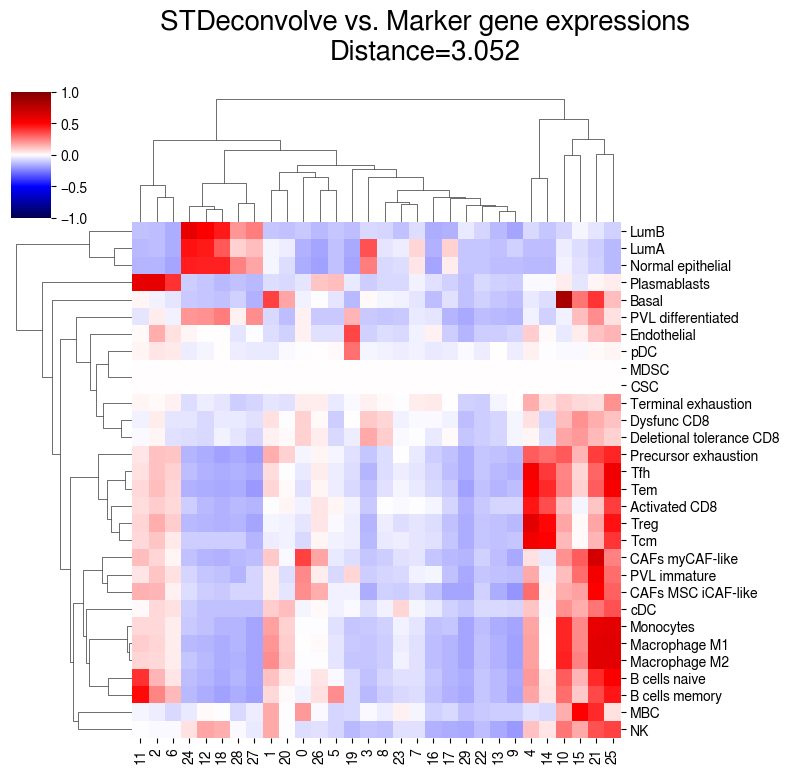

In [141]:
g = sns.clustermap(corr_stdeconv_df,
                   figsize=(8, 7),
                   cmap='seismic', 
                   #row_cluster=False,
                   #col_cluster=False,
                   square=True,
                   vmin=-1,
                   vmax=1,
                   xticklabels=True, 
                   yticklabels=True,
                   annot_kws={'size': 15}
                  )

text = g.ax_heatmap.set_title('STDeconvolve vs. Marker gene expressions\nDistance={}'.format(
        np.round(dists_stdeconv.mean(), 3)),
        fontsize=20, x=0.6, y=1.3)
g.savefig('../../plot_files/marker_stdeconvolve_corr.png', bbox_extra_artists=(text,), bbox_inches='tight', dpi=300)

**BayesPrism**

In [119]:
sig_gexp_bp_df = sig_gexp_df[bp_prop_df.columns]
sig_gexp_bp_df.head()

,Endothelial,CAFs myCAF-like,PVL differentiated,PVL immature,B cells memory,B cells naive,Plasmablasts,Activated CD8,Tcm,Tem,Treg,Tfh,Macrophage M1,Monocytes,Macrophage M2,cDC,pDC,LumB,Basal,Normal epithelial
AACATTGGTCAGCCGT-1,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.092062,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
CATCGAATGGATCTCT-1,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
CGGGTTGTAGCTTTGG-1,0.289006,0.0,0.388085,0.0,0.0,0.0,0.0,0.000000,0.184913,0.0,0.230531,0.025722,0.0,0.0,0.0,0.0,0.0,1.057169,0.0,1.373418
CCTAAGTGTCTAACCG-1,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000
TCTGTGACTGACCGTT-1,0.000000,0.0,0.116098,0.0,0.0,0.0,0.0,0.092062,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.788366,0.0,0.795764


In [122]:
corr_bp_df = np.zeros((len(sig_gexp_bp_df.columns), len(bp_prop_df.columns)))
for i, row in enumerate(sig_gexp_bp_df.columns):
    for j, col in enumerate(bp_prop_df.columns):
        corr_bp_df[i, j], _ = pearsonr(sig_gexp_bp_df[row], bp_prop_df[col])
        
corr_bp_df = pd.DataFrame(corr_bp_df, 
                       index=sig_gexp_bp_df.columns,
                       columns=bp_prop_df.columns
                      )

corr_bp_df.fillna(value=0, inplace=True)
corr_bp_df.head()

,Endothelial,CAFs myCAF-like,PVL differentiated,PVL immature,B cells memory,B cells naive,Plasmablasts,Activated CD8,Tcm,Tem,Treg,Tfh,Macrophage M1,Monocytes,Macrophage M2,cDC,pDC,LumB,Basal,Normal epithelial
Endothelial,0.420554,0.100953,0.023049,0.184734,-0.084891,-0.089422,-0.017355,-0.013385,-0.016244,-0.069016,-0.040343,-0.094770,0.052410,-0.035676,0.076104,0.132688,0.005474,-0.154048,-0.165000,0.020400
CAFs myCAF-like,-0.112202,0.534313,-0.130612,-0.152869,-0.042291,-0.091596,-0.122205,0.074084,-0.065722,-0.082806,0.037637,-0.028174,0.290642,-0.071692,0.438572,-0.071864,-0.063309,-0.322202,-0.267885,-0.055154
PVL differentiated,0.160472,0.049739,0.121355,0.073689,-0.207772,-0.195925,0.134664,-0.138681,-0.099020,-0.143778,-0.155503,-0.178352,0.028879,-0.149776,0.056114,0.037109,-0.144858,-0.215751,-0.245086,0.332741
PVL immature,0.036302,0.361078,-0.051319,0.020085,-0.079960,-0.125340,-0.124183,0.031524,-0.047766,-0.111953,-0.005803,-0.032064,0.237661,-0.056118,0.355833,0.013026,-0.044393,-0.282775,-0.229261,-0.031636
B cells memory,-0.045099,0.280921,-0.145361,-0.027132,0.144059,0.038890,0.044375,0.276411,0.035101,0.069790,0.191848,0.155217,0.425452,0.041985,0.554999,0.069537,0.135455,-0.313159,-0.246049,-0.151040


In [124]:
# Caclulate distance
dists_bayesprism = bootstrap_dists(corr_bp_df)

In [125]:
dists_bayesprism.mean()

3.130256631440669

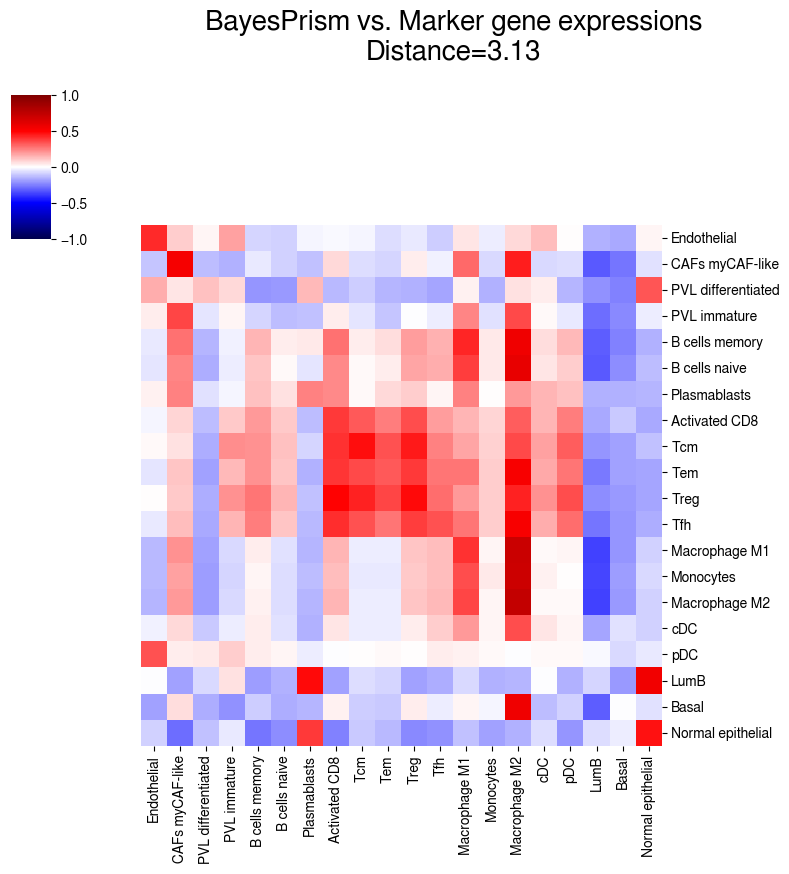

In [142]:
g = sns.clustermap(corr_bp_df,
                   figsize=(8, 8),
                   cmap='seismic', 
                   square=True,
                   vmin=-1,
                   vmax=1,
                   xticklabels=True, 
                   yticklabels=True,
                   row_cluster=False,
                   col_cluster=False,
                   annot_kws={'size': 15}
                  )

text = g.ax_heatmap.set_title('BayesPrism vs. Marker gene expressions\nDistance={}'.format(
        np.round(dists_bayesprism.mean(), 3)),
        fontsize=20, x=0.6, y=1.3)
g.savefig('../../plot_files/marker_bayesprism_corr.png', bbox_extra_artists=(text,), bbox_inches='tight', dpi=300)

**Cell2Location**

In [248]:
sig_gexp_cell2loc_df = sig_gexp_df[cell2loc_prop_df.columns]
sig_gexp_cell2loc_df.head()

,Activated CD8,B cells memory,B cells naive,Basal,CAFs myCAF-like,Endothelial,LumB,Macrophage M1,Macrophage M2,Monocytes,Normal epithelial,PVL differentiated,PVL immature,Plasmablasts,Tcm,Tem,Tfh,Treg,cDC,pDC
AACATTGGTCAGCCGT-1,0.092062,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0
CATCGAATGGATCTCT-1,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0
CGGGTTGTAGCTTTGG-1,0.000000,0.0,0.0,0.0,0.0,0.289006,1.057169,0.0,0.0,0.0,1.373418,0.388085,0.0,0.0,0.184913,0.0,0.025722,0.230531,0.0,0.0
CCTAAGTGTCTAACCG-1,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0
TCTGTGACTGACCGTT-1,0.092062,0.0,0.0,0.0,0.0,0.000000,0.788366,0.0,0.0,0.0,0.795764,0.116098,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0


In [249]:
corr_cell2loc_df = np.zeros((len(sig_gexp_cell2loc_df.columns), len(cell2loc_prop_df.columns)))
for i, row in enumerate(sig_gexp_cell2loc_df.columns):
    for j, col in enumerate(cell2loc_prop_df.columns):
        corr_cell2loc_df[i, j], _ = pearsonr(sig_gexp_cell2loc_df[row], cell2loc_prop_df[col])
        
corr_cell2loc_df = pd.DataFrame(corr_cell2loc_df, 
                       index=sig_gexp_cell2loc_df.columns,
                       columns=cell2loc_prop_df.columns
                      )

corr_cell2loc_df.fillna(value=0, inplace=True)
corr_cell2loc_df.head()

,Activated CD8,B cells memory,B cells naive,Basal,CAFs myCAF-like,Endothelial,LumB,Macrophage M1,Macrophage M2,Monocytes,Normal epithelial,PVL differentiated,PVL immature,Plasmablasts,Tcm,Tem,Tfh,Treg,cDC,pDC
Activated CD8,0.493349,-0.106449,-0.125464,-0.124288,0.039159,-0.064188,-0.099291,0.175362,0.218395,0.167519,-0.186745,-0.151260,-0.182384,0.040448,-0.060842,0.409133,0.456728,0.515085,0.296163,0.042608
B cells memory,0.438939,-0.179795,-0.204177,-0.217968,0.246400,-0.080111,-0.222559,0.549730,0.496960,0.099758,-0.131823,-0.198012,-0.238641,0.386523,-0.173822,0.082181,0.153360,0.288978,0.254734,-0.194901
B cells naive,0.418905,-0.166649,-0.190856,-0.197870,0.218343,-0.081176,-0.205381,0.544183,0.525644,0.120814,-0.101152,-0.198224,-0.242401,0.218062,-0.164922,0.066077,0.153408,0.284880,0.270377,-0.179870
Basal,0.180365,-0.155737,-0.167606,-0.033341,0.126069,-0.142808,-0.099072,0.337940,0.508867,0.068556,0.002902,-0.175249,-0.261616,0.005749,-0.161431,-0.110381,-0.024216,0.087082,0.106896,-0.167945
CAFs myCAF-like,0.267906,-0.187080,-0.203381,-0.204798,0.529168,-0.085720,-0.192762,0.493562,0.448876,-0.023877,0.021112,-0.142699,-0.233075,0.113387,-0.188741,-0.105538,-0.037832,0.104221,0.085651,-0.289445


In [250]:
# Calculate distance
dists_cell2loc = bootstrap_dists(corr_cell2loc_df)

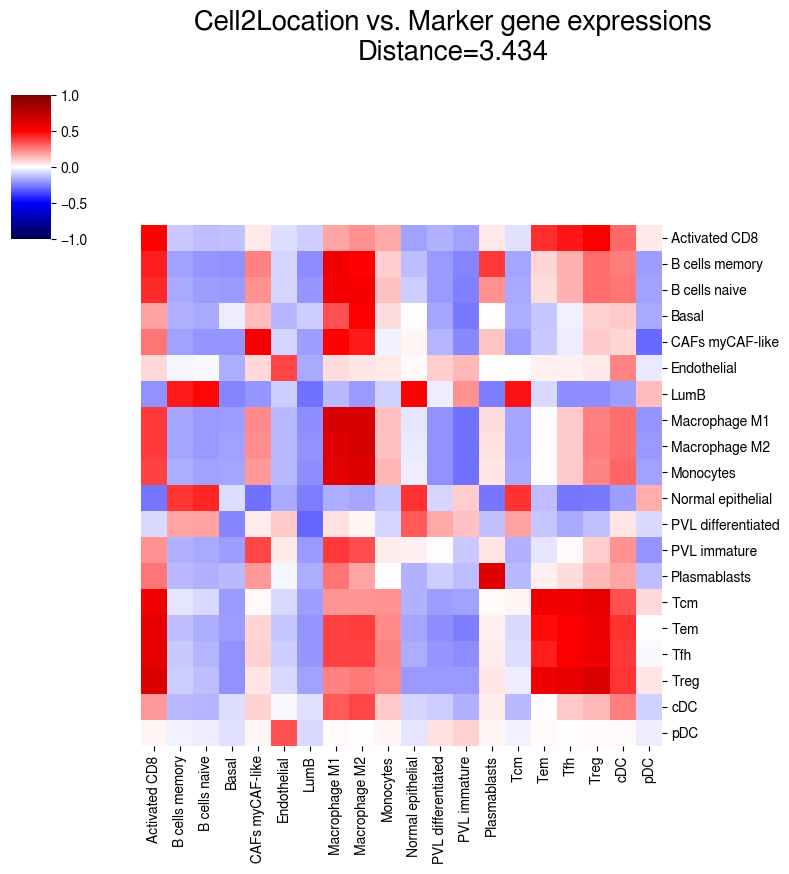

In [251]:
g = sns.clustermap(corr_cell2loc_df,
                   figsize=(8, 8),
                   cmap='seismic', 
                   square=True,
                   vmin=-1,
                   vmax=1,
                   xticklabels=True, 
                   yticklabels=True,
                   row_cluster=False,
                   col_cluster=False,
                   annot_kws={'size': 15}
                  )

text = g.ax_heatmap.set_title('Cell2Location vs. Marker gene expressions\nDistance={}'.format(
        np.round(dists_cell2loc.mean(), 3)),
        fontsize=20, x=0.6, y=1.3)
#g.savefig('../../plot_files/marker_cell2loc_corr.png', bbox_extra_artists=(text,), bbox_inches='tight', dpi=300)

Try MHU test & t-test: Starfysh bootstrapped distances vs. others concatenated:

In [144]:
dists_others = np.concatenate([dists_cell2loc, dists_bayesprism, dists_stdeconv])

In [147]:
p_ttest = ttest_ind(dists_starfysh, dists_others)[1]
p_ttest

0.0

In [148]:
p_mwu = mannwhitneyu(dists_starfysh, dists_others)[1]
p_mwu

0.0

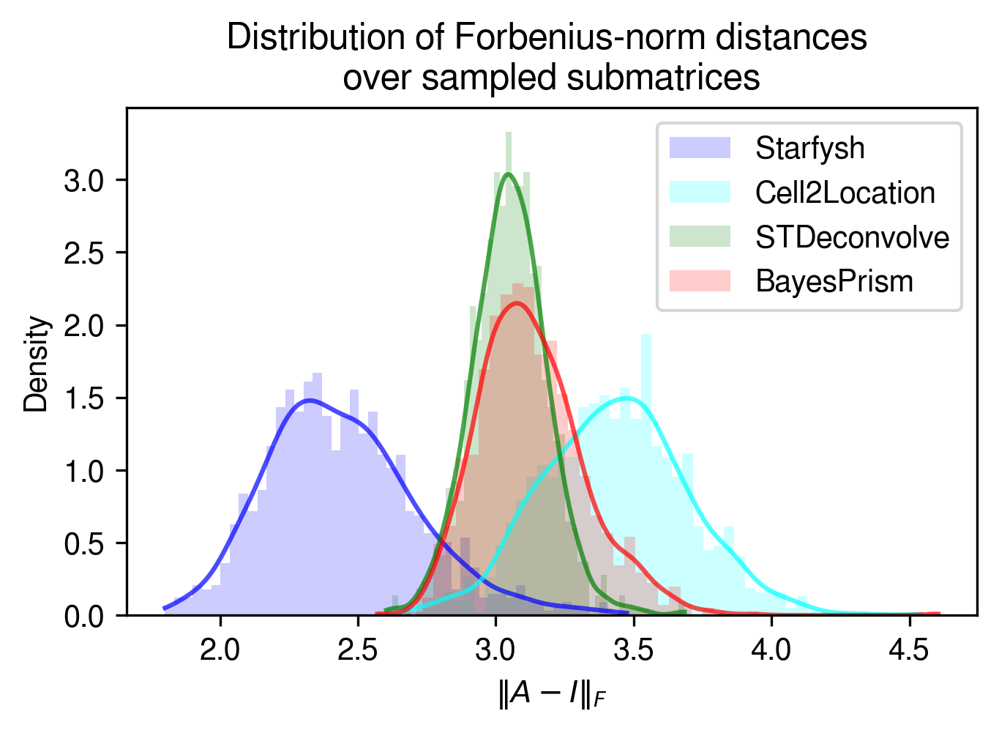

In [264]:
fig, ax = plt.subplots(1, 1, dpi=300, figsize=(5, 3))

ax.hist(dists_starfysh, color='blue', alpha=0.2, bins=50, density=True, label='Starfysh')
ax.hist(dists_cell2loc, color='cyan', alpha=0.2, bins=50, density=True, label='Cell2Location')
ax.hist(dists_stdeconv, color='green', alpha=0.2, bins=50, density=True, label='STDeconvolve')
ax.hist(dists_bayesprism, color='red', alpha=0.2, bins=50, density=True, label='BayesPrism')

# plot fitted KDEs
xx_starfysh = np.linspace(dists_starfysh.min(), dists_starfysh.max(), len(dists_starfysh))
xx_cell2loc = np.linspace(dists_cell2loc.min(), dists_cell2loc.max(), len(dists_cell2loc))
xx_stdeconv = np.linspace(dists_stdeconv.min(), dists_stdeconv.max(), len(dists_stdeconv))
xx_bayesprism = np.linspace(dists_bayesprism.min(), dists_bayesprism.max(), len(dists_bayesprism))

kde1 = gaussian_kde(dists_starfysh)
kde2 = gaussian_kde(dists_cell2loc)
kde3 = gaussian_kde(dists_stdeconv)
kde4 = gaussian_kde(dists_bayesprism)

ax.plot(xx_starfysh, kde1(xx_starfysh), color='blue', alpha=0.7)
ax.plot(xx_cell2loc, kde2(xx_cell2loc), color='cyan', alpha=0.7)
ax.plot(xx_stdeconv, kde3(xx_stdeconv), color='green', alpha=0.7)
ax.plot(xx_bayesprism, kde4(xx_bayesprism), color='red', alpha=0.7)

ax.set_xlabel(r"$\Vert A - I \Vert_F$")
ax.set_ylabel('Density')

ax.legend()
ax.set_title('Distribution of Forbenius-norm distances \n over sampled submatrices ')
plt.show()

In [33]:
adata = visium_args.get_adata()[0]

In [35]:
import json
from skimage import io

def load_img(
    data_path,
    sample_id,
    adata_index
):
    """
    Load and preprocess visium paired H&E image & spatial coords

    Parameters
    ----------
    data_path : str
        Root directory of the data

    sample_id : str
        Sample subdirectory under `data_path`

    adata_index : list
        Valid ST spot barcodes

    Returns
    -------
    adata_image : np.ndarray
        Processed histology image

    map_info : np.ndarray
        Spatial coords of spots (dim: [S, 2])
    """
    adata_image = io.imread(os.path.join(data_path, sample_id, 'spatial', 'tissue_hires_image.png'))

    # Mapping images to location
    f = open(os.path.join(data_path, sample_id, 'spatial', 'scalefactors_json.json', ))
    json_info = json.load(f)
    f.close()
    tissue_hires_scalef = json_info['tissue_hires_scalef']

    tissue_position_list = pd.read_csv(os.path.join(data_path, sample_id, 'spatial', 'tissue_positions_list.csv'), header=None, index_col=0)
    map_info = tissue_position_list.loc[adata_index].iloc[:, 1:3]
    map_info.columns = ['array_row', 'array_col']
    #map_info.loc[:, 'imagerow'] = tissue_position_list.iloc[:, -2] * tissue_hires_scalef
    #map_info.loc[:, 'imagecol'] = tissue_position_list.iloc[:, -1] * tissue_hires_scalef
    map_info.loc[:, 'imagerow'] = tissue_position_list.iloc[:, -2]
    map_info.loc[:, 'imagecol'] = tissue_position_list.iloc[:, -1]
    map_info.loc[:, 'sample'] = sample_id

    return adata_image, map_info, json_info


def update_spatial_info(adata, img, map_info, scalefactor, sample_id):
    adata.uns['spatial'] = {
        sample_id: {
            'images': {
                'hires': (img - img.min()) / (img.max() - img.min())
            },
            'scalefactors': scalefactor
        },
    }
    adata.obsm['spatial'] = map_info[['imagecol', 'imagerow']].values
    return None

In [167]:
adata, adata_normed = visium_args.get_adata()

In [168]:
img, map_info, json_info = load_img(
    data_path,
    sample_id,
    adata.obs.index
)

In [169]:
adata.obsm['bp_deconv'] = bp_prop_df
adata.obsm['sig'] = sig_gexp_df
adata.obsm['sf_deconv'] = pd.DataFrame(
    inference_outputs['qc_m'].detach().cpu().numpy(),
    index=adata.obs_names,
    columns=sig_gexp_df.columns
)

In [183]:
bp_prop_df.columns

Index(['Endothelial_BP', 'CAFs myCAF-like_BP', 'PVL differentiated_BP',
       'PVL immature_BP', 'B cells memory_BP', 'B cells naive_BP',
       'Plasmablasts_BP', 'Activated CD8_BP', 'Tcm_BP', 'Tem_BP', 'Treg_BP',
       'Tfh_BP', 'Macrophage M1_BP', 'Monocytes_BP', 'Macrophage M2_BP',
       'cDC_BP', 'pDC_BP', 'LumB_BP', 'Basal_BP', 'Normal epithelial_BP'],
      dtype='object')

In [184]:
adata.obsm['sig']

,Basal,LumA,LumB,MBC,CSC,Normal epithelial,Tcm,Tem,Tfh,Treg,...,Plasmablasts,MDSC,Monocytes,cDC,pDC,CAFs MSC iCAF-like,CAFs myCAF-like,PVL differentiated,PVL immature,Endothelial
AACATTGGTCAGCCGT-1,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
CATCGAATGGATCTCT-1,0.000000,0.000000,0.000000,0.085623,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
CGGGTTGTAGCTTTGG-1,0.000000,0.947673,1.057169,0.373176,0.0,1.373418,0.184913,0.000000,0.025722,0.230531,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.388085,0.000000,0.289006
CCTAAGTGTCTAACCG-1,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
TCTGTGACTGACCGTT-1,0.000000,0.967637,0.788366,0.000000,0.0,0.795764,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.116098,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGCAGTGGTAGGGAAC-1,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.496428,0.000000,0.123903,0.000000
AGCGAGACGTGAAGGC-1,0.159219,0.000000,0.000000,1.523391,0.0,0.000000,0.000000,0.047034,0.000000,0.419642,...,0.0,0.0,0.0,1.383889,0.0,0.023929,0.448496,0.000000,0.180442,0.000000
CAGTGTTAATCTCTCA-1,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
GATCGCTGTGGTGCGT-1,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.660073,0.152172,0.525419


In [187]:
# Rename deconvolution column names to be method specific

# subset to common cell types
adata.obsm['sig'] = adata.obsm['sig'][bp_prop_df.columns]
adata.obsm['sf_deconv'] = adata.obsm['sf_deconv'][bp_prop_df.columns]

In [189]:
adata.obsm['sig'].columns = [
    f + '_sig' 
    for f in adata.obsm['sig'].columns
]

adata.obsm['sf_deconv'].columns = [
    f + '_starfysh'
    for f in adata.obsm['sf_deconv'].columns
]

adata.obsm['bp_deconv'].columns = [
    f + '_BayesPrism'
    for f in adata.obsm['bp_deconv'].columns
]

In [198]:
# Append entries to adata.obs

adata.obs = pd.concat(
    (adata.obs, adata.obsm['sig'], adata.obsm['sf_deconv'], adata.obsm['bp_deconv']),
    axis=1
)

In [205]:
sc.settings.set_figure_params(dpi=200)

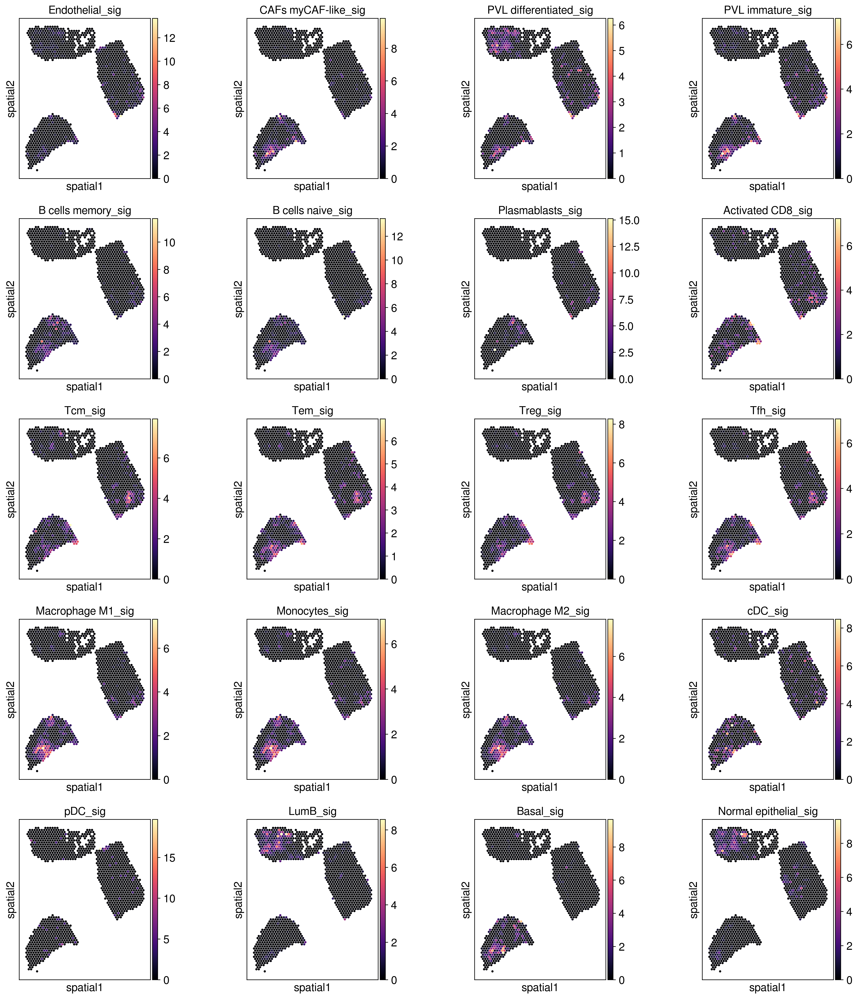

In [207]:
labels_sig = adata.obsm['sig'].columns
sc.pl.spatial(adata, color=labels_sig, alpha_img=0, ncols=4, spot_size=100, cmap='magma')

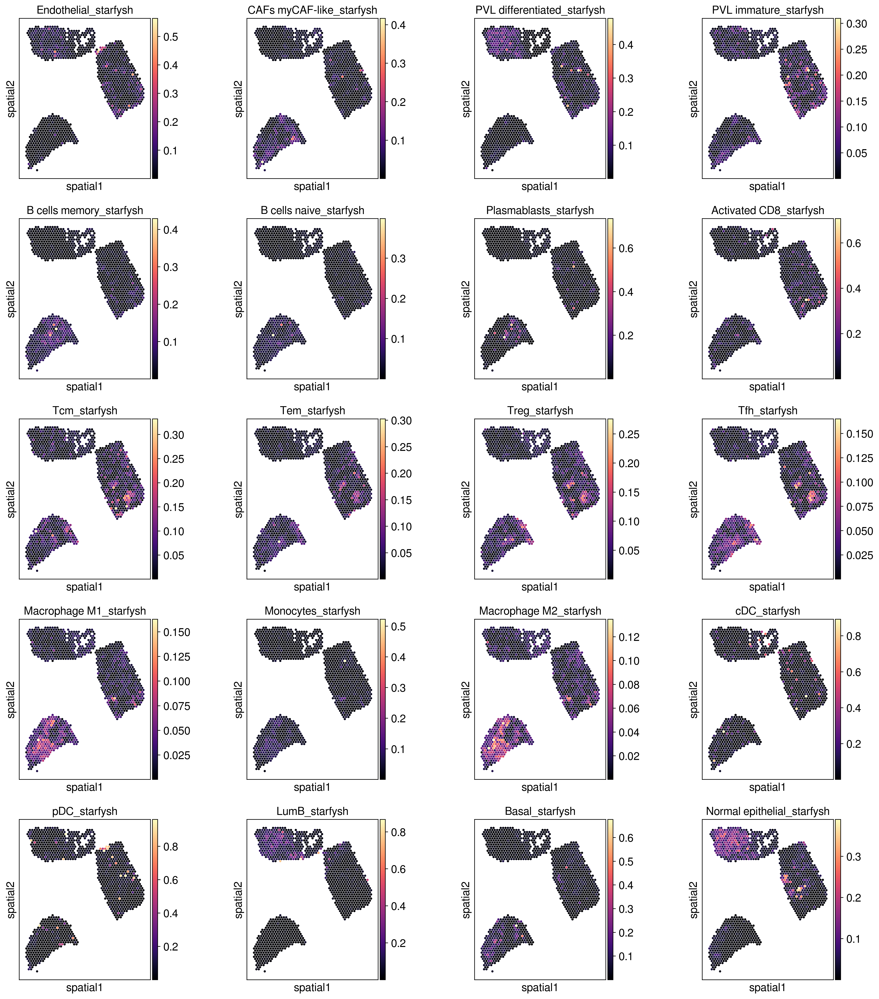

In [208]:
labels_sig = adata.obsm['sf_deconv'].columns
sc.pl.spatial(adata, color=labels_sig, alpha_img=0, ncols=4, spot_size=100, cmap='magma')

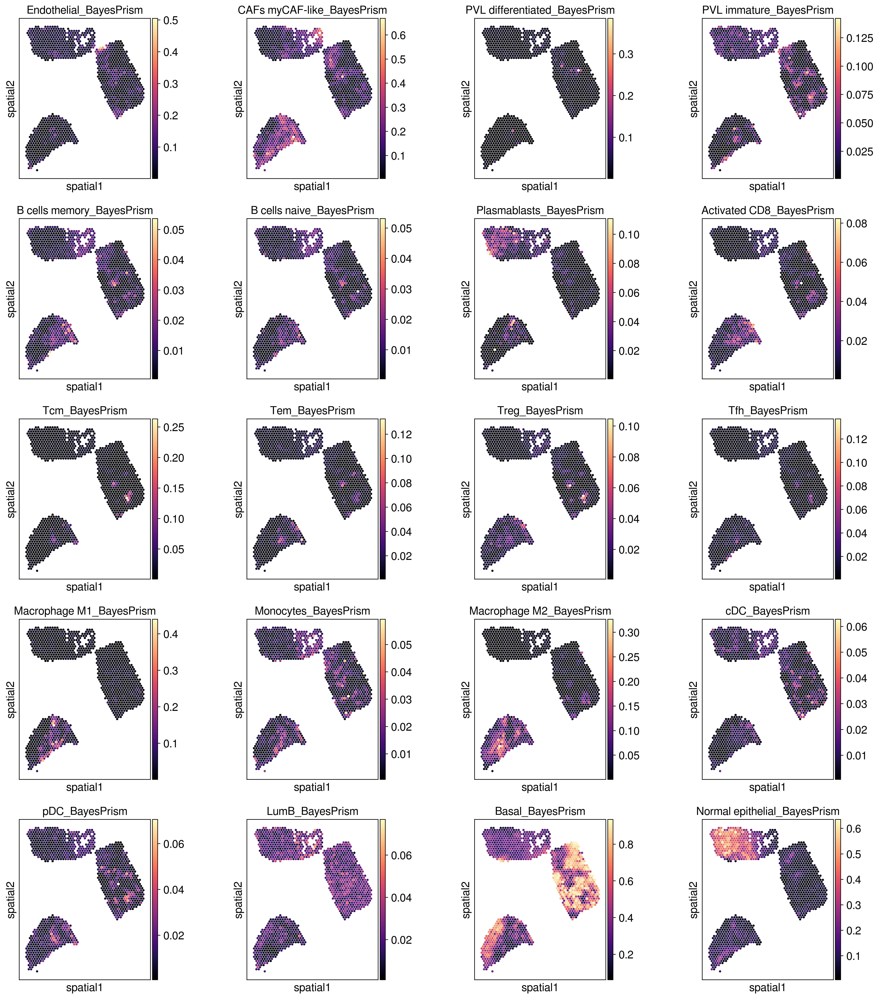

In [209]:
labels_sig = adata.obsm['bp_deconv'].columns
sc.pl.spatial(adata, color=labels_sig, alpha_img=0, ncols=4, spot_size=100, cmap='magma')

In [94]:
from starfysh.plot_utils import plot_spatial_feature, pl_spatial_inf_feature

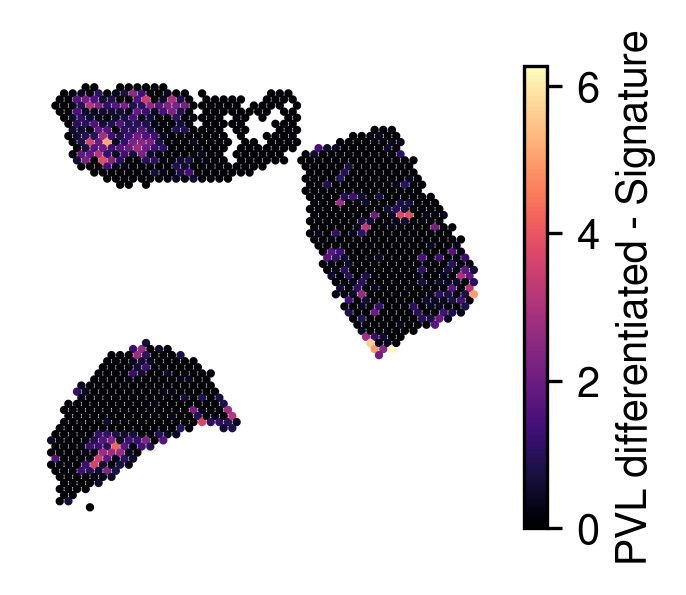

In [157]:
plot_spatial_feature(adata,
                     map_info=map_info,
                     variable=sig_gexp_df['PVL differentiated_sig_gexp'],
                     label='PVL differentiated - Signature'
                    )

In [154]:
for i, factor in enumerate(sig_gexp_df.columns):
    print(i, factor)

0 Basal_sig_gexp
1 LumA_sig_gexp
2 LumB_sig_gexp
3 MBC_sig_gexp
4 CSC_sig_gexp
5 Normal epithelial_sig_gexp
6 Tcm_sig_gexp
7 Tem_sig_gexp
8 Tfh_sig_gexp
9 Treg_sig_gexp
10 Activated CD8_sig_gexp
11 Deletional tolerance CD8_sig_gexp
12 Dysfunc CD8_sig_gexp
13 Terminal exhaustion_sig_gexp
14 Precursor exhaustion_sig_gexp
15 NK_sig_gexp
16 B cells memory_sig_gexp
17 B cells naive_sig_gexp
18 Macrophage M1_sig_gexp
19 Macrophage M2_sig_gexp
20 Plasmablasts_sig_gexp
21 MDSC_sig_gexp
22 Monocytes_sig_gexp
23 cDC_sig_gexp
24 pDC_sig_gexp
25 CAFs MSC iCAF-like_sig_gexp
26 CAFs myCAF-like_sig_gexp
27 PVL differentiated_sig_gexp
28 PVL immature_sig_gexp
29 Endothelial_sig_gexp


In [122]:
sig_gexp_df.columns[19]

'Macrophage M2_sig_gexp'

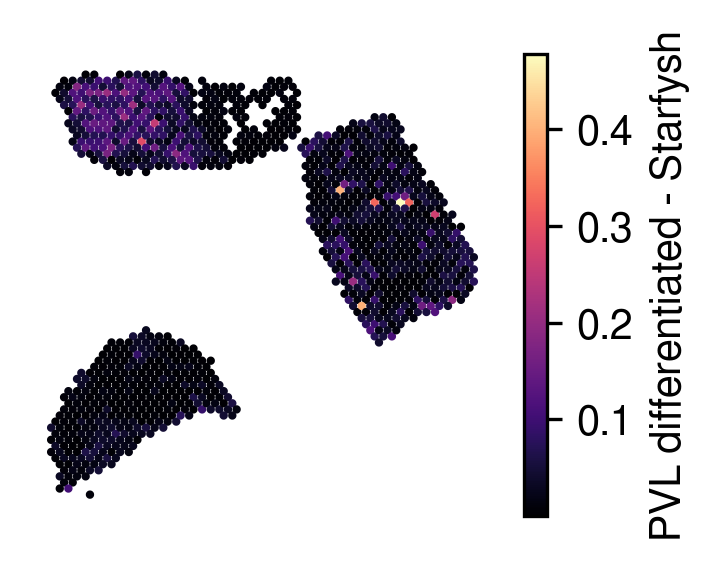

In [160]:
plot_spatial_feature(adata,
                     map_info=map_info,
                     variable=inference_outputs['qc_m'][:, 27].detach().numpy(),
                     label='PVL differentiated - Starfysh'
                    )

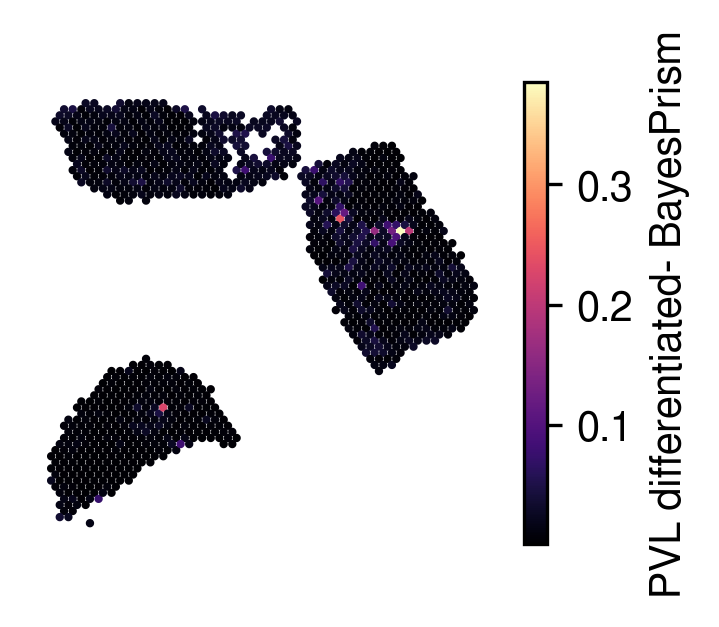

In [159]:
plot_spatial_feature(adata,
                     map_info=map_info,
                     variable=bp_prop_df['PVL differentiated_BP'],
                     label='PVL differentiated- BayesPrism'
                    )

### DEBUG: test PC elbow for each datset

In [40]:
data_path = '../data/'
sample_ids = [
    f for f in sorted(os.listdir(data_path))
    if os.path.isdir(os.path.join(data_path, f))
]

In [45]:
sc.settings.set_figure_params(dpi=200, facecolor='white')

In [43]:
# Load normalized data
adatas = {} # normalized real data

for sample_id in sample_ids:
    _, adata_norm = utils.load_adata(data_path, sample_id, 2000)
    adatas[sample_id] = adata_norm

[2022-10-18 15:44:56] Preprocessing1: delete the mt and rp
/home/yinuo/anaconda3/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/home/yinuo/anaconda3/lib/python3.8/contextlib.py:120: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)
[2022-10-18 15:44:56] Preprocessing2: Normalize
[2022-10-18 15:44:56] Preprocessing3: Logarithm
[2022-10-18 15:44:57] Preprocessing4: Find the variable genes
../starfysh/utils.py:490: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata_sample.var['highly_variable'] = adata_sample_pre.var['highly_variable']
/home/yinuo/anaconda3/lib/python3.8

1142243F


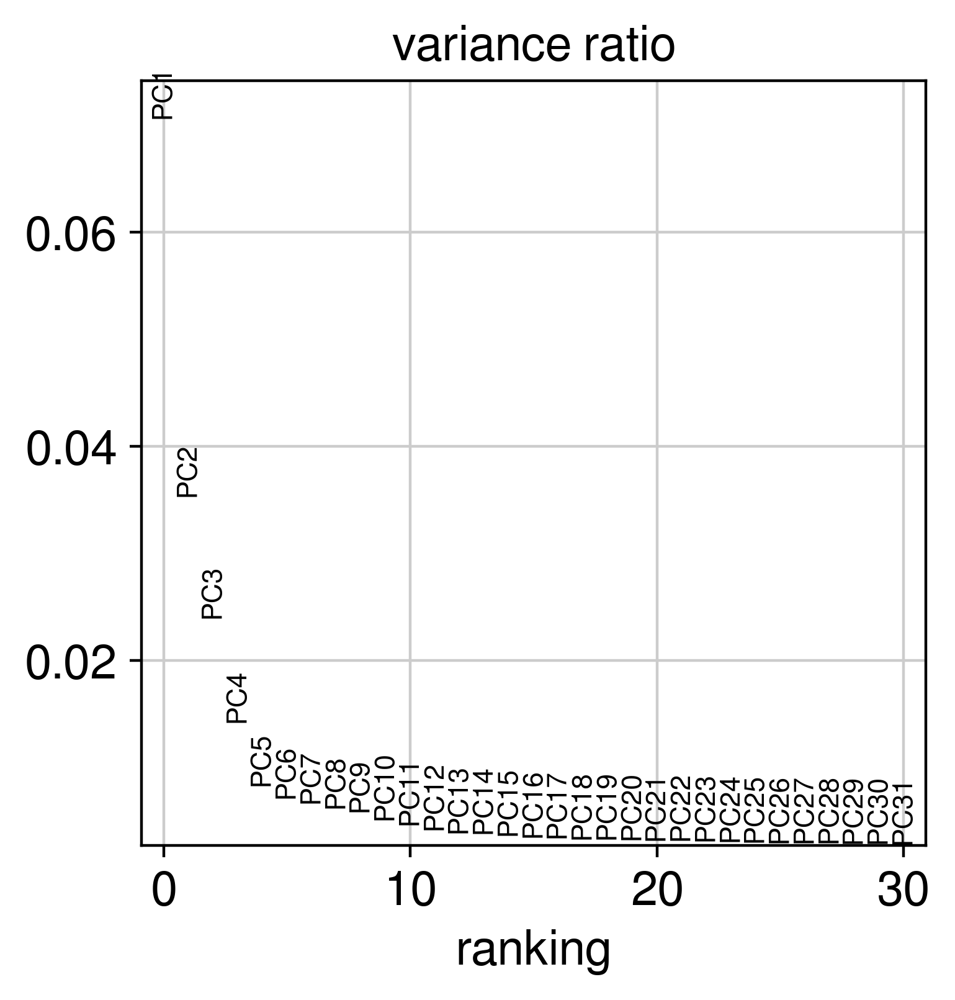

1160920F


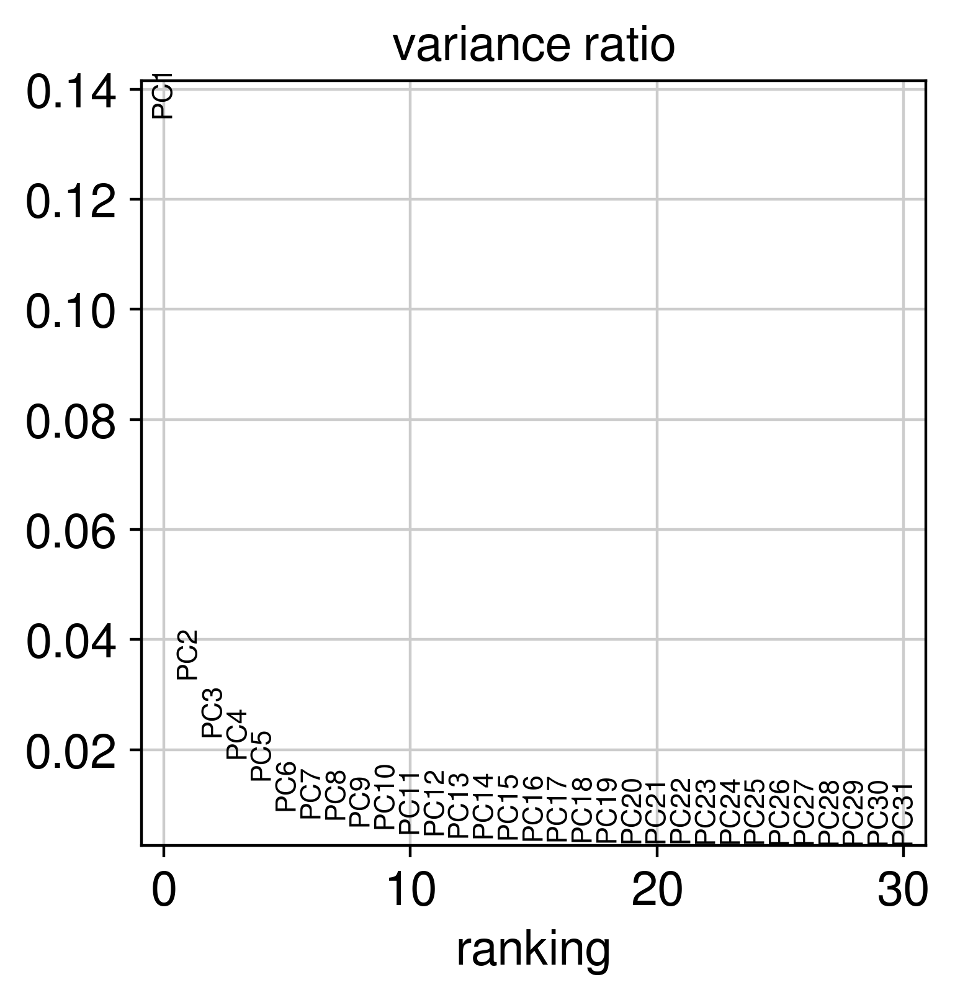

CID4465


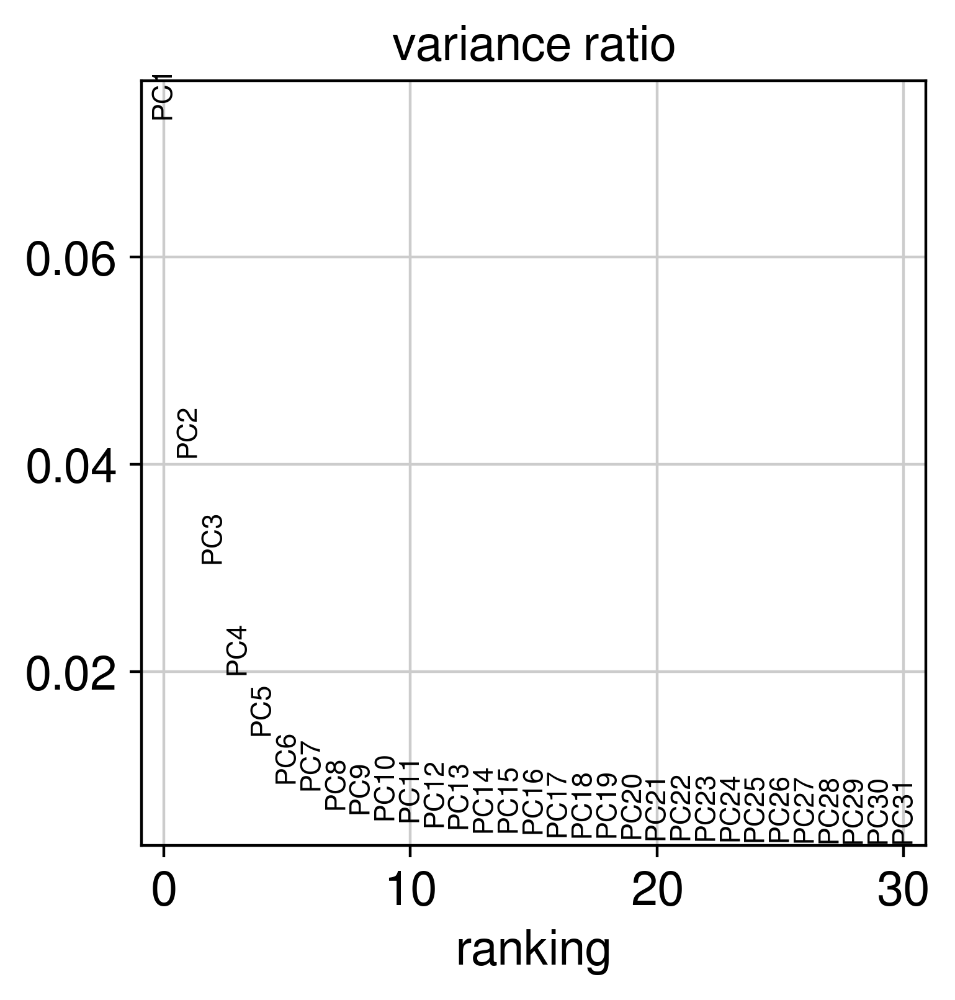

CID44971


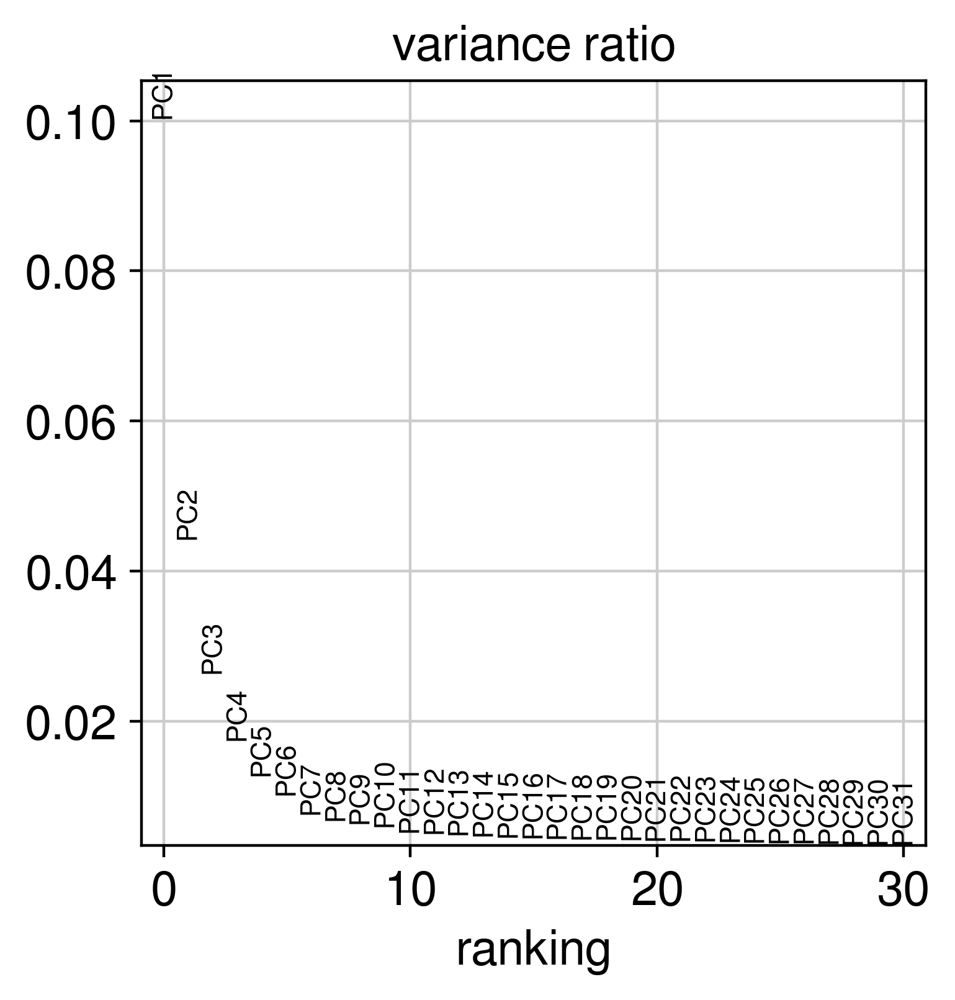

MBC_1A


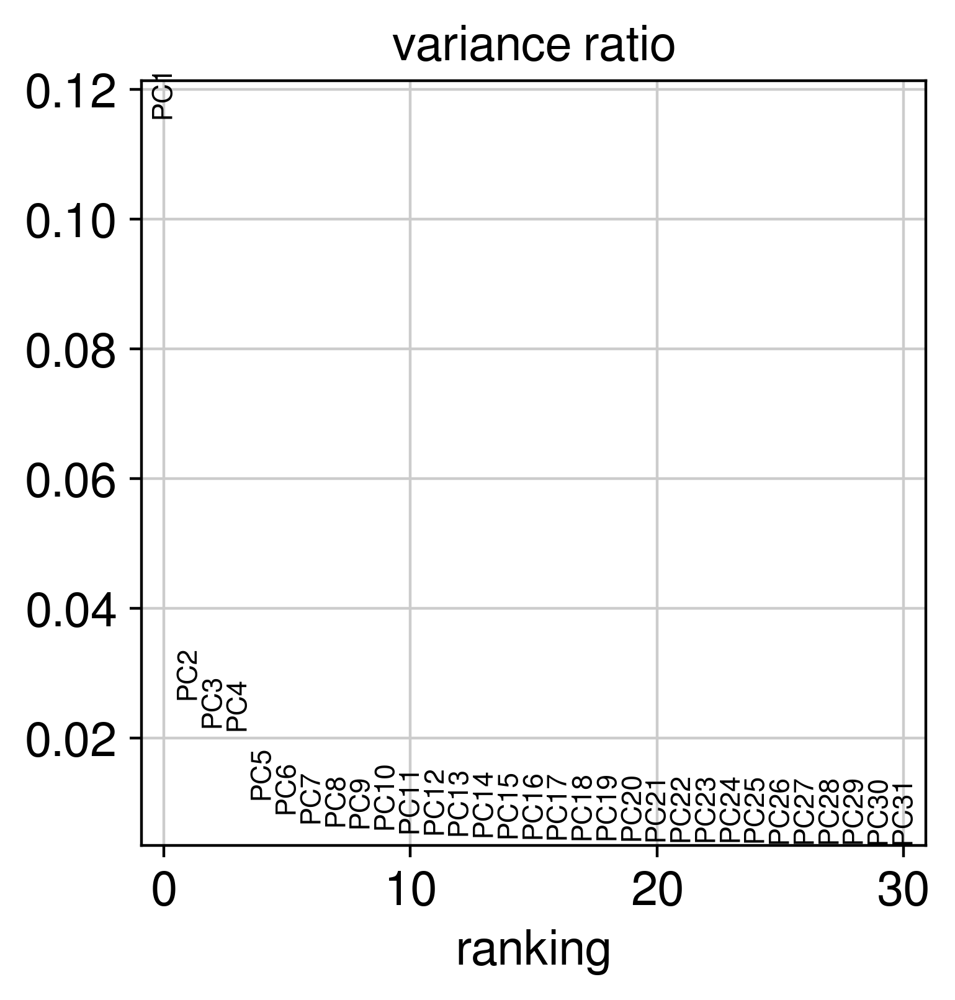

MBC_1B


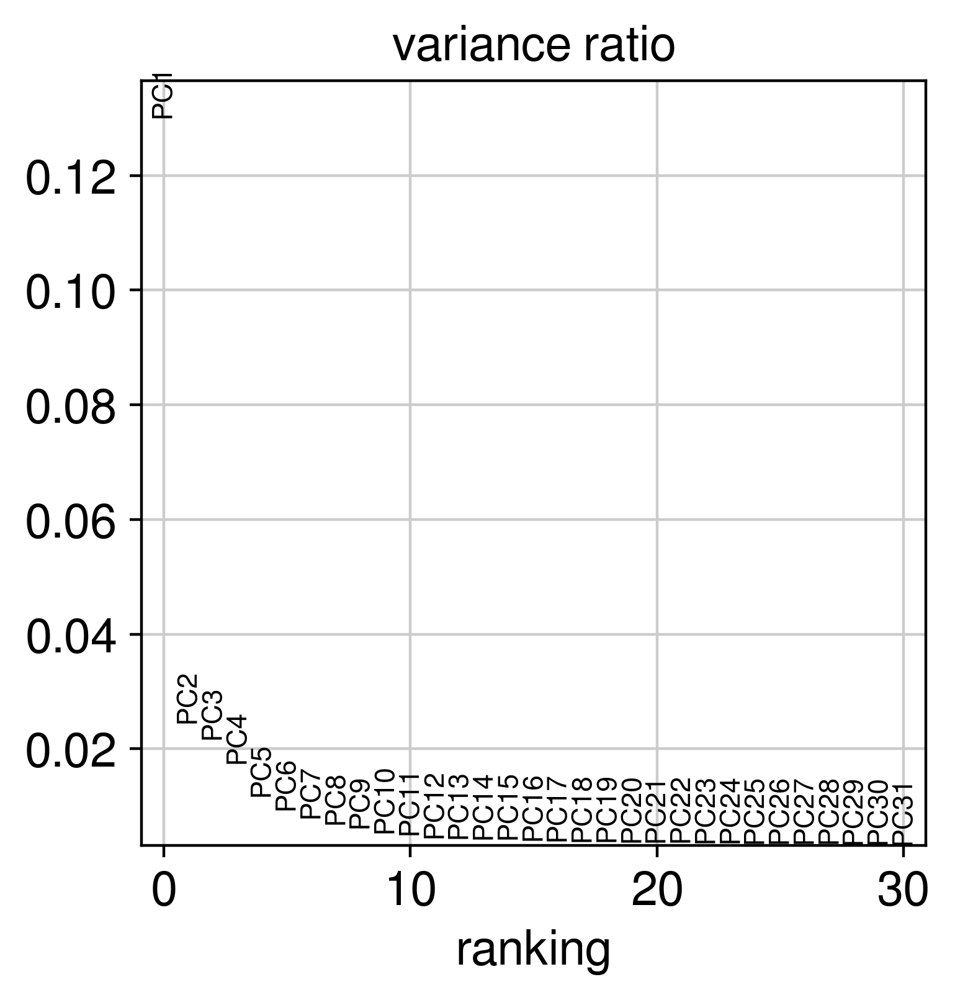

MBC_2A


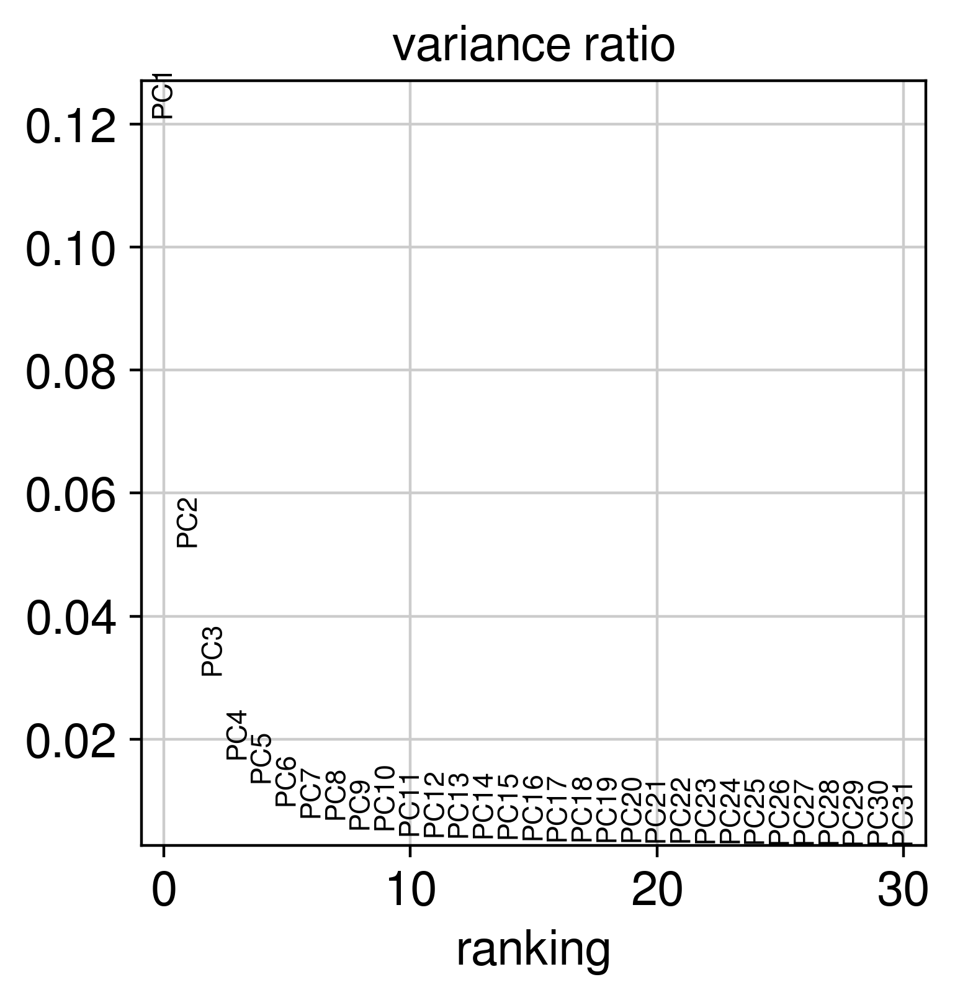

MBC_2B


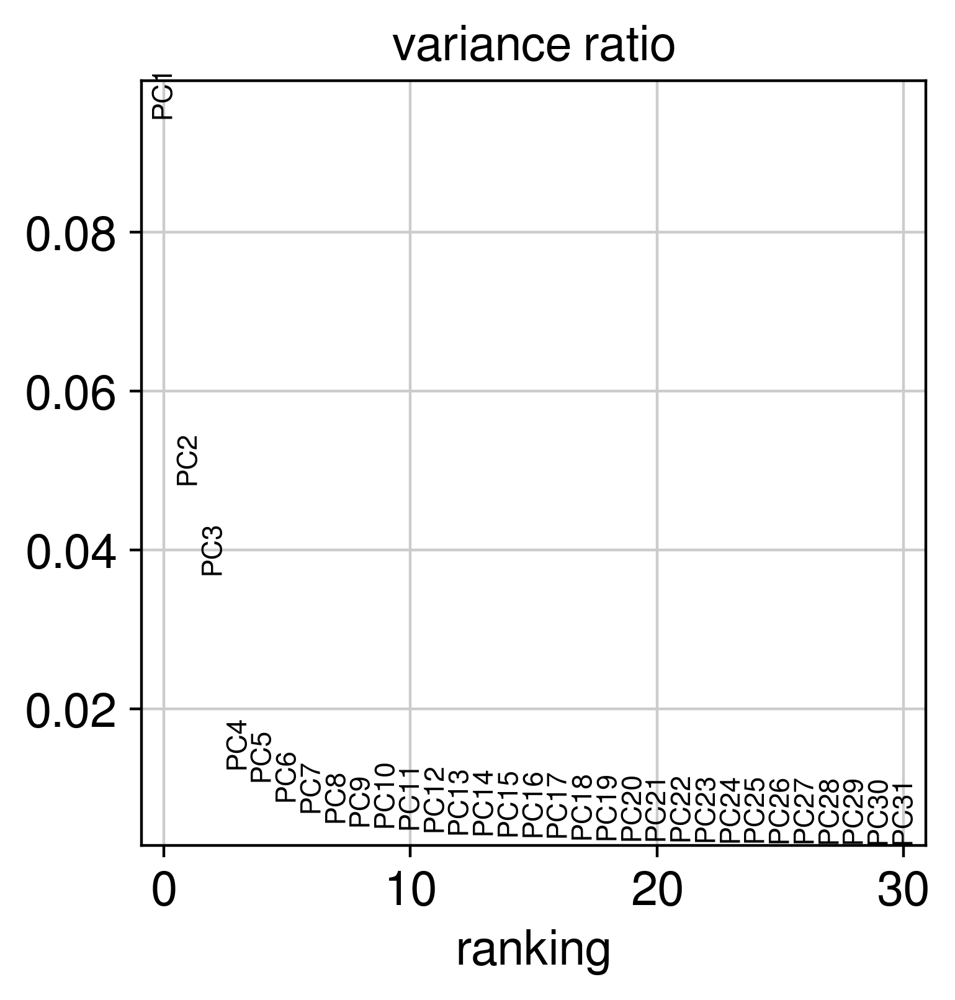

MBC_3A


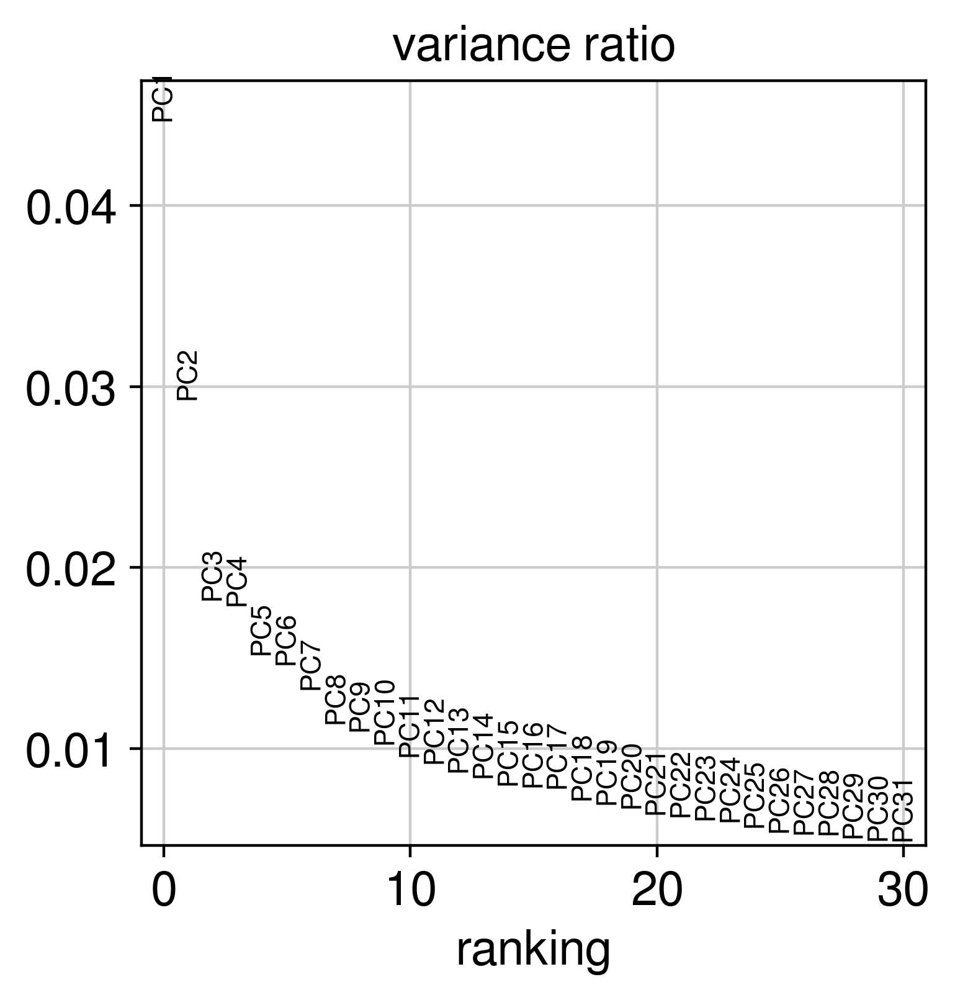

MBC_3B


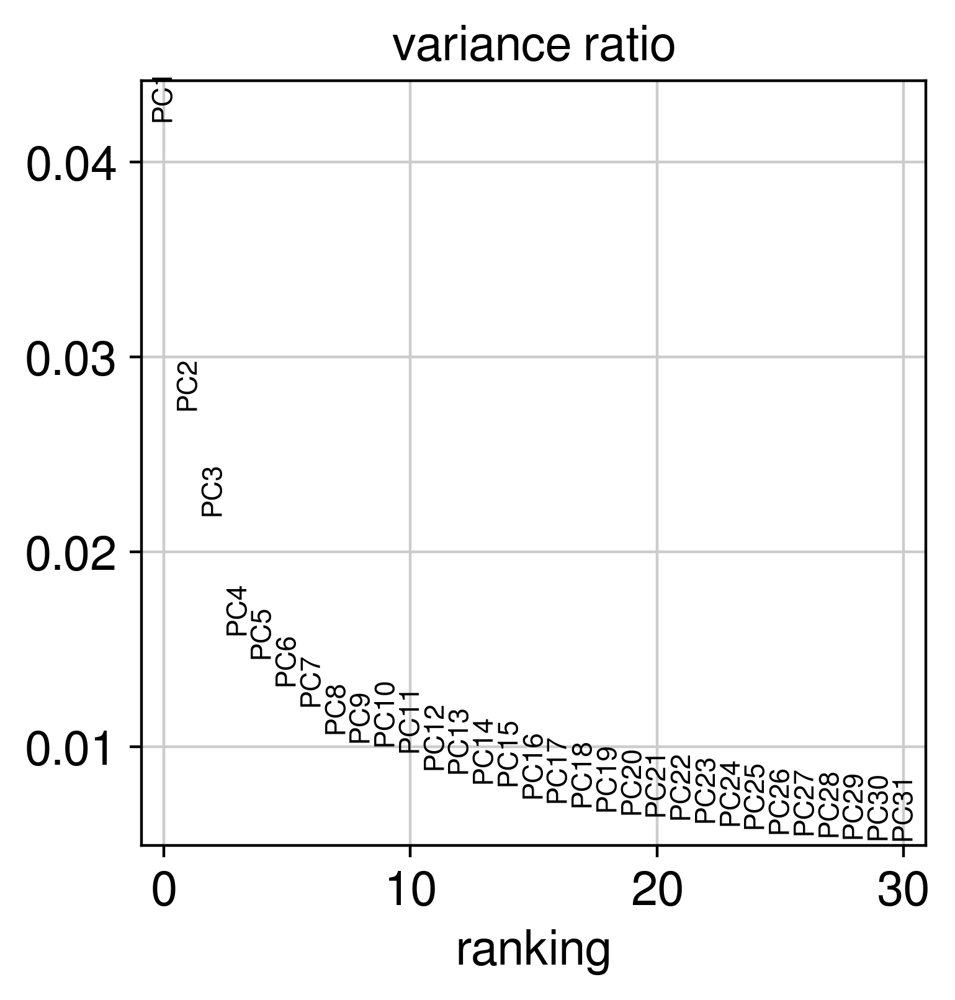

MBC_4A


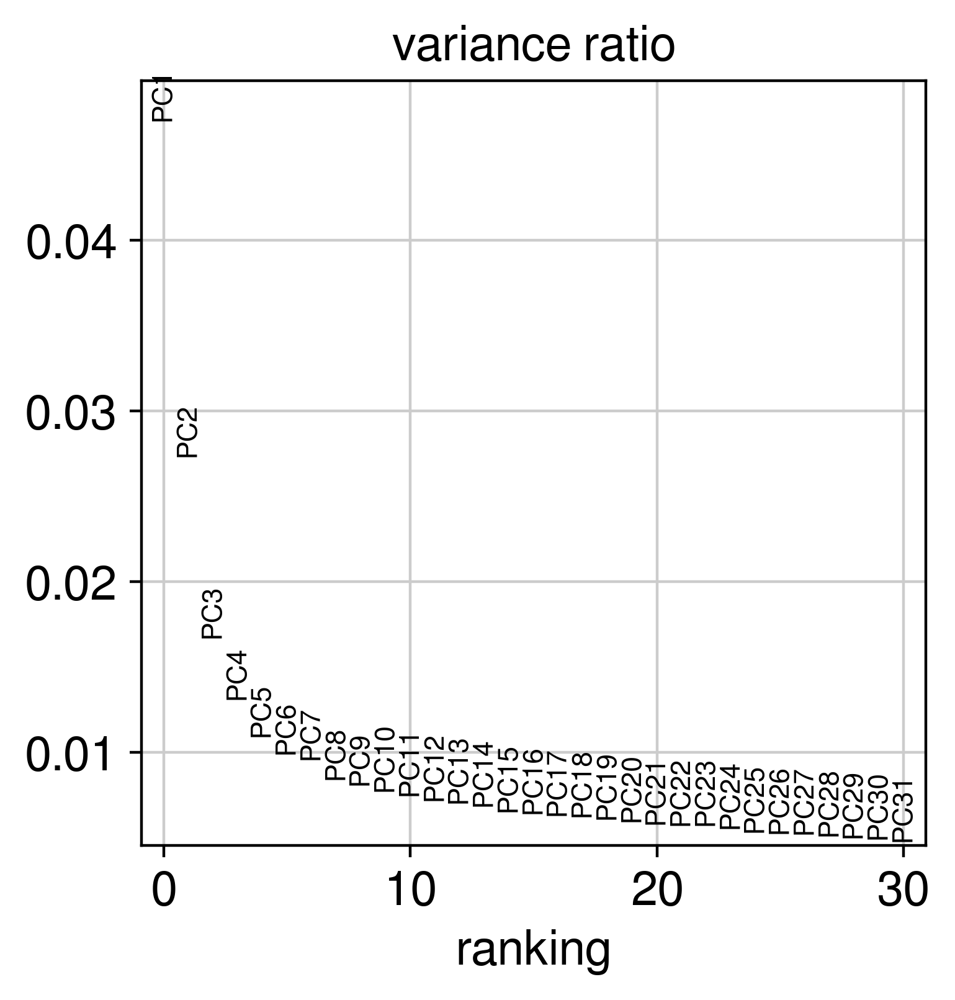

MBC_4B


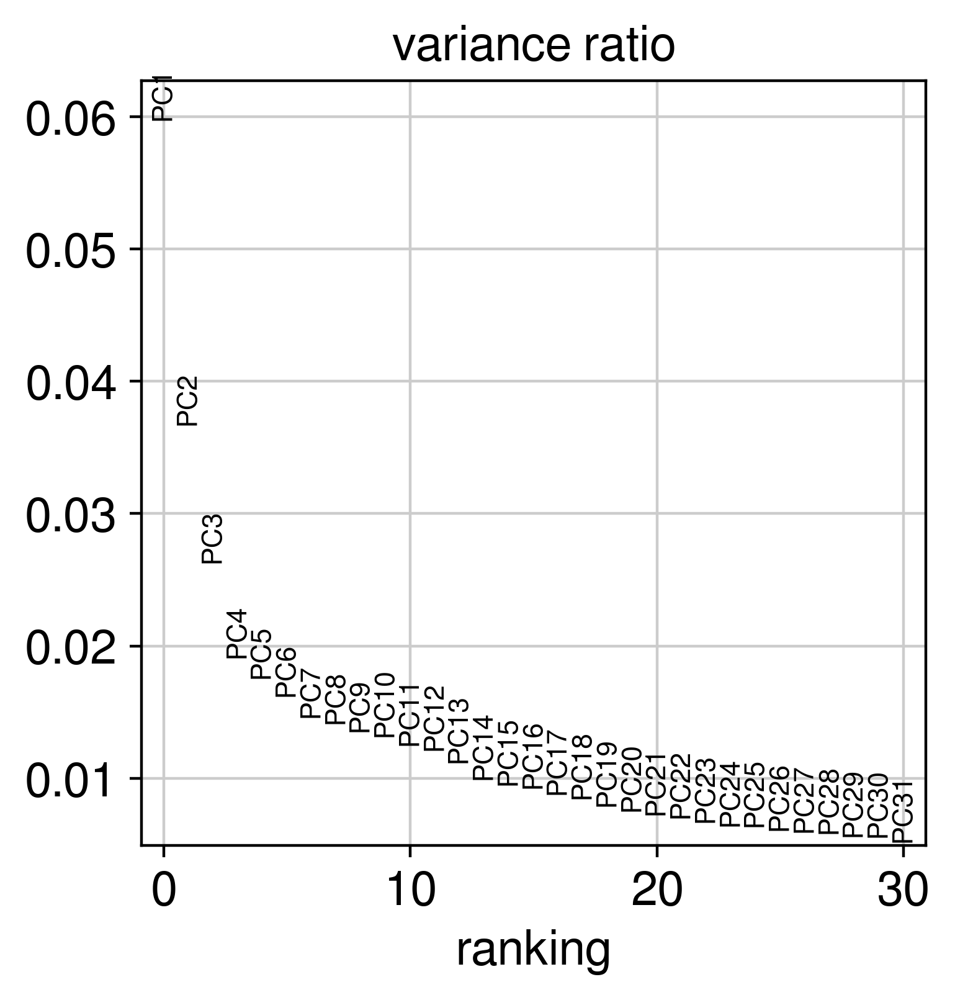

In [46]:
# For each normalized data, plot the ELBOW principle components
for sample_id in sample_ids:
    print(sample_id)
    #sc.tl.pca(adatas[sample_id])
    sc.pl.pca_variance_ratio(adatas[sample_id], log=False)

In [51]:
evs = {}
for sample_id in sample_ids:
    X = adatas[sample_id].X.A
    pca = PCA()
    X_transform = pca.fit_transform(X)
    ev = pca.explained_variance_
    evs[sample_id] = ev

array([9.8911415e+01, 2.5070406e+01, 1.9274351e+01, ..., 2.8497638e-02,
       2.8039213e-02, 1.8131643e-09], dtype=float32)

In [56]:
# Check how many PCs we're actually using to infer ID
ratio = .05

for sample_id in sample_ids:
    cn = int(adatas[sample_id].shape[1] * ratio)
    
    ev = evs[sample_id]
    max_ev = ev[0]
    thld = max_ev / cn
    n_pcs = (ev > thld).sum() # number of retained PCs
    print('Cond. Num.({0})={1}, # PCs={2}'.format(sample_id, cn, n_pcs))

Cond. Num.(1142243F)=1197, # PCs=4783
Cond. Num.(1160920F)=1209, # PCs=3972
Cond. Num.(CID4465)=941, # PCs=1210
Cond. Num.(CID44971)=948, # PCs=1161
Cond. Num.(MBC_1A)=1064, # PCs=2002
Cond. Num.(MBC_1B)=1062, # PCs=1963
Cond. Num.(MBC_2A)=1141, # PCs=1988
Cond. Num.(MBC_2B)=1137, # PCs=1657
Cond. Num.(MBC_3A)=929, # PCs=2283
Cond. Num.(MBC_3B)=913, # PCs=1898
Cond. Num.(MBC_4A)=1028, # PCs=3098
Cond. Num.(MBC_4B)=1001, # PCs=3172


In [59]:
# If keeping conditional number = 10
n_pc_list = []
for sample_id in sample_ids:
    cn = 10
    
    ev = evs[sample_id]
    max_ev = ev[0]
    thld = max_ev / cn
    n_pcs = (ev > thld).sum() # number of retained PCs
    n_pc_list.append(n_pcs)
    print('Cond. Num.({0})={1}, # PCs={2}'.format(sample_id, cn, n_pcs))

Cond. Num.(1142243F)=10, # PCs=8
Cond. Num.(1160920F)=10, # PCs=4
Cond. Num.(CID4465)=10, # PCs=5
Cond. Num.(CID44971)=10, # PCs=5
Cond. Num.(MBC_1A)=10, # PCs=2
Cond. Num.(MBC_1B)=10, # PCs=2
Cond. Num.(MBC_2A)=10, # PCs=2
Cond. Num.(MBC_2B)=10, # PCs=2
Cond. Num.(MBC_3A)=10, # PCs=177
Cond. Num.(MBC_3B)=10, # PCs=249
Cond. Num.(MBC_4A)=10, # PCs=13
Cond. Num.(MBC_4B)=10, # PCs=30


[2022-10-18 16:22:09] Computing intrinsic dimension to estimate k...


8 components are retained using conditional_number=10.00


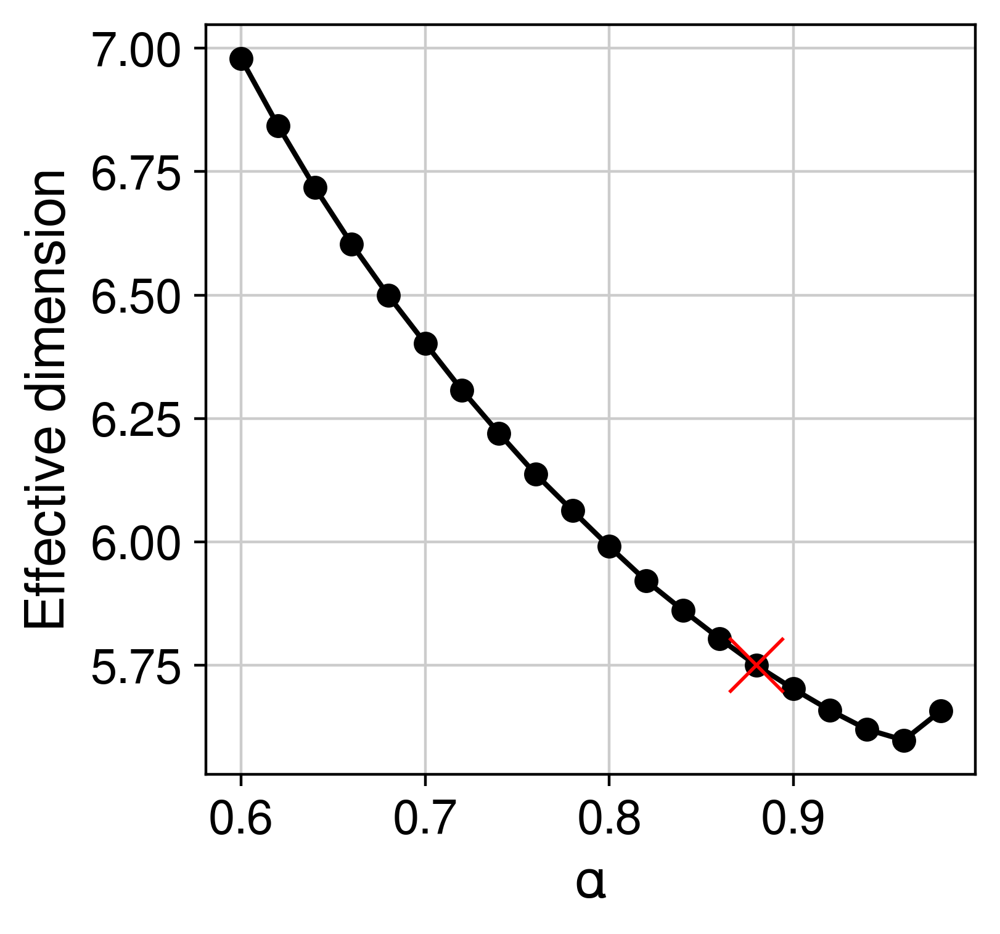

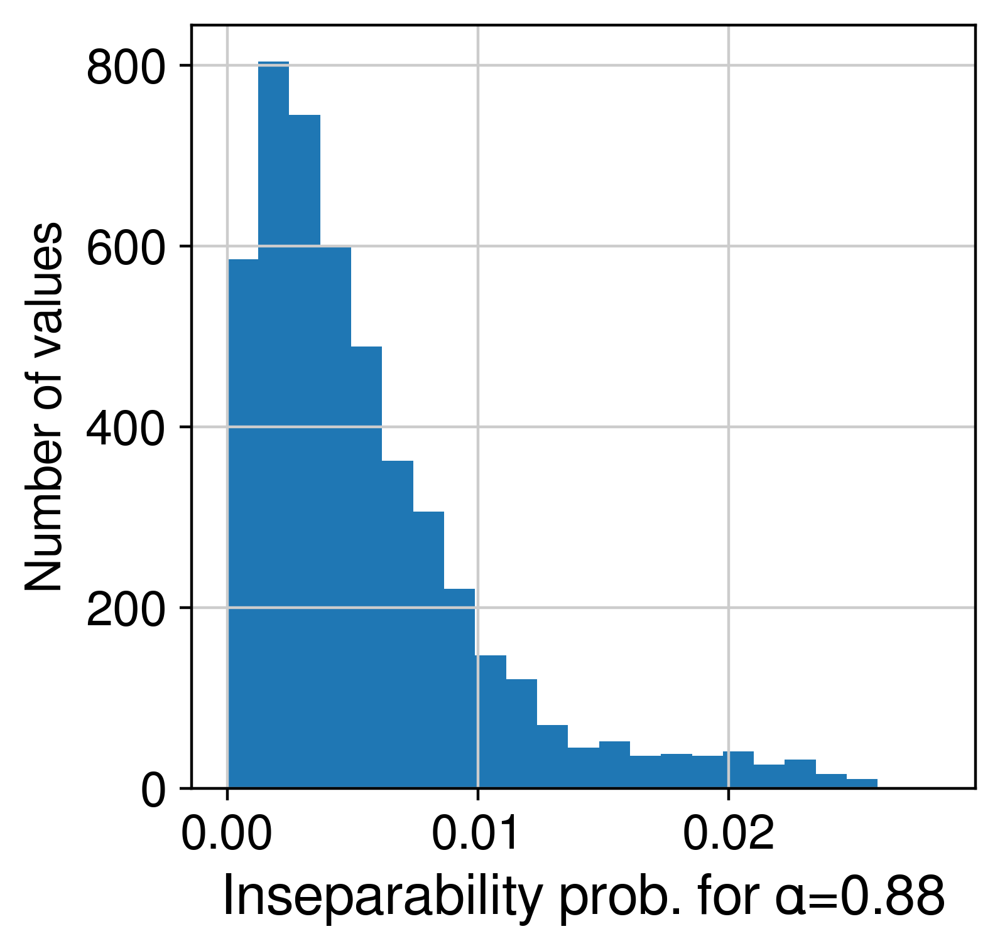

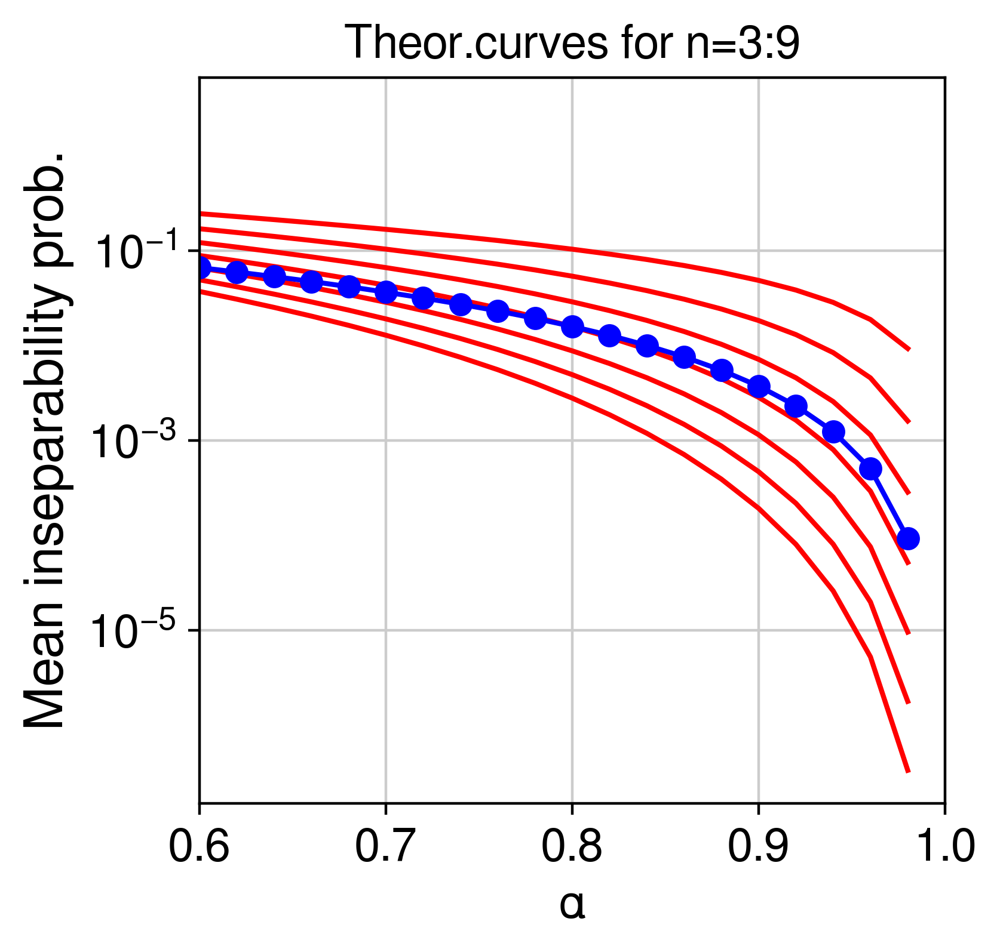

[2022-10-18 16:22:38] Computing 5 archetypes...
[2022-10-18 16:24:26] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:24:45] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:24:58] 0.6174 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:25:00] Computing intrinsic dimension to estimate k...


1142243F # archetypes=23950
4 components are retained using conditional_number=10.00


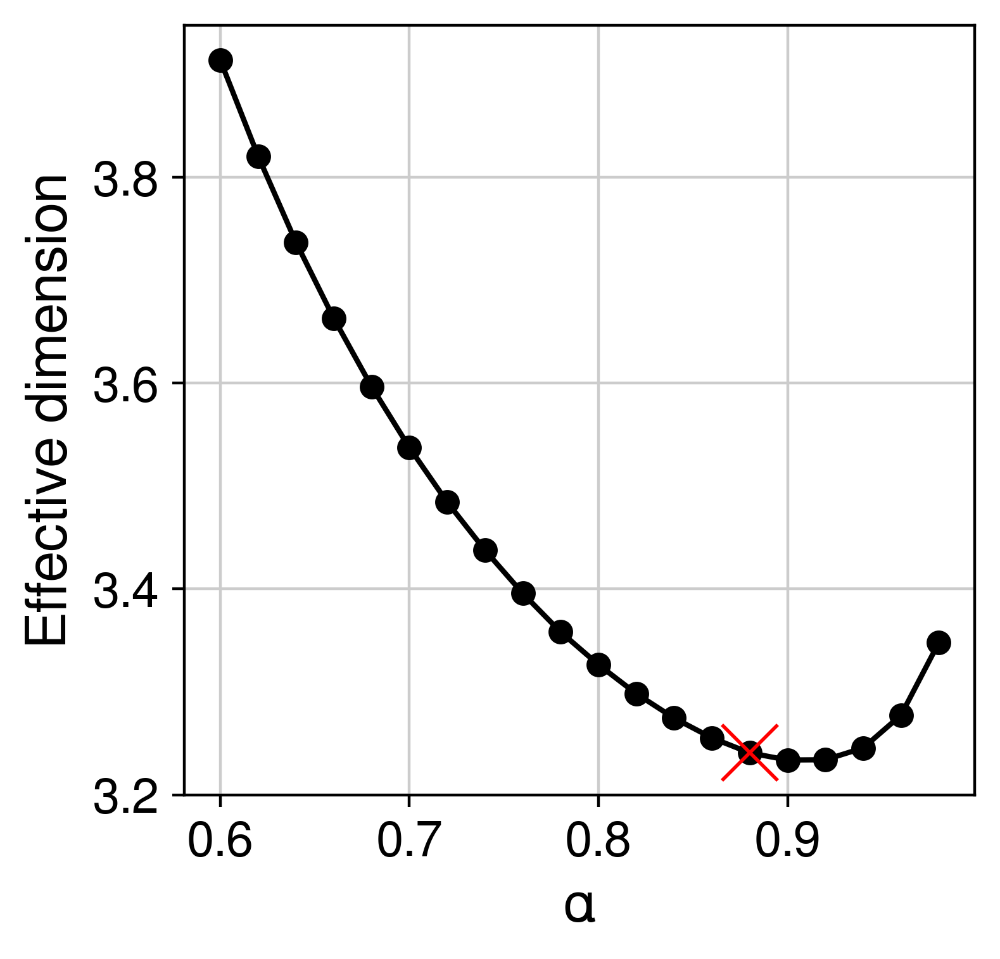

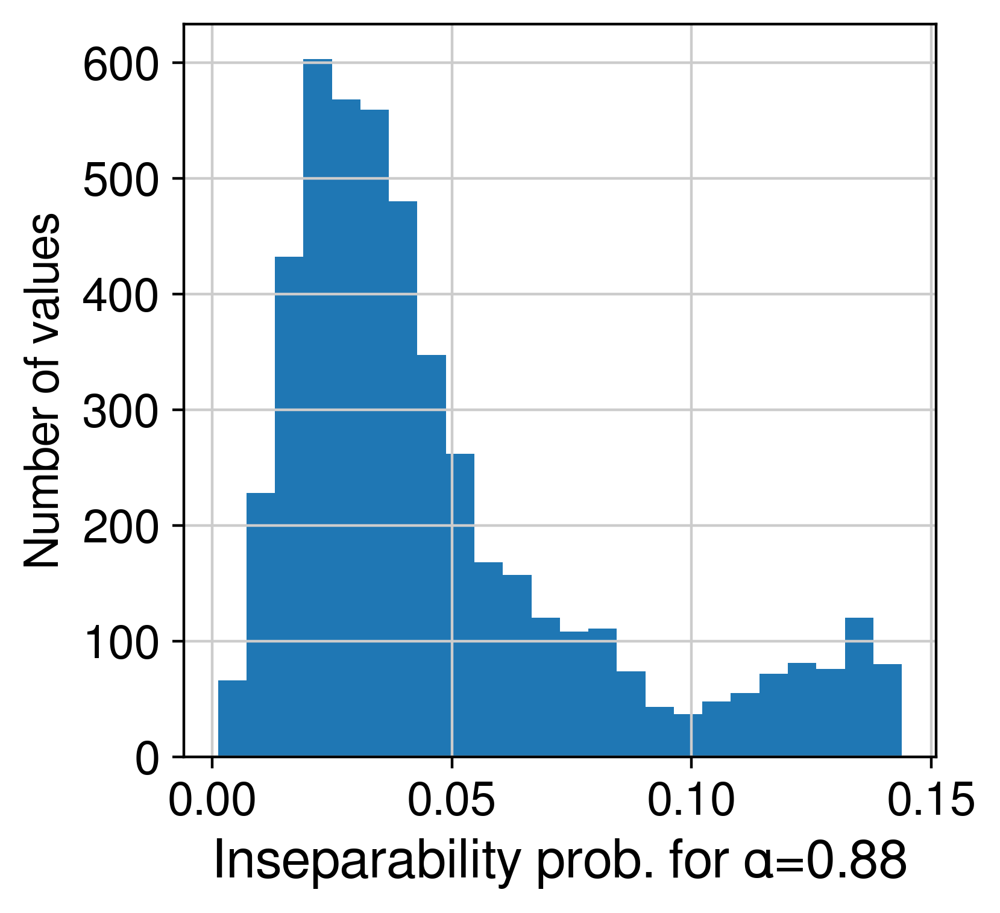

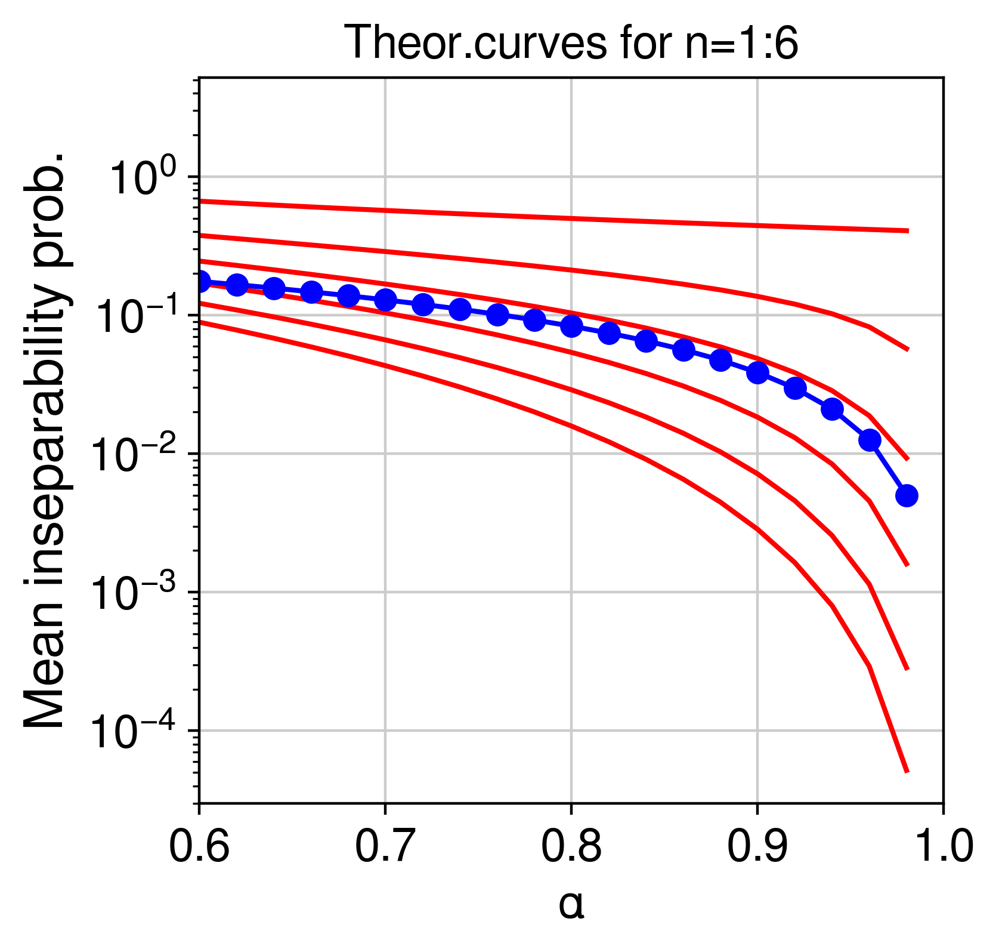

[2022-10-18 16:25:38] Computing 3 archetypes...
[2022-10-18 16:27:14] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:27:28] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:27:42] 0.6922 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:27:43] Computing intrinsic dimension to estimate k...


1160920F # archetypes=24197
5 components are retained using conditional_number=10.00


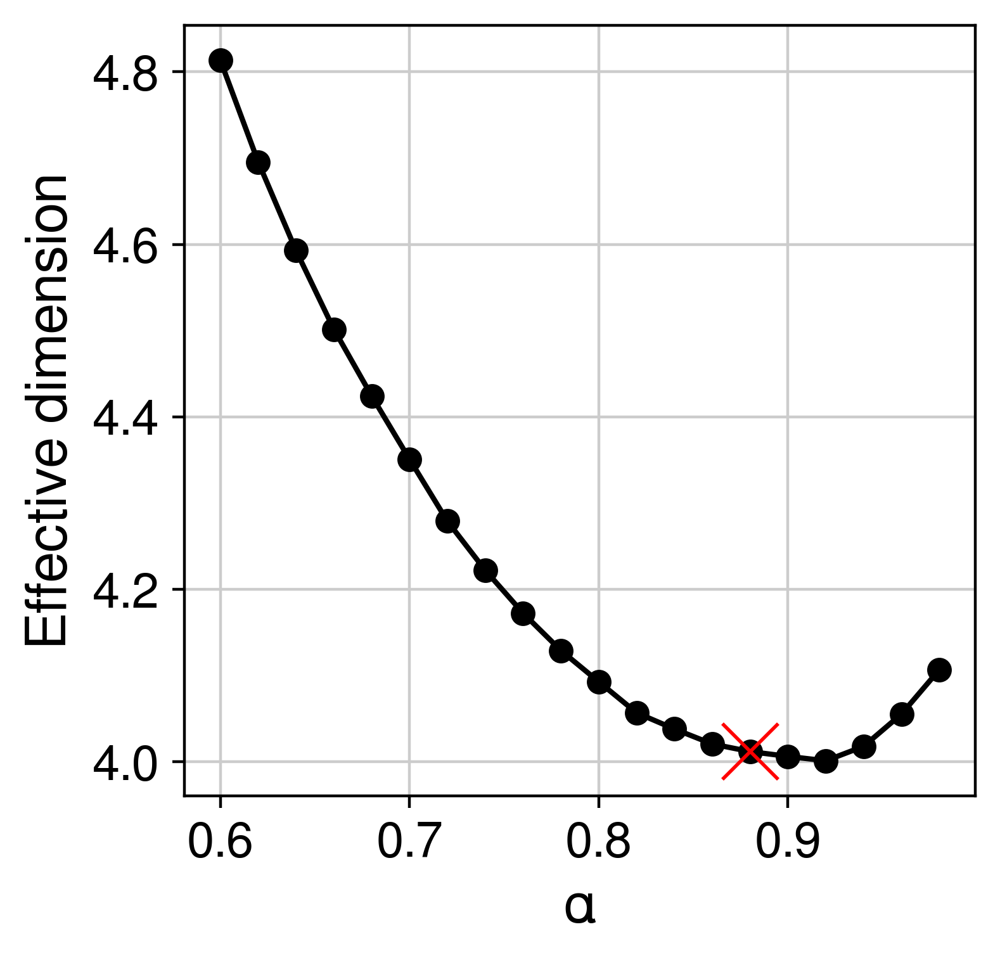

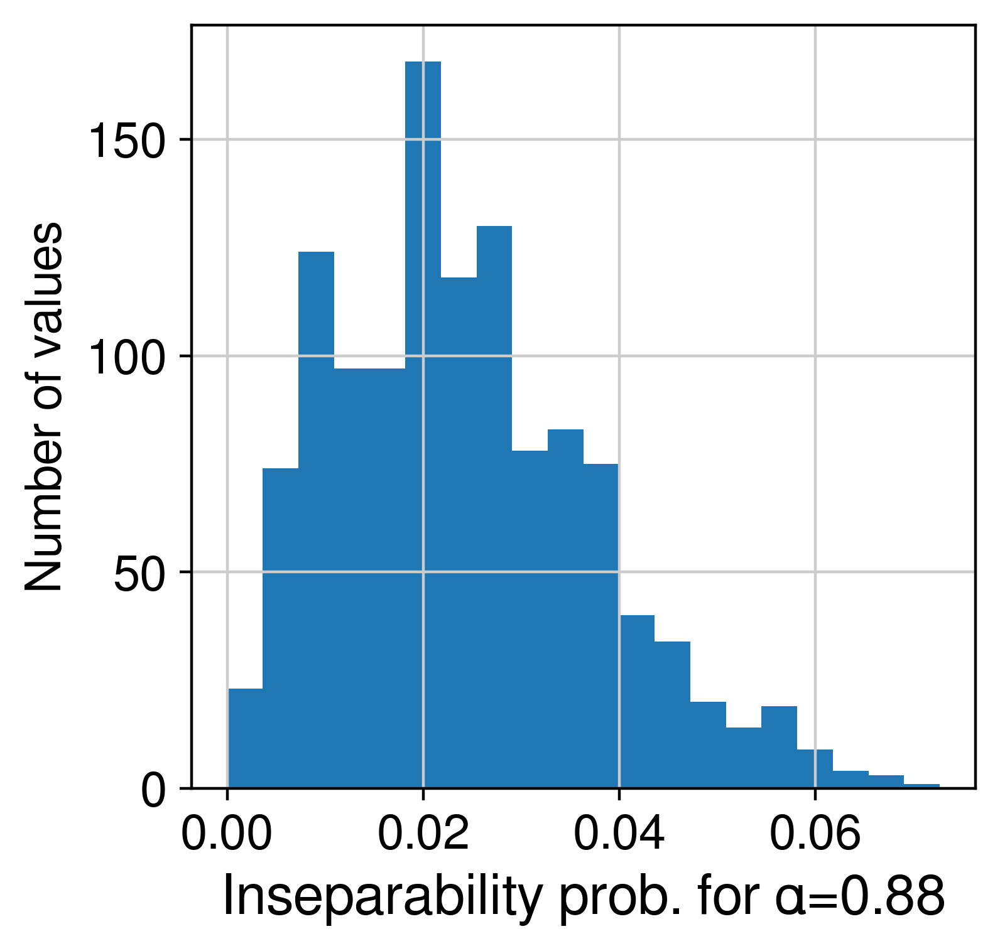

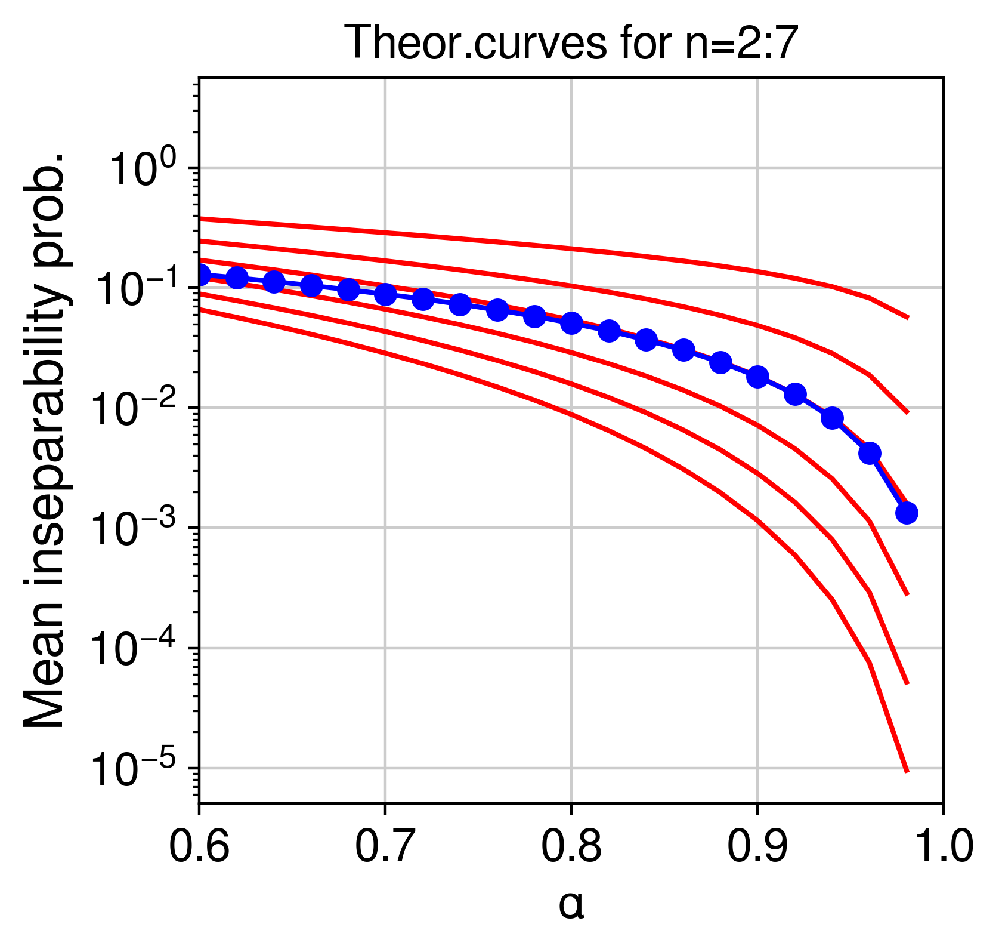

[2022-10-18 16:27:46] Computing 4 archetypes...
[2022-10-18 16:28:09] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:28:24] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:28:38] 0.6749 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:28:39] Computing intrinsic dimension to estimate k...


CID4465 # archetypes=18820
5 components are retained using conditional_number=10.00


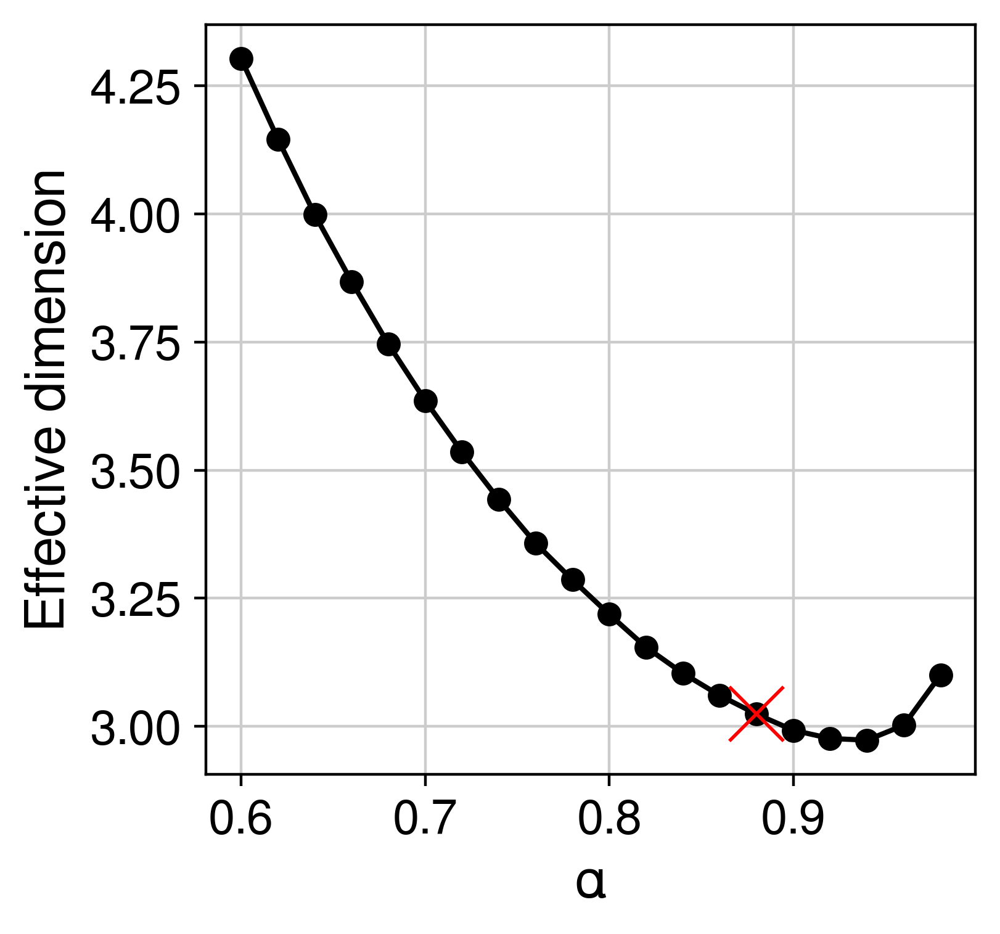

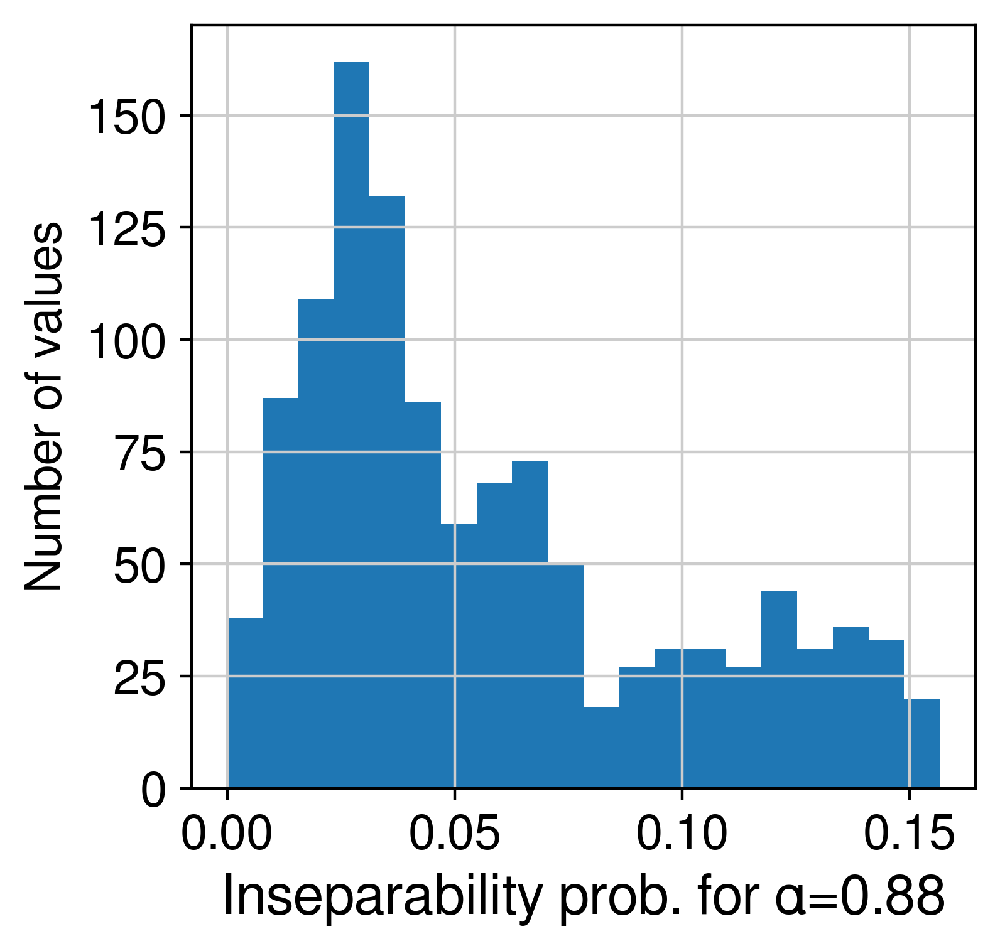

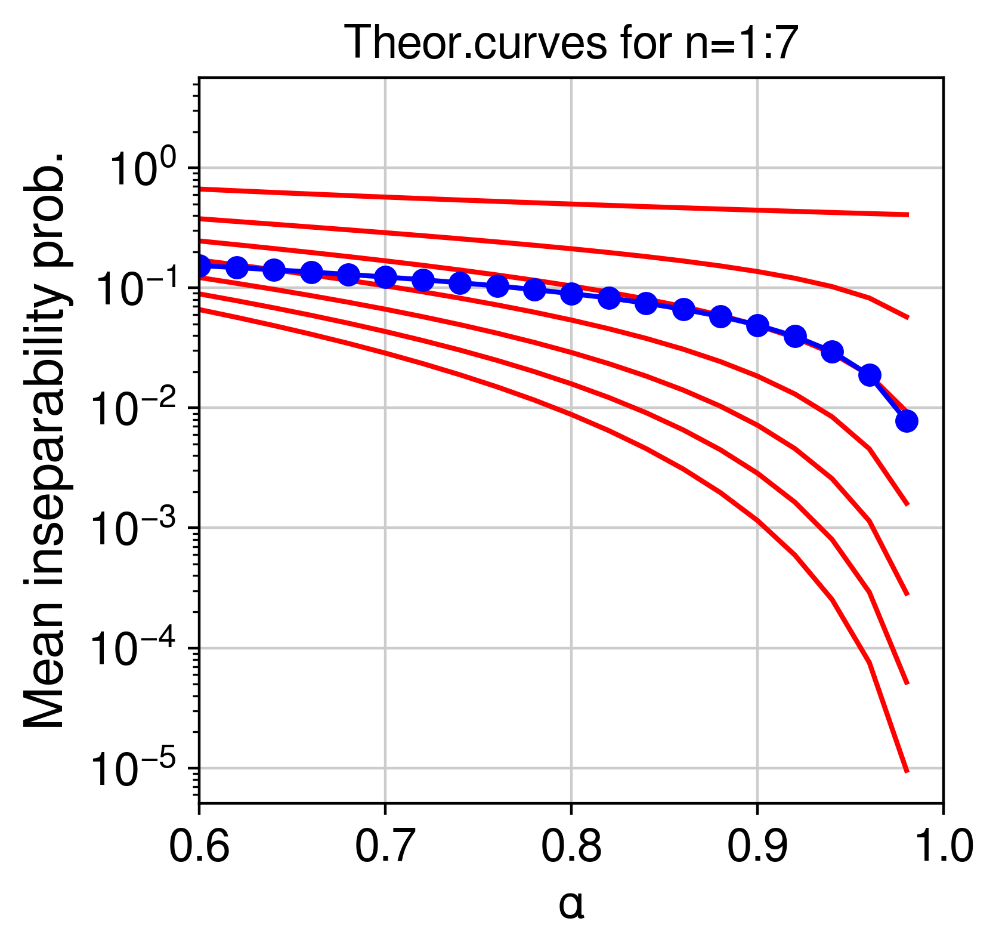

[2022-10-18 16:28:41] Computing 3 archetypes...
[2022-10-18 16:29:57] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:30:10] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:30:22] 0.6173 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:30:23] Computing intrinsic dimension to estimate k...


CID44971 # archetypes=18967
2 components are retained using conditional_number=10.00


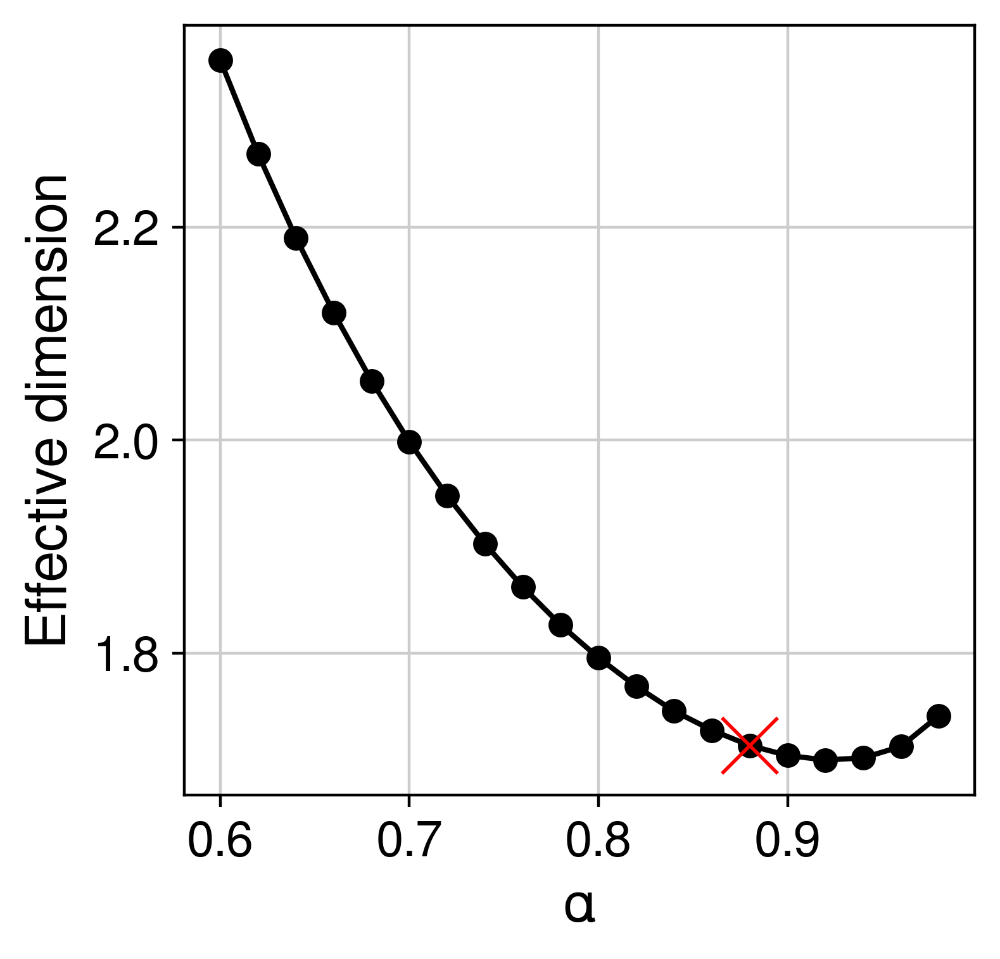

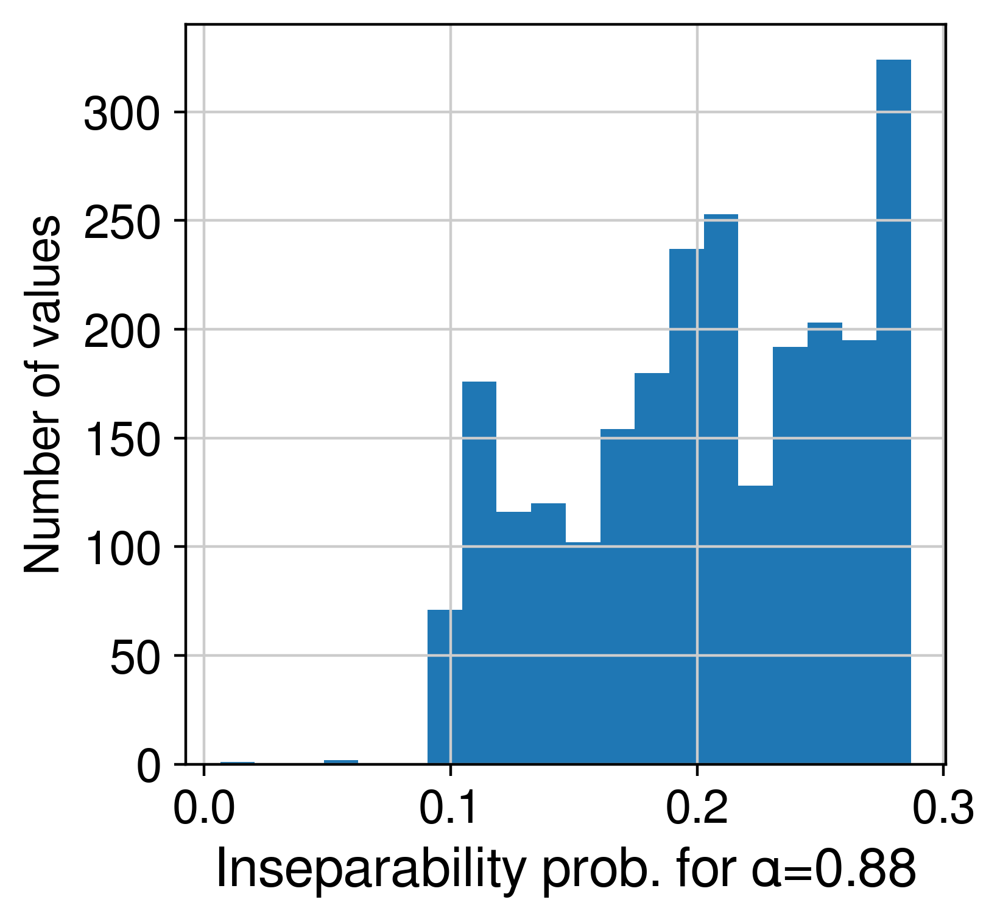

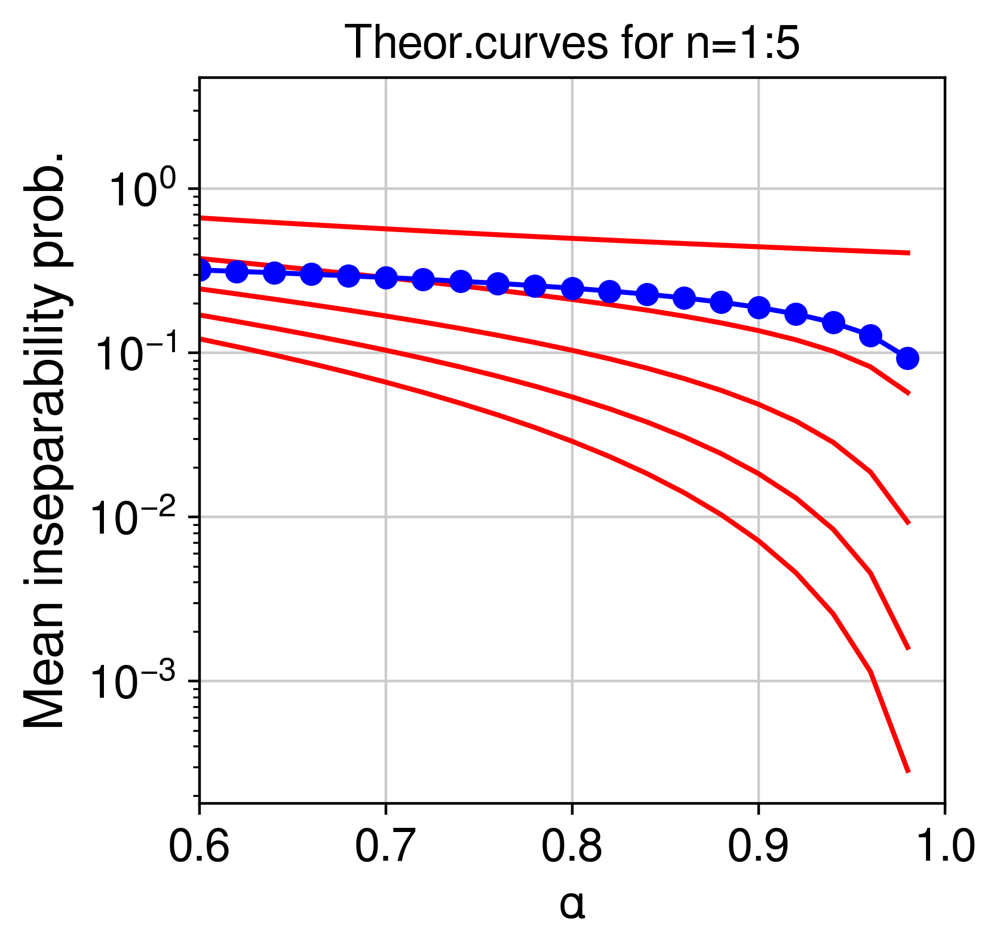

[2022-10-18 16:30:30] Computing 1 archetypes...
[2022-10-18 16:30:35] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:31:32] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:32:30] 0.5003 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:32:30] Computing intrinsic dimension to estimate k...


MBC_1A # archetypes=21280
2 components are retained using conditional_number=10.00


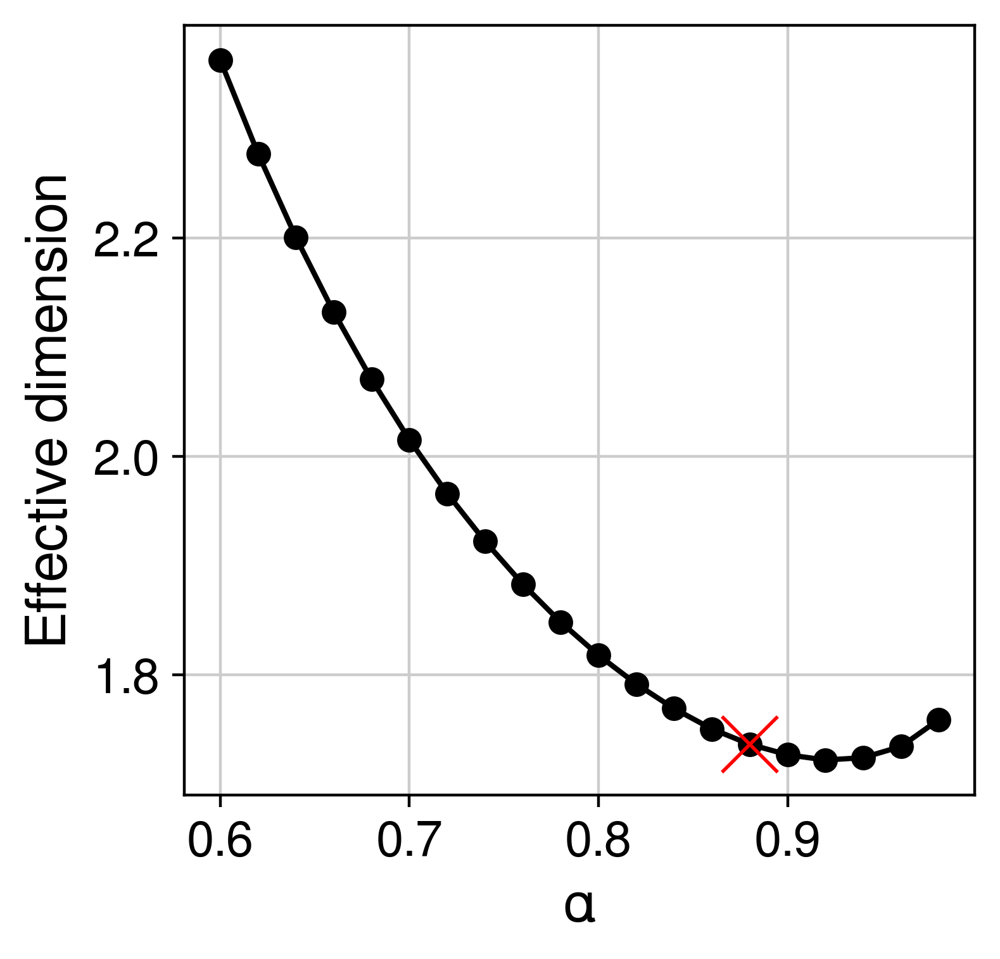

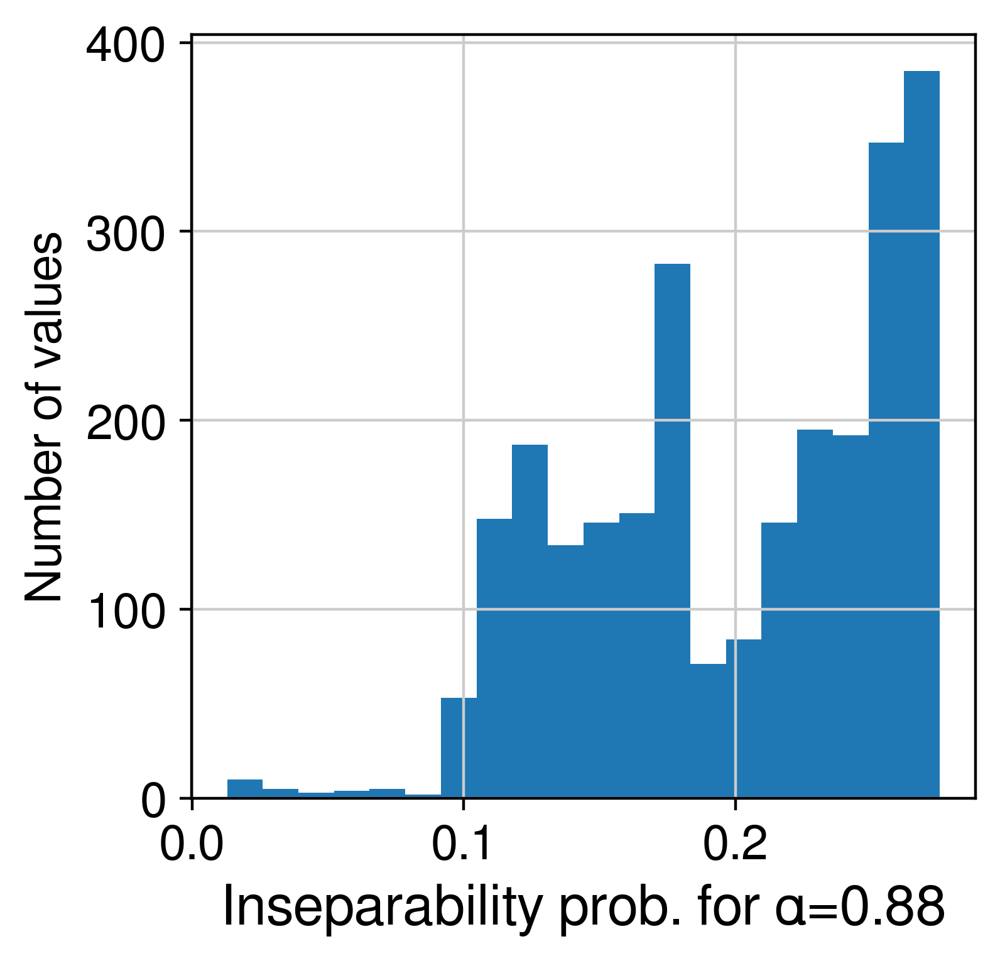

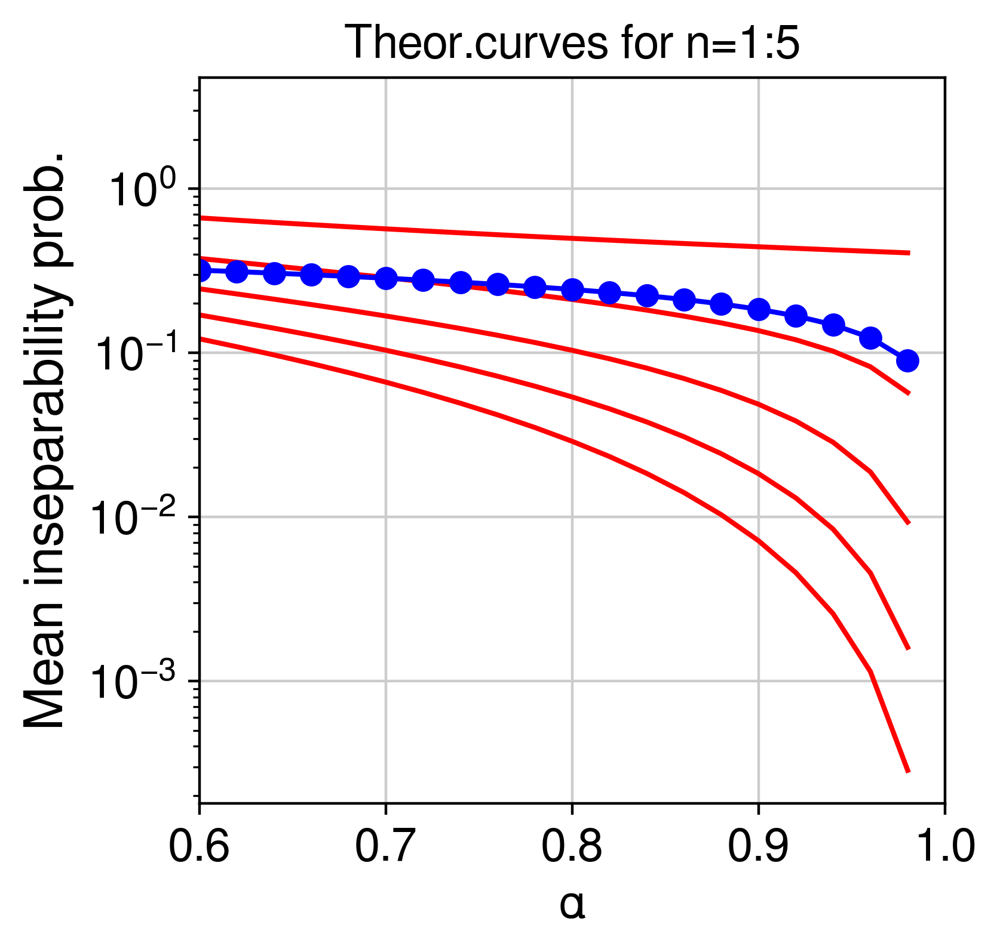

[2022-10-18 16:32:38] Computing 1 archetypes...
[2022-10-18 16:32:43] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:33:44] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:34:45] 0.51 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:34:46] Computing intrinsic dimension to estimate k...


MBC_1B # archetypes=21246
2 components are retained using conditional_number=10.00


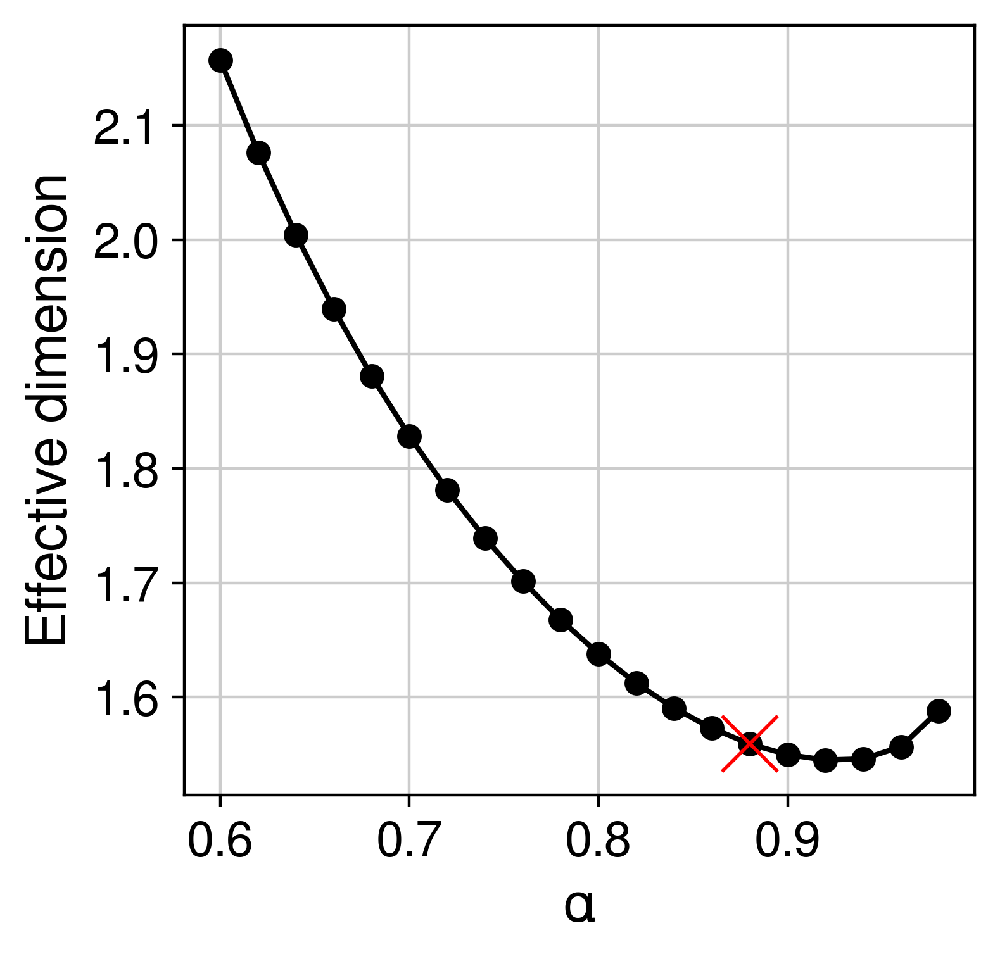

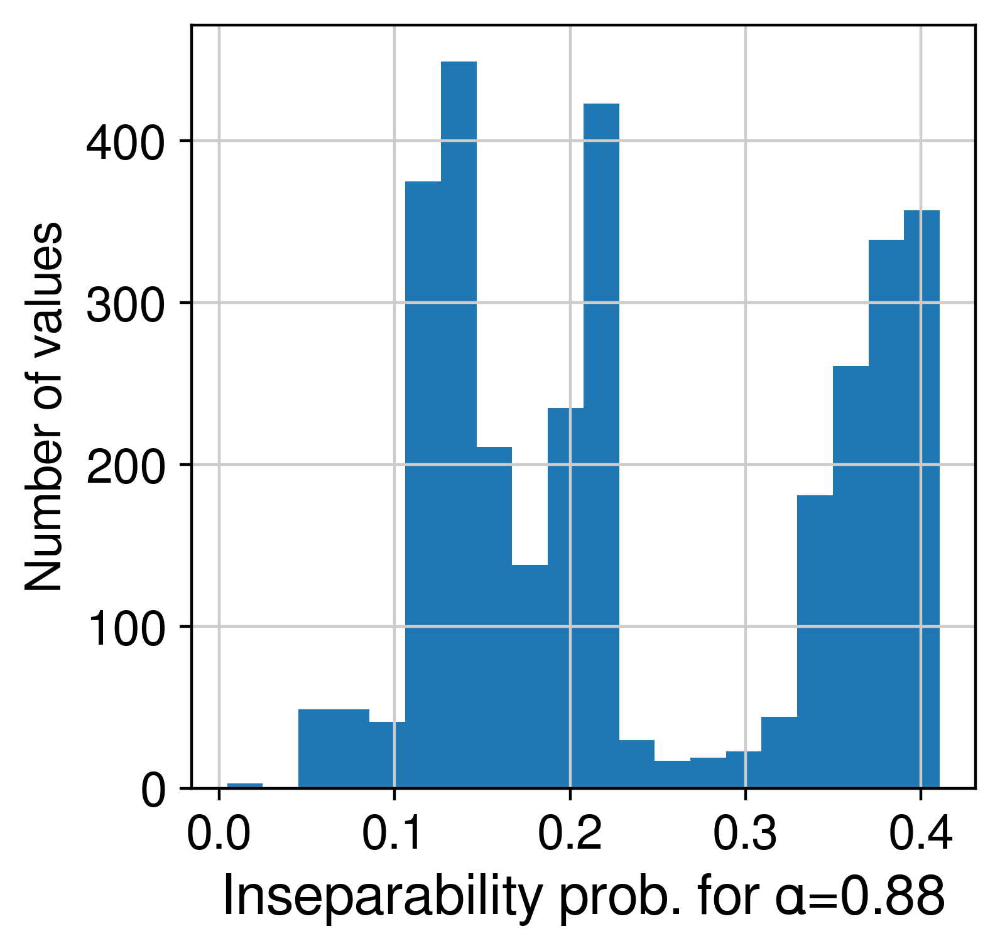

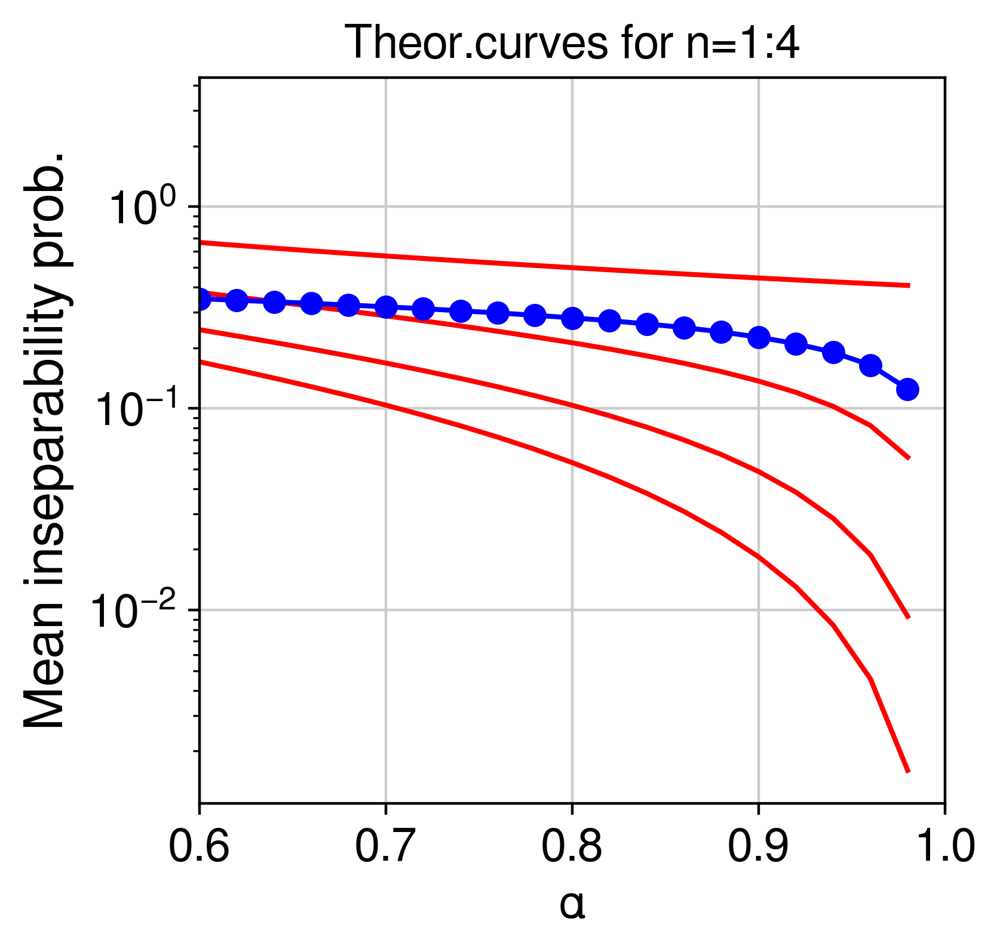

[2022-10-18 16:34:59] Computing 1 archetypes...
[2022-10-18 16:35:06] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:36:51] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:38:36] 0.6336 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:38:37] Computing intrinsic dimension to estimate k...


MBC_2A # archetypes=22839
2 components are retained using conditional_number=10.00


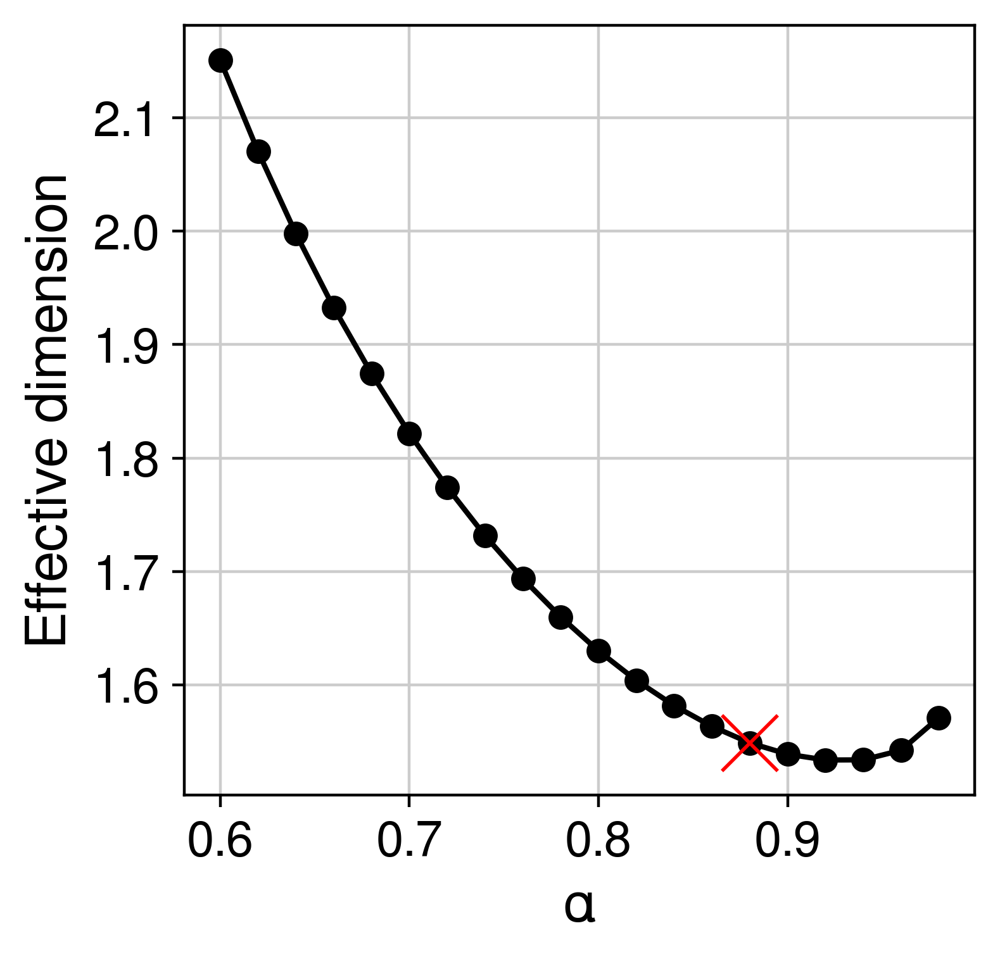

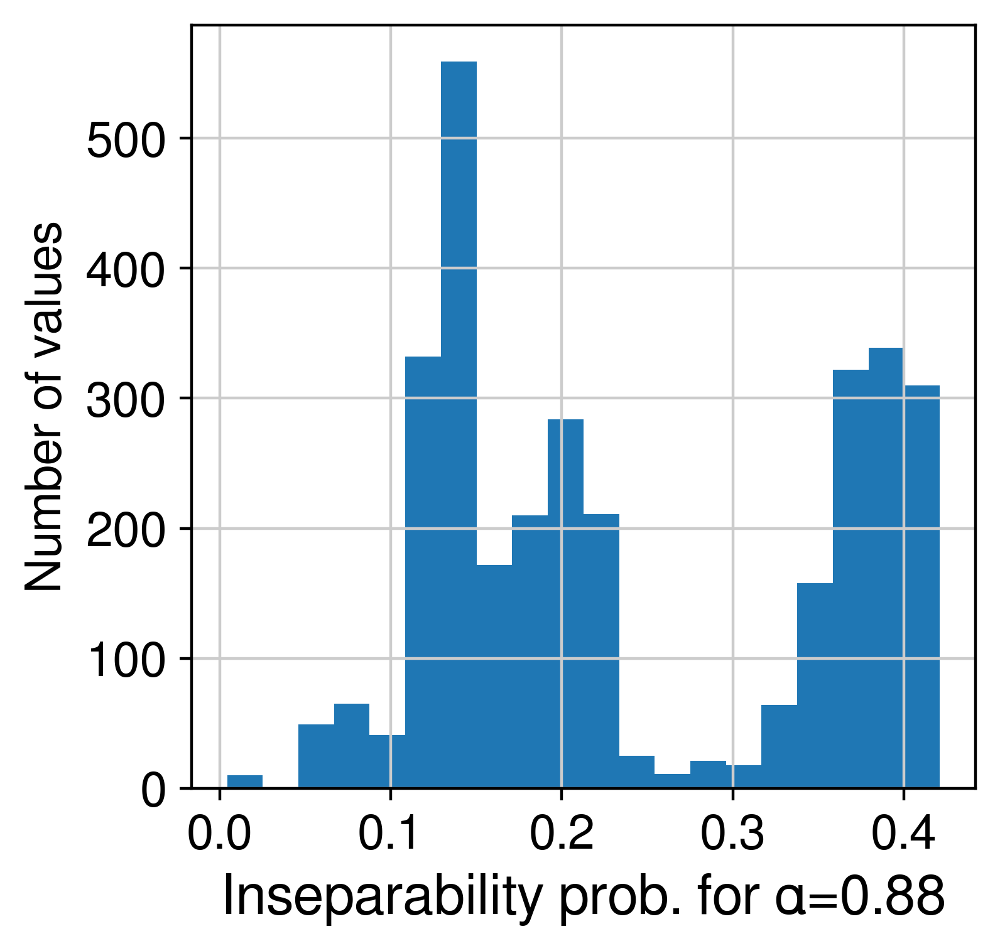

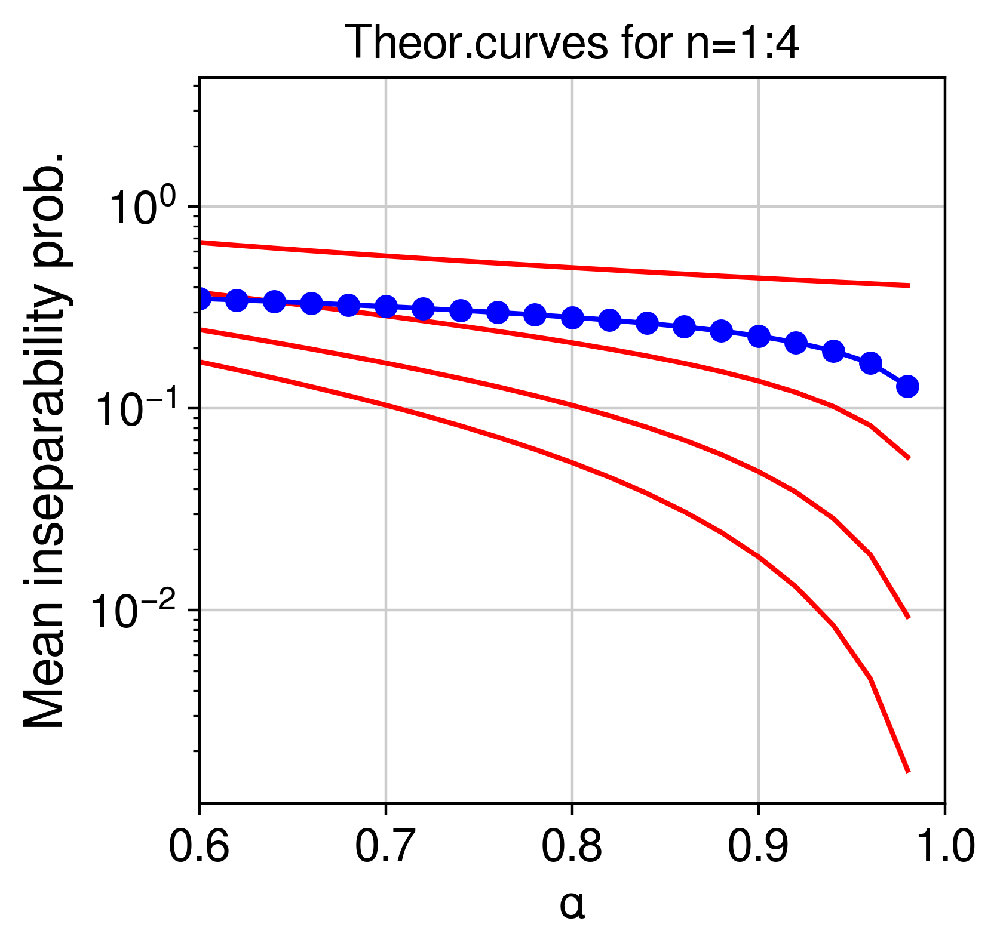

[2022-10-18 16:38:50] Computing 1 archetypes...
[2022-10-18 16:38:57] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:40:41] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:42:25] 0.5951 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:42:25] Computing intrinsic dimension to estimate k...


MBC_2B # archetypes=22750
177 components are retained using conditional_number=10.00


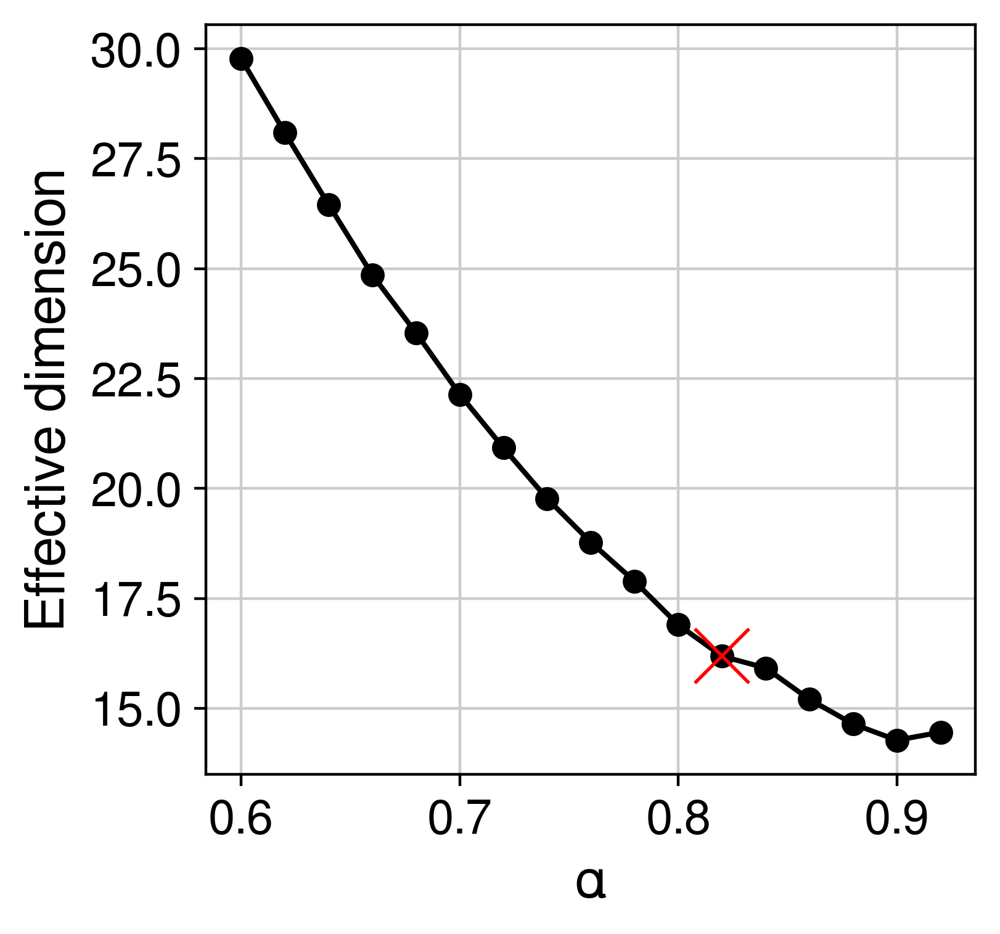

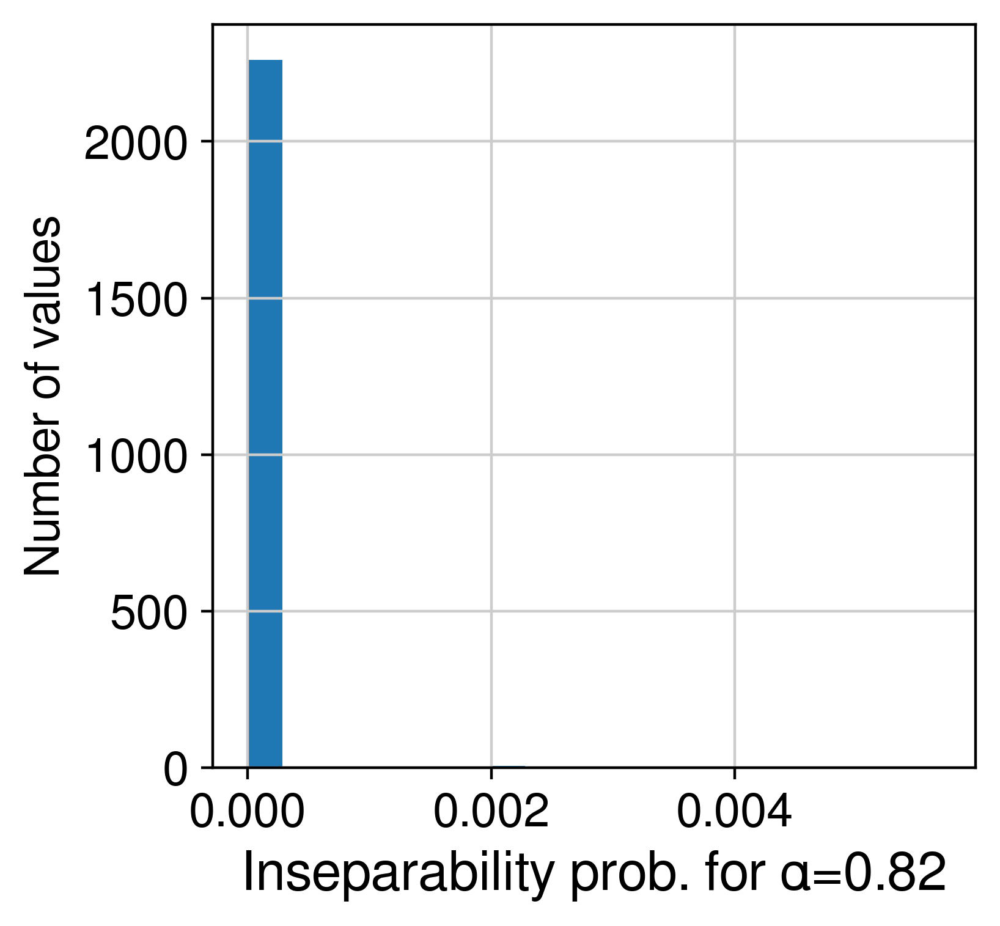

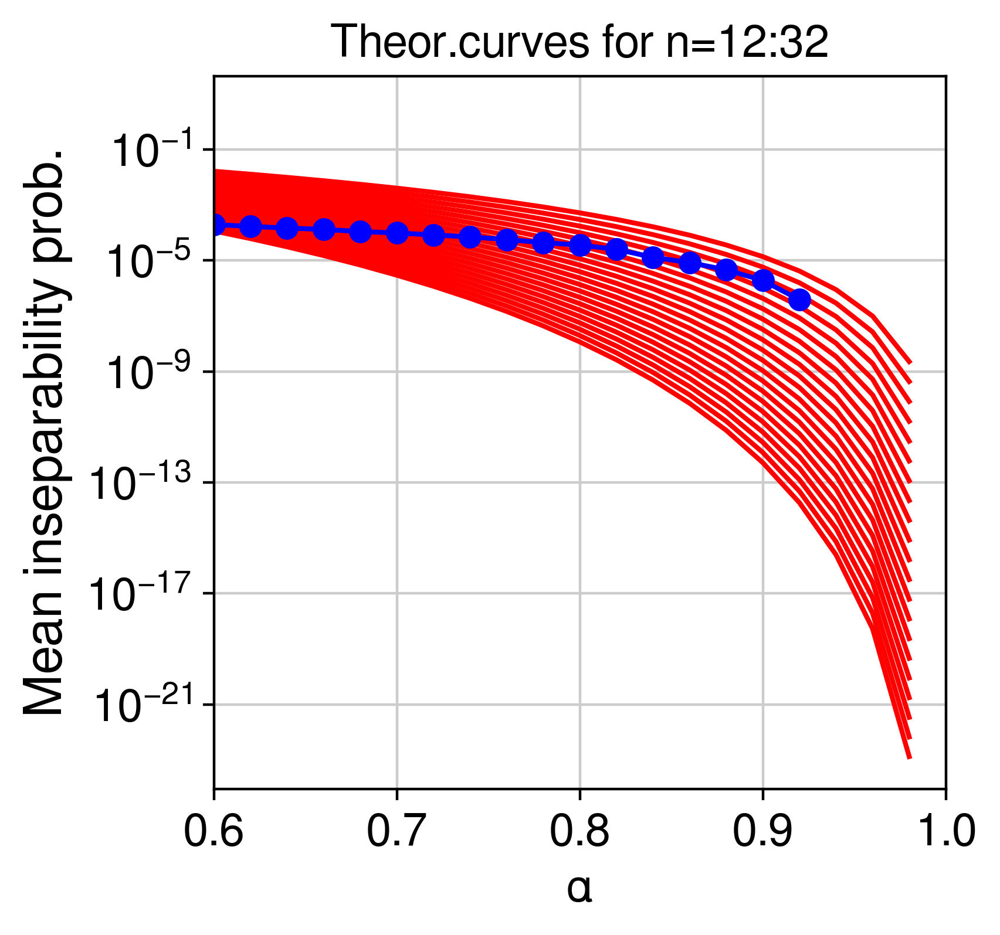

[2022-10-18 16:42:31] Computing 16 archetypes...
[2022-10-18 16:49:43] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:50:28] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:51:14] 0.3012 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:51:15] Computing intrinsic dimension to estimate k...


MBC_3A # archetypes=18585
249 components are retained using conditional_number=10.00


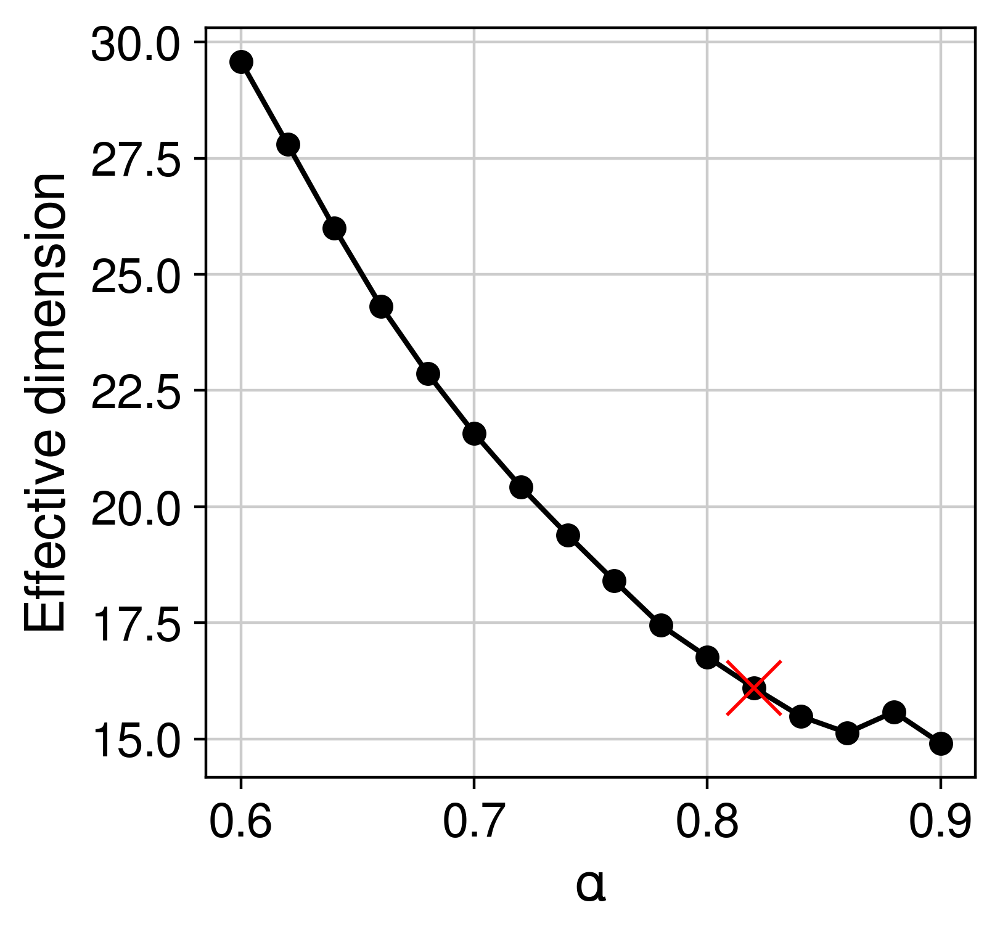

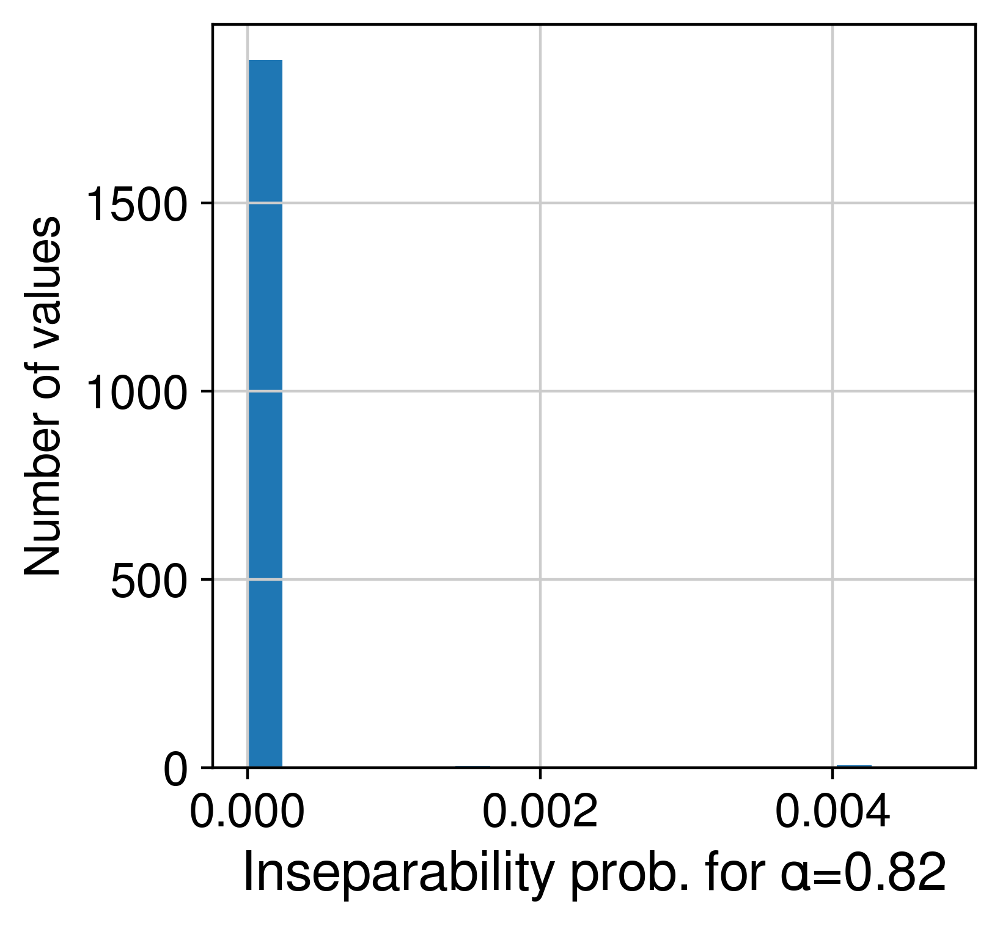

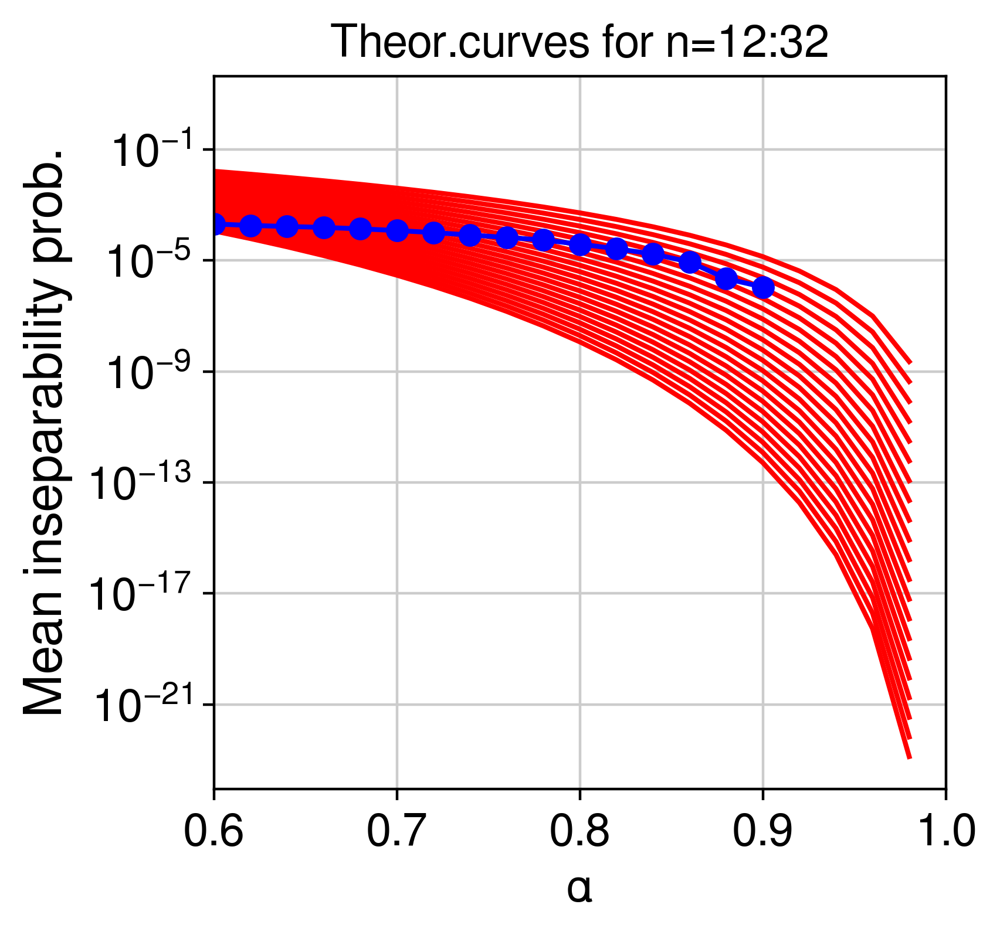

[2022-10-18 16:51:19] Computing 16 archetypes...
[2022-10-18 16:56:08] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:56:40] Calculating UMAPs for counts + Archetypes...
[2022-10-18 16:57:12] 0.2953 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 16:57:12] Computing intrinsic dimension to estimate k...


MBC_3B # archetypes=18276
13 components are retained using conditional_number=10.00


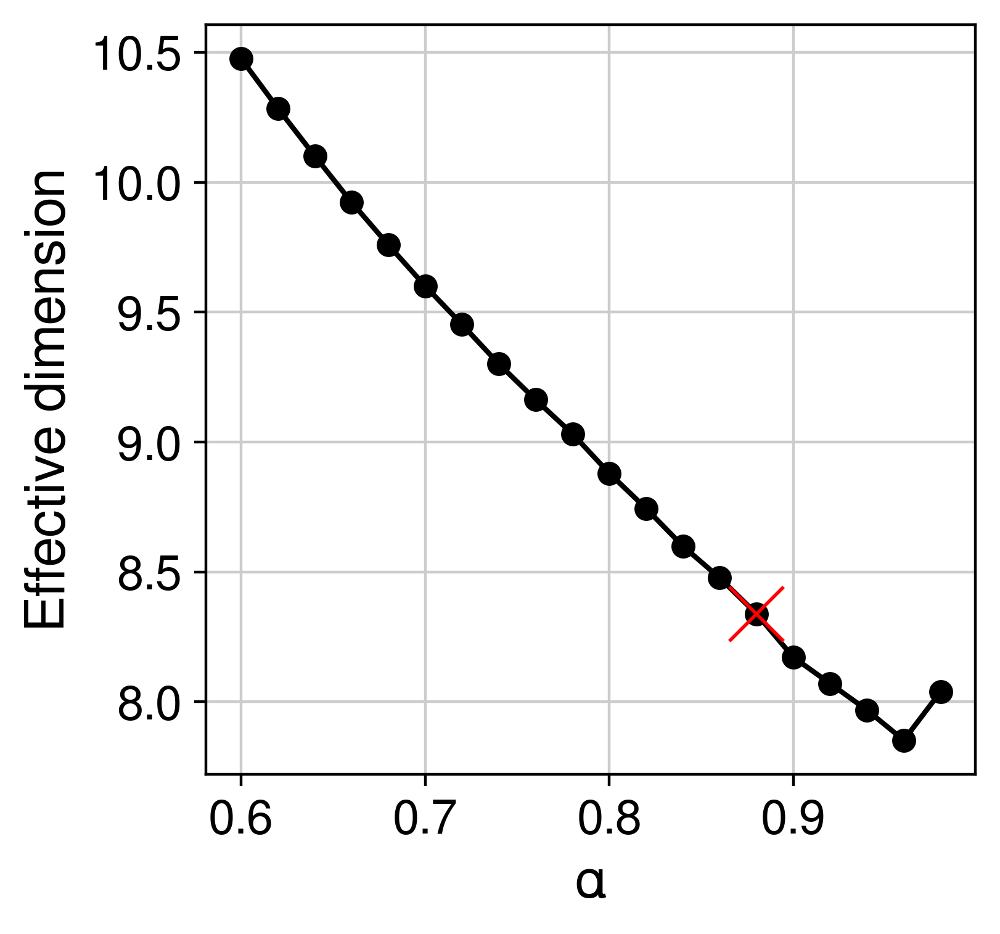

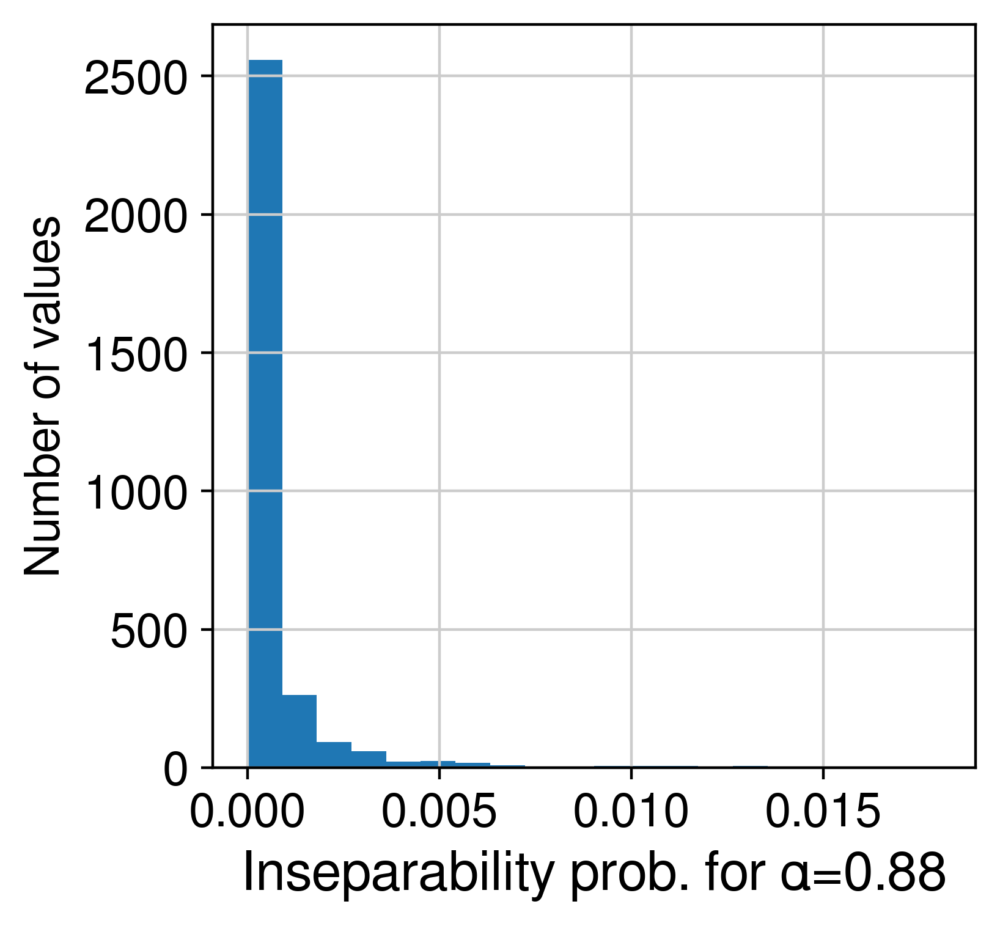

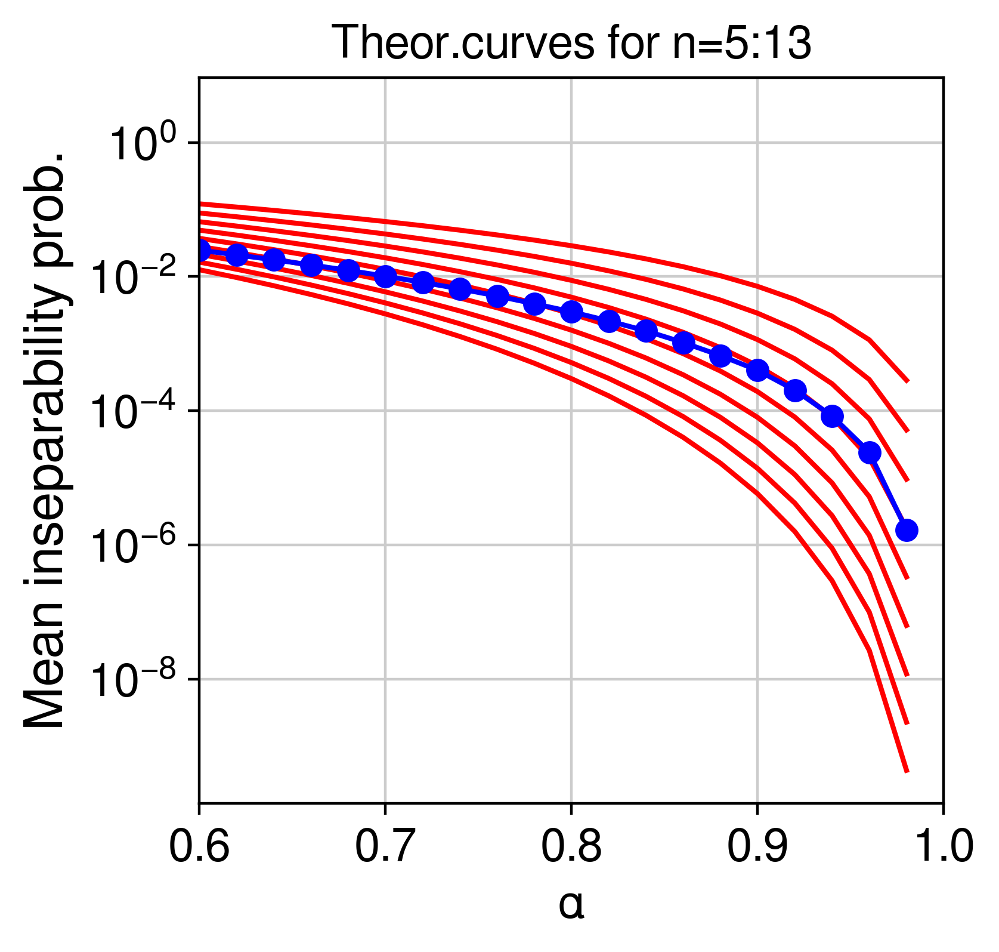

[2022-10-18 16:57:22] Computing 8 archetypes...
[2022-10-18 16:59:45] Calculating UMAPs for counts + Archetypes...
[2022-10-18 17:01:12] Calculating UMAPs for counts + Archetypes...
[2022-10-18 17:02:40] 0.3385 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes
[2022-10-18 17:02:41] Computing intrinsic dimension to estimate k...


MBC_4A # archetypes=20575
30 components are retained using conditional_number=10.00


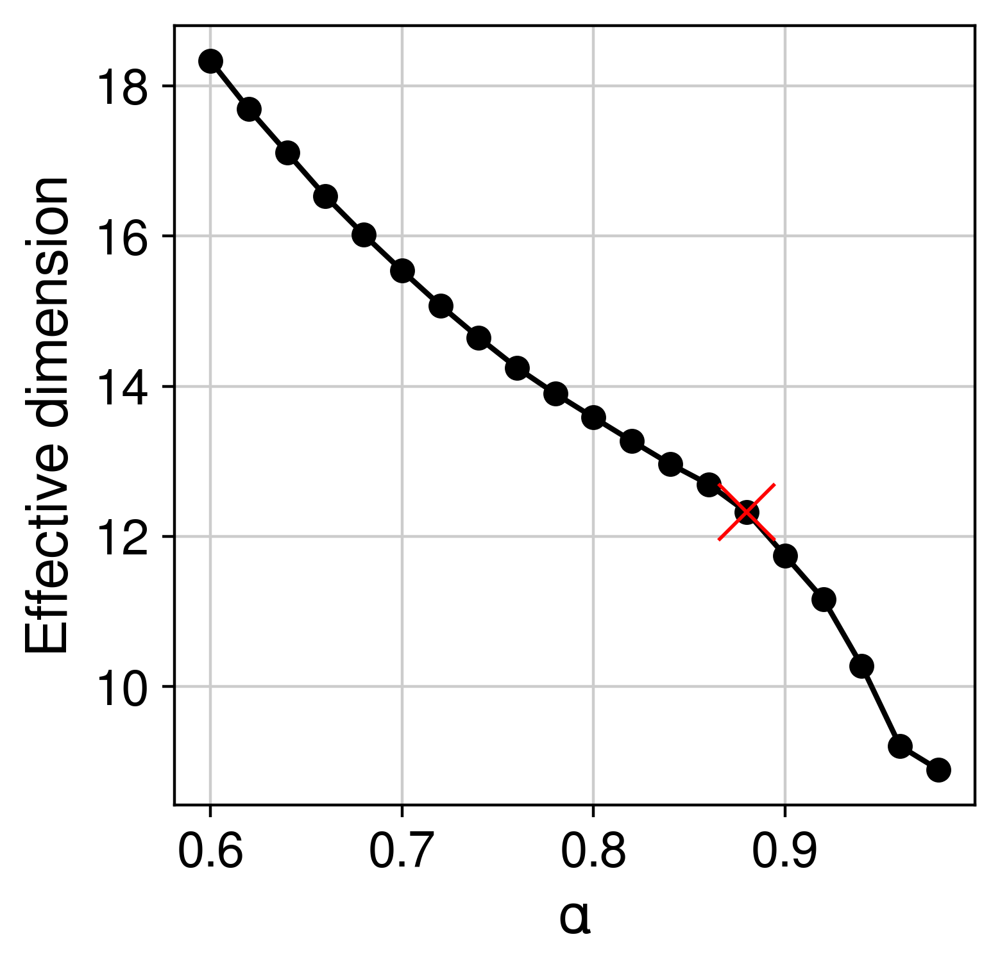

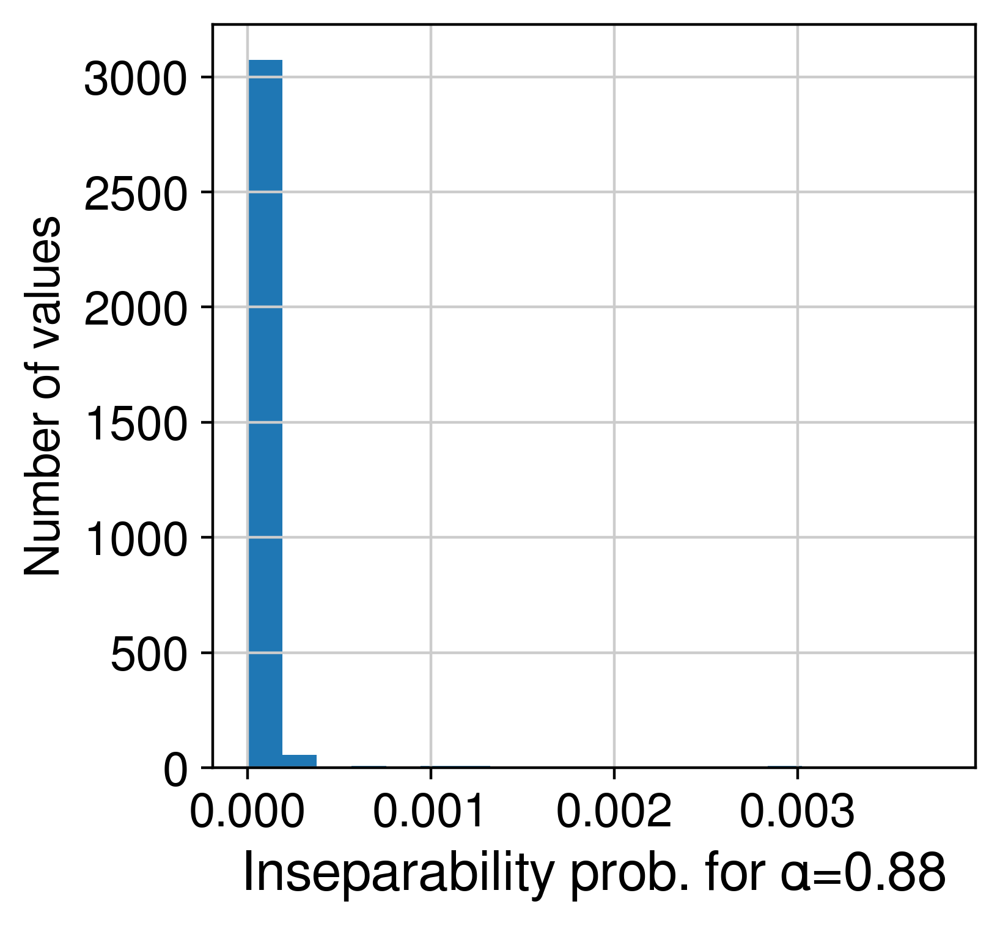

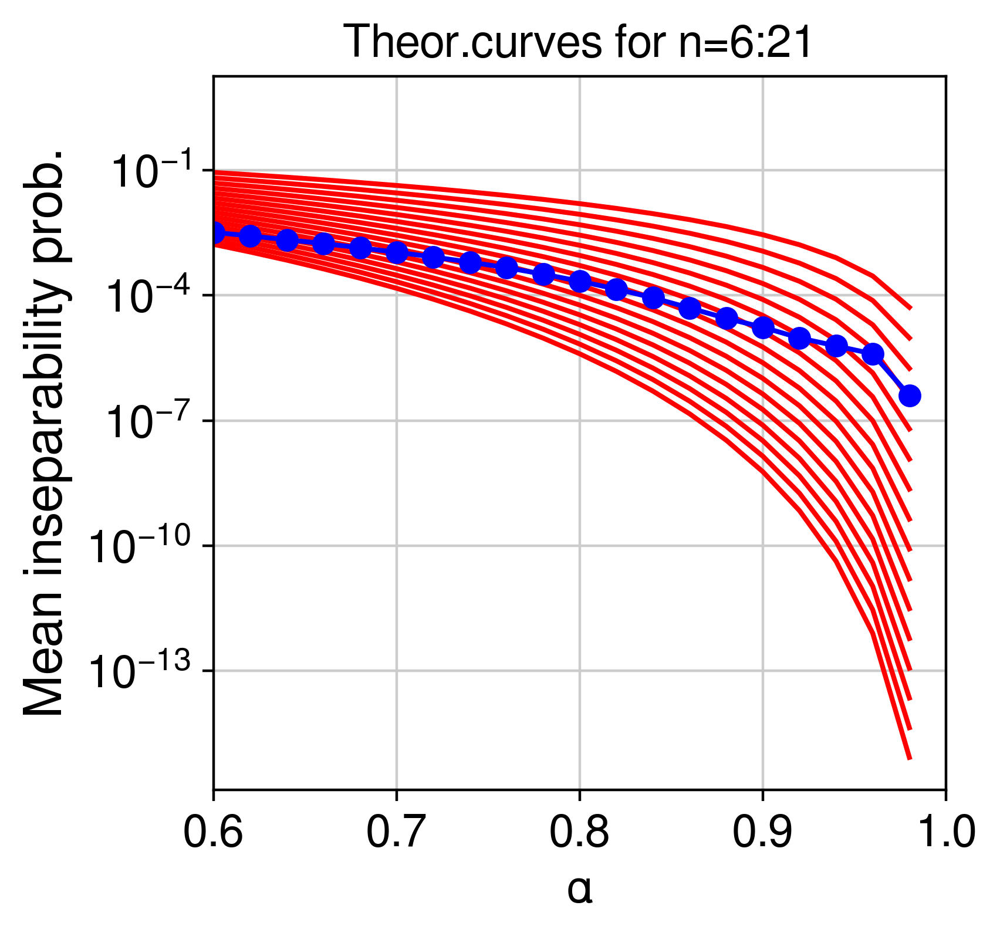

[2022-10-18 17:02:51] Computing 12 archetypes...
[2022-10-18 17:12:08] Calculating UMAPs for counts + Archetypes...
[2022-10-18 17:13:38] Calculating UMAPs for counts + Archetypes...
[2022-10-18 17:15:07] 0.24 variance explained by raw archetypes.
Merging those within 30 NNs to get major archetypes


MBC_4B # archetypes=20031


In [62]:
for n_pcs, sample_id in zip(n_pc_list, sample_ids):
    adata_norm = adatas[sample_id]
    aa_model = ArchetypalAnalysis(adata_orig=adata_norm)
    archetype, _, _ = aa_model.compute_archetypes(cn=10, display=True)
    print(sample_id, '# archetypes={}'.format(len(archetype)))

---